In [12]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn.linear_model import LinearRegression
from sklearn.cluster import KMeans
from mpl_point_clicker import clicker


In [32]:
# Cargar los datos de los brazos espirales adicionales
arm1_data = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
arm2_data = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv')
data = pd.read_csv('../DATA/processed/TracingPoints/data_rho_11_filtered.csv')

# Calcular las coordenadas polares r y theta para cada conjunto de datos
data['r'] = np.sqrt(data['x']**2 + data['y']**2)
data['theta1'] = (180 * np.arctan2(data['y'], data['x']) / np.pi) - 360
data['theta2'] = (180 * np.arctan2(data['y'], data['x']) / np.pi)

arm1_data['r'] = np.sqrt(arm1_data['x']**2 + arm1_data['y']**2)
arm1_data['theta'] = (180 * np.arctan2(arm1_data['y'], arm1_data['x']) / np.pi) - 360

arm2_data['r'] = np.sqrt(arm2_data['x']**2 + arm2_data['y']**2)
arm2_data['theta'] = (180 * np.arctan2(arm2_data['y'], arm2_data['x']) / np.pi) - 360



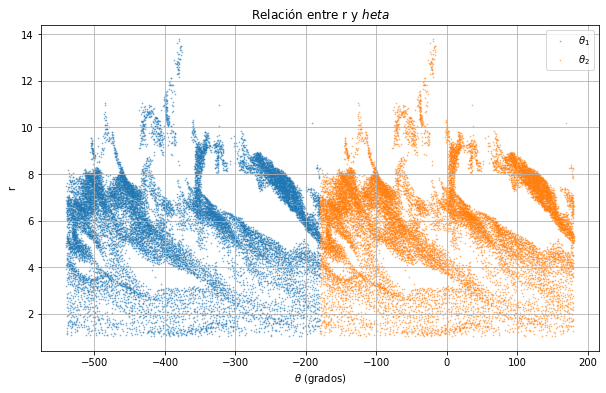

In [14]:
# Calcular las coordenadas polares r y theta
data['r'] = np.sqrt(data['x']**2 + data['y']**2)

# Calcular las variaciones de theta
data['theta1'] = (180 * np.arctan2(data['y'], data['x']) / np.pi) - 360
data['theta2'] = (180 * np.arctan2(data['y'], data['x']) / np.pi)


# Calcular las coordenadas polares r y theta
data['r'] = np.sqrt(data['x']**2 + data['y']**2)

# Calcular las variaciones de theta
data['theta1'] = (180 * np.arctan2(data['y'], data['x']) / np.pi) - 360
data['theta2'] = (180 * np.arctan2(data['y'], data['x']) / np.pi)

# Graficar theta1 y theta2 en la misma gráfica
plt.figure(figsize=(10, 6))

# Graficar theta1
plt.scatter(data['theta1'], data['r'], alpha=0.5, s=0.50, label=r'$\theta_1$')
# Graficar theta2
plt.scatter(data['theta2'], data['r'], alpha=0.5, s=0.50, label=r'$\theta_2$')

# Configurar la gráfica
plt.title('Relación entre r y $\theta$')
plt.xlabel(r'$\theta$ (grados)')
plt.ylabel('r')
plt.legend()
plt.grid(True)

# Mostrar la gráfica
plt.show()

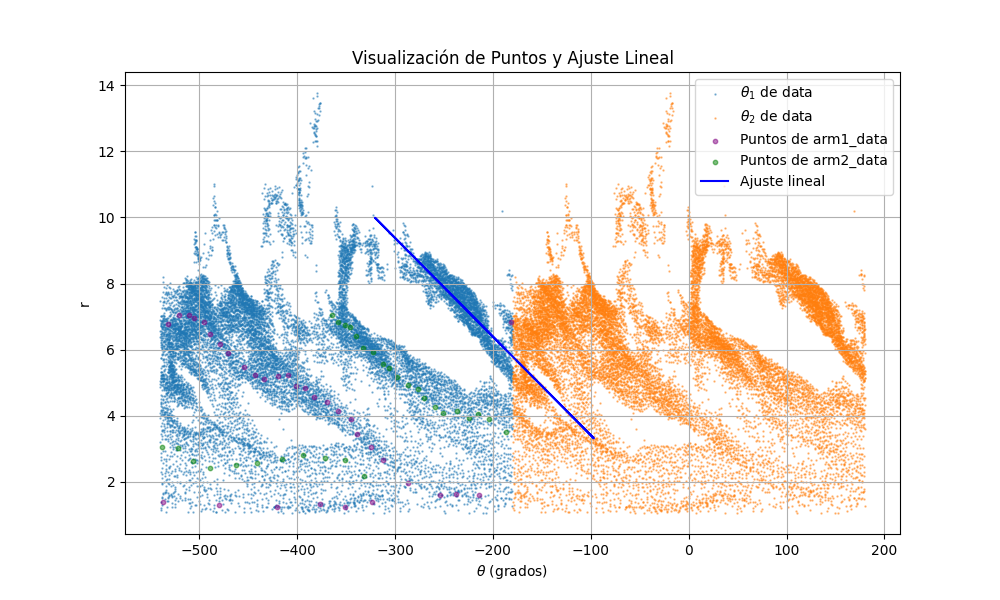

In [34]:
# Visualizar los puntos de fondo y los puntos seleccionados para el ajuste
fig, ax = plt.subplots(figsize=(10, 6))

# Graficar todos los puntos de data
ax.scatter(data['theta1'], data['r'], alpha=0.5, s=0.5, label=r'$\theta_1$ de data')
ax.scatter(data['theta2'], data['r'], alpha=0.5, s=0.5, label=r'$\theta_2$ de data')

# Graficar arm1_data y arm2_data como puntos de fondo
ax.scatter(arm1_data['theta'], arm1_data['r'], color='purple', alpha=0.5, s=10, label='Puntos de arm1_data')
ax.scatter(arm2_data['theta'], arm2_data['r'], color='green', alpha=0.5, s=10, label='Puntos de arm2_data')

# Graficar los puntos seleccionados para el ajuste
if "limits" in dict_lims and len(dict_lims["limits"]) >= 3:
    polygon_path = Path(dict_lims["limits"])
    inside_points = []
    original_coords_theta1 = []
    original_coords_theta2 = []
    
    for i in range(len(data_combined)):
        point = (data_combined['theta'].iloc[i], data_combined['r'].iloc[i])
        if polygon_path.contains_point(point):
            inside_points.append(point)
            if i < len(data):  # Primeros valores corresponden a theta1
                original_coords_theta1.append((data['x'].iloc[i], data['y'].iloc[i]))
            else:  # Segunda mitad corresponde a theta2
                index = i - len(data)
                original_coords_theta2.append((data['x'].iloc[index], data['y'].iloc[index]))

    selected_data = pd.DataFrame(inside_points, columns=['theta', 'r'])

    # Realizar el ajuste lineal
    if len(selected_data) > 1:
        X_selected = selected_data[['theta']].values
        y_selected = selected_data['r'].values

        model = LinearRegression()
        model.fit(X_selected, y_selected)
        slope = model.coef_[0]
        intercept = model.intercept_
        y_pred = model.predict(X_selected)

        # Graficar puntos seleccionados y ajuste lineal
        #ax.scatter(selected_data['theta'], selected_data['r'], color='red', s=10, label='Puntos seleccionados')
        ax.plot(selected_data['theta'], y_pred, color='blue', label='Ajuste lineal')

ax.set_title('Visualización de Puntos y Ajuste Lineal')
ax.set_xlabel(r'$\theta$ (grados)')
ax.set_ylabel('r')
ax.legend()
plt.grid(True)
plt.show()


In [15]:
# Crear nuevos DataFrames para theta1 y theta2 con sus respectivos valores de r
data_theta1 = pd.DataFrame({'theta': data['theta1'], 'r': data['r']})
data_theta2 = pd.DataFrame({'theta': data['theta2'], 'r': data['r']})


# Concatenar ambos DataFrames
data_combined = pd.concat([data_theta1, data_theta2], ignore_index=True)

data_combined.head(2)

,theta,r
0,-249.374835,1.061656
1,-249.850758,1.114999


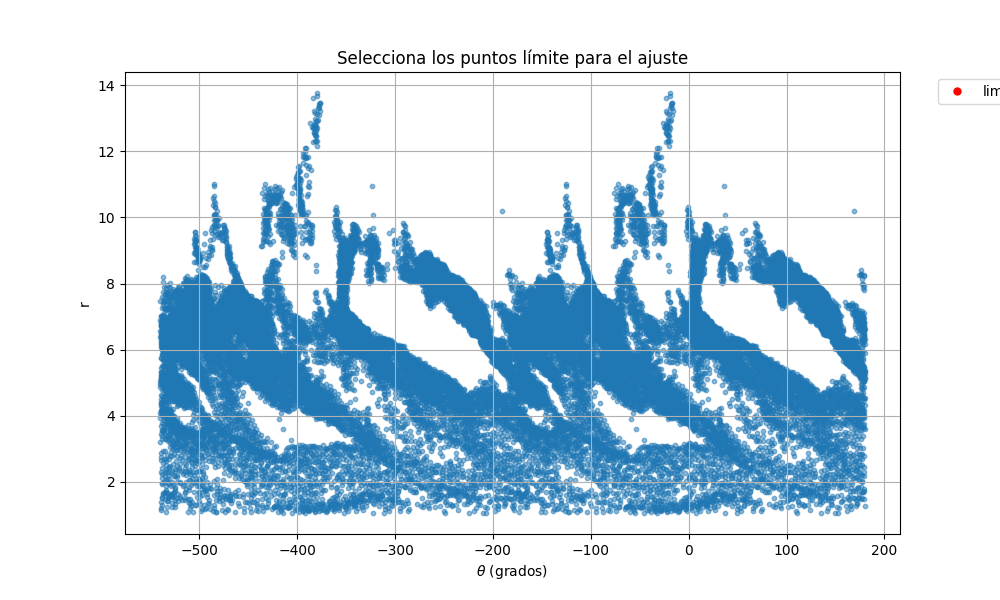

In [17]:
%matplotlib widget

# Visualizar los puntos y permitir la selección manual
fig, ax = plt.subplots(figsize=(10, 6))
scatter = ax.scatter(data_combined['theta'], data_combined['r'], s=10, alpha=0.5)
ax.set_title("Selecciona los puntos límite para el ajuste")
ax.set_xlabel(r'$\theta$ (grados)')
ax.set_ylabel('r')
plt.grid(True)

# Usar mpl_point_clicker para seleccionar los límites
klicker = clicker(ax, ["limits"], markers=["o"], colors=['red'], markersize=5)

plt.show()

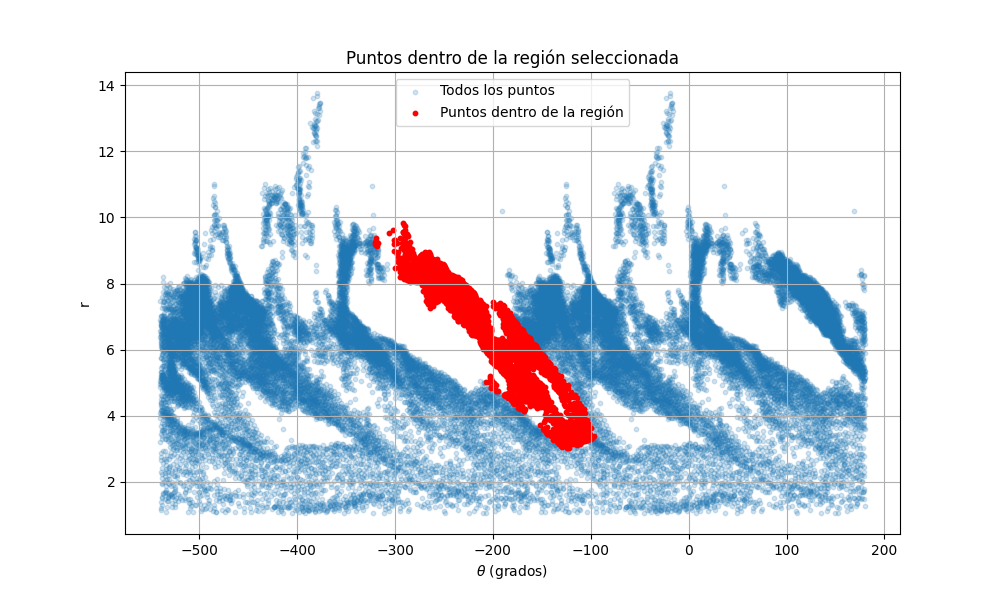

In [21]:
from matplotlib.path import Path

# Obtener los límites seleccionados
dict_lims = klicker.get_positions()

# Revisar si se seleccionaron al menos tres puntos para formar una región cerrada
if "limits" in dict_lims and len(dict_lims["limits"]) >= 3:
    # Crear un Path (camino) a partir de los puntos seleccionados
    polygon_path = Path(dict_lims["limits"])
    
    # Filtrar los puntos que están dentro del polígono seleccionado
    inside_points = []
    for i in range(len(data_combined)):
        point = (data_combined['theta'].iloc[i], data_combined['r'].iloc[i])
        if polygon_path.contains_point(point):
            inside_points.append(point)

    # Convertir los puntos seleccionados a DataFrame
    selected_data = pd.DataFrame(inside_points, columns=['theta', 'r'])

    # Graficar los puntos dentro de la región seleccionada
    plt.figure(figsize=(10, 6))
    plt.scatter(data_combined['theta'], data_combined['r'], s=10, alpha=0.2, label='Todos los puntos')
    plt.scatter(selected_data['theta'], selected_data['r'], color='red', s=10, label='Puntos dentro de la región')
    plt.title("Puntos dentro de la región seleccionada")
    plt.xlabel(r'$\theta$ (grados)')
    plt.ylabel('r')
    plt.legend()
    plt.grid(True)
    plt.show()
else:
    print("Selecciona al menos tres puntos para definir una región cerrada.")

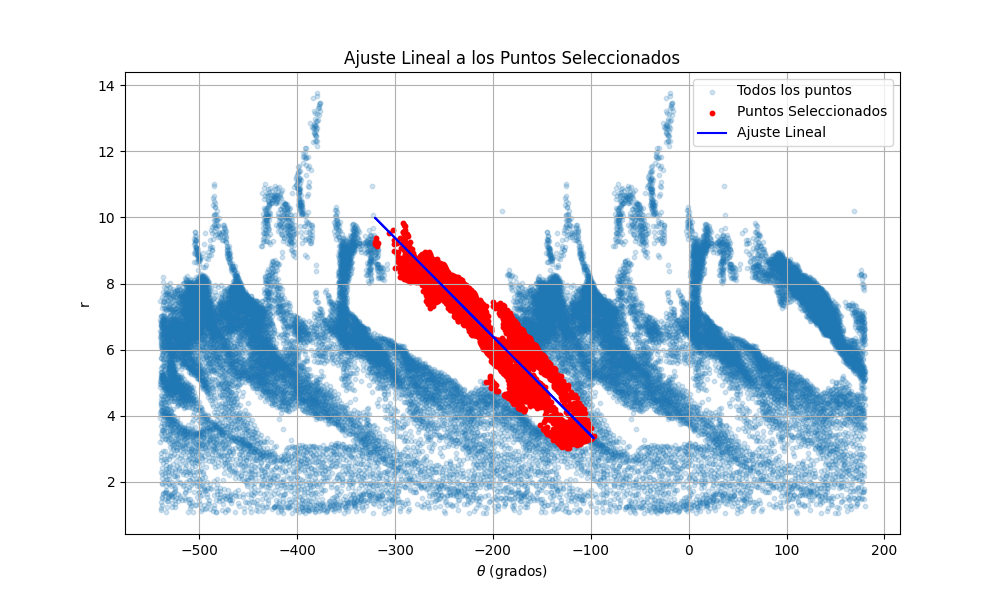

Ecuación de la recta ajustada: r = -0.0299 * θ + 0.4181


In [26]:
# Obtener los límites seleccionados
dict_lims = klicker.get_positions()

# Revisar si se seleccionaron al menos tres puntos para formar una región cerrada
if "limits" in dict_lims and len(dict_lims["limits"]) >= 3:
    # Crear un Path (camino) a partir de los puntos seleccionados
    polygon_path = Path(dict_lims["limits"])
    
    # Filtrar los puntos que están dentro del polígono seleccionado
    inside_points = []
    original_coords = []  # Lista para almacenar las coordenadas originales seleccionadas
    for i in range(len(data_combined)):
        point = (data_combined['theta'].iloc[i], data_combined['r'].iloc[i])
        if polygon_path.contains_point(point):
            inside_points.append(point)
            # Guardar las coordenadas originales en `x` e `y` para la gráfica polar
            original_coords.append((data['x'].iloc[i % len(data)], data['y'].iloc[i % len(data)]))

    # Convertir los puntos seleccionados a DataFrame
    selected_data = pd.DataFrame(inside_points, columns=['theta', 'r'])

    # Realizar ajuste lineal
    if len(selected_data) > 1:
        X_selected = selected_data[['theta']].values
        y_selected = selected_data['r'].values

        # Ajuste lineal
        model = LinearRegression()
        model.fit(X_selected, y_selected)
        slope = model.coef_[0]
        intercept = model.intercept_
        y_pred = model.predict(X_selected)

        # Graficar los puntos seleccionados, la línea ajustada y el fondo
        plt.figure(figsize=(10, 6))
        plt.scatter(data_combined['theta'], data_combined['r'], s=10, alpha=0.2, label='Todos los puntos')
        plt.scatter(selected_data['theta'], selected_data['r'], color='red', s=10, label='Puntos Seleccionados')
        plt.plot(selected_data['theta'], y_pred, color='blue', label='Ajuste Lineal')
        plt.title("Ajuste Lineal a los Puntos Seleccionados")
        plt.xlabel(r'$\theta$ (grados)')
        plt.ylabel('r')
        plt.legend()
        plt.grid(True)
        plt.show()

        # Mostrar la ecuación de la recta
        print(f"Ecuación de la recta ajustada: r = {slope:.4f} * θ + {intercept:.4f}")
    else:
        print("Selecciona más puntos para realizar el ajuste.")
else:
    print("Selecciona al menos tres puntos para definir una región cerrada.")



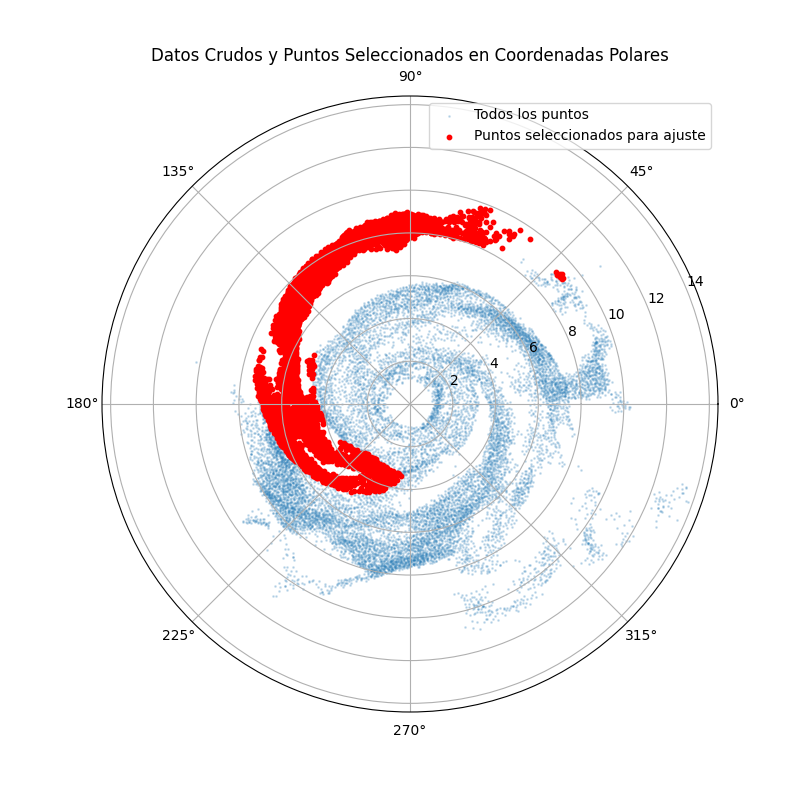

In [28]:
# Extraer las coordenadas originales x e y de los puntos seleccionados
selected_x = [coord[0] for coord in original_coords]
selected_y = [coord[1] for coord in original_coords]

# Configurar la gráfica en coordenadas polares
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(8, 8))

# Graficar todos los puntos en coordenadas polares
theta_all = np.arctan2(data['y'], data['x'])
r_all = np.sqrt(data['x']**2 + data['y']**2)
ax.scatter(theta_all, r_all, s=1, alpha=0.2, label="Todos los puntos")

# Graficar solo los puntos seleccionados en rojo
theta_selected = np.arctan2(selected_y, selected_x)
r_selected = np.sqrt(np.array(selected_x)**2 + np.array(selected_y)**2)
ax.scatter(theta_selected, r_selected, color='red', s=10, label="Puntos seleccionados para ajuste")

# Configuración de la gráfica
ax.set_title("Datos Crudos y Puntos Seleccionados en Coordenadas Polares")
ax.legend()
plt.show()


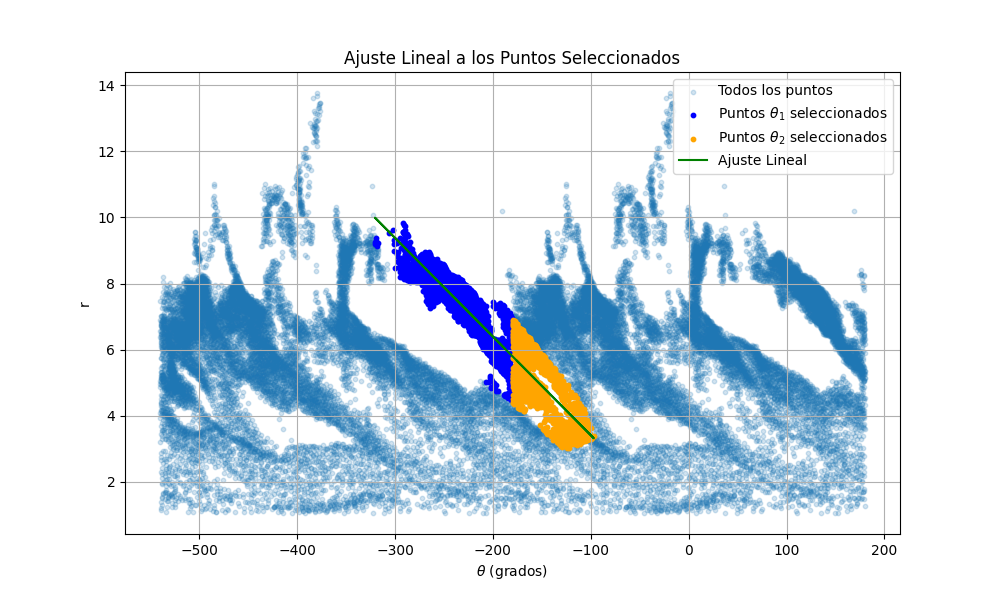

Ecuación de la recta ajustada: r = -0.0299 * θ + 0.4181


In [29]:
# Obtener los límites seleccionados
dict_lims = klicker.get_positions()

# Revisar si se seleccionaron al menos tres puntos para formar una región cerrada
if "limits" in dict_lims and len(dict_lims["limits"]) >= 3:
    # Crear un Path (camino) a partir de los puntos seleccionados
    polygon_path = Path(dict_lims["limits"])
    
    # Filtrar los puntos que están dentro del polígono seleccionado
    inside_points_theta1 = []
    inside_points_theta2 = []
    original_coords_theta1 = []  # Para almacenar las coordenadas originales de theta1
    original_coords_theta2 = []  # Para almacenar las coordenadas originales de theta2
    
    # Iterar sobre los puntos de theta1
    for i in range(len(data_theta1)):
        point = (data_theta1['theta'].iloc[i], data_theta1['r'].iloc[i])
        if polygon_path.contains_point(point):
            inside_points_theta1.append(point)
            original_coords_theta1.append((data['x'].iloc[i], data['y'].iloc[i]))

    # Iterar sobre los puntos de theta2
    for i in range(len(data_theta2)):
        point = (data_theta2['theta'].iloc[i], data_theta2['r'].iloc[i])
        if polygon_path.contains_point(point):
            inside_points_theta2.append(point)
            original_coords_theta2.append((data['x'].iloc[i], data['y'].iloc[i]))

    # Convertir los puntos seleccionados a DataFrame
    selected_data_theta1 = pd.DataFrame(inside_points_theta1, columns=['theta', 'r'])
    selected_data_theta2 = pd.DataFrame(inside_points_theta2, columns=['theta', 'r'])

    # Concatenar ambos para el ajuste lineal (si quieres usar todos los puntos seleccionados)
    selected_data = pd.concat([selected_data_theta1, selected_data_theta2], ignore_index=True)

    # Realizar ajuste lineal
    if len(selected_data) > 1:
        X_selected = selected_data[['theta']].values
        y_selected = selected_data['r'].values

        # Ajuste lineal
        model = LinearRegression()
        model.fit(X_selected, y_selected)
        slope = model.coef_[0]
        intercept = model.intercept_
        y_pred = model.predict(X_selected)

        # Graficar los puntos seleccionados, la línea ajustada y el fondo
        plt.figure(figsize=(10, 6))
        plt.scatter(data_combined['theta'], data_combined['r'], s=10, alpha=0.2, label='Todos los puntos')
        plt.scatter(selected_data_theta1['theta'], selected_data_theta1['r'], color='blue', s=10, label=r'Puntos $\theta_1$ seleccionados')
        plt.scatter(selected_data_theta2['theta'], selected_data_theta2['r'], color='orange', s=10, label=r'Puntos $\theta_2$ seleccionados')
        plt.plot(selected_data['theta'], y_pred, color='green', label='Ajuste Lineal')
        plt.title("Ajuste Lineal a los Puntos Seleccionados")
        plt.xlabel(r'$\theta$ (grados)')
        plt.ylabel('r')
        plt.legend()
        plt.grid(True)
        plt.show()

        # Mostrar la ecuación de la recta
        print(f"Ecuación de la recta ajustada: r = {slope:.4f} * θ + {intercept:.4f}")
    else:
        print("Selecciona más puntos para realizar el ajuste.")
else:
    print("Selecciona al menos tres puntos para definir una región cerrada.")


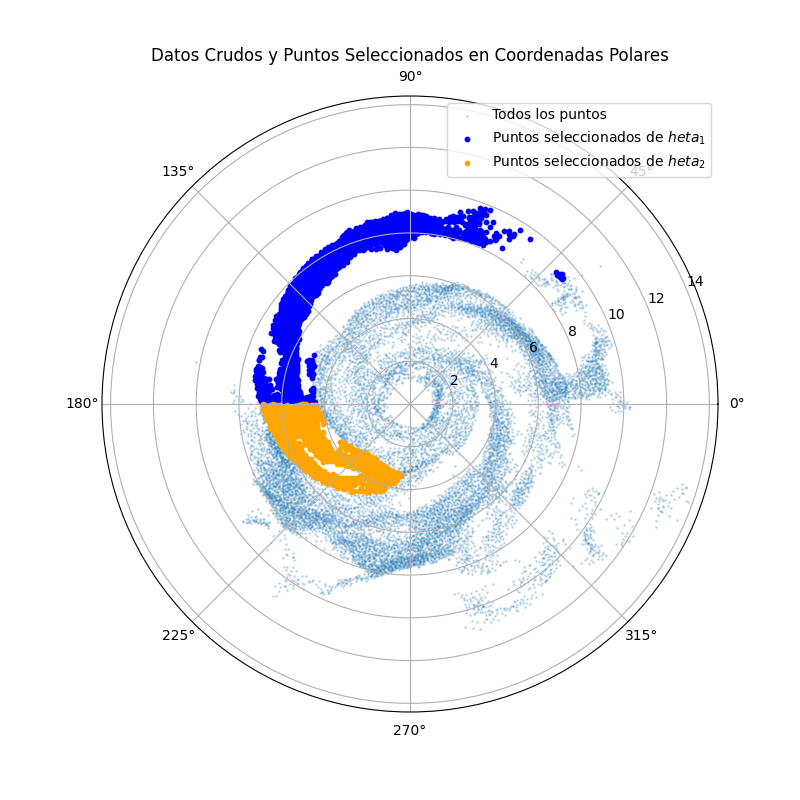

In [31]:
# Extraer las coordenadas originales x e y de los puntos seleccionados
selected_x_theta1 = [coord[0] for coord in original_coords_theta1]
selected_y_theta1 = [coord[1] for coord in original_coords_theta1]
selected_x_theta2 = [coord[0] for coord in original_coords_theta2]
selected_y_theta2 = [coord[1] for coord in original_coords_theta2]

# Configurar la gráfica en coordenadas polares
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(8, 8))

# Graficar todos los puntos en coordenadas polares
theta_all = np.arctan2(data['y'], data['x'])
r_all = np.sqrt(data['x']**2 + data['y']**2)
ax.scatter(theta_all, r_all, s=1, alpha=0.2, label="Todos los puntos")

# Graficar los puntos seleccionados de theta1 en azul
theta_selected_theta1 = np.arctan2(selected_y_theta1, selected_x_theta1)
r_selected_theta1 = np.sqrt(np.array(selected_x_theta1)**2 + np.array(selected_y_theta1)**2)
ax.scatter(theta_selected_theta1, r_selected_theta1, color='blue', s=10, label="Puntos seleccionados de $\theta_1$")

# Graficar los puntos seleccionados de theta2 en naranja
theta_selected_theta2 = np.arctan2(selected_y_theta2, selected_x_theta2)
r_selected_theta2 = np.sqrt(np.array(selected_x_theta2)**2 + np.array(selected_y_theta2)**2)
ax.scatter(theta_selected_theta2, r_selected_theta2, color='orange', s=10, label="Puntos seleccionados de $\theta_2$")

# Configuración de la gráfica
ax.set_title("Datos Crudos y Puntos Seleccionados en Coordenadas Polares")
ax.legend()
plt.show()


In [35]:
import pandas as pd

# Crear listas para almacenar los datos que irán en el DataFrame
limit_theta = []
limit_r = []
selected_theta = []
selected_r = []
selected_x = []
selected_y = []
source = []  # Para indicar si el punto es de theta1 o theta2

# Agregar los puntos límite de `dict_lims` al DataFrame
for point in dict_lims["limits"]:
    limit_theta.append(point[0])
    limit_r.append(point[1])
    selected_theta.append(None)  # Relleno vacío para mantener la estructura
    selected_r.append(None)
    selected_x.append(None)
    selected_y.append(None)
    source.append("limit")

# Agregar los puntos seleccionados de `theta1`
for i, (x, y) in enumerate(original_coords_theta1):
    theta = np.arctan2(y, x) * (180 / np.pi) - 360  # Calculamos theta en grados como en el procesamiento inicial
    r = np.sqrt(x**2 + y**2)
    
    limit_theta.append(None)  # Relleno vacío para mantener la estructura
    limit_r.append(None)
    selected_theta.append(theta)
    selected_r.append(r)
    selected_x.append(x)
    selected_y.append(y)
    source.append("theta1")

# Agregar los puntos seleccionados de `theta2`
for i, (x, y) in enumerate(original_coords_theta2):
    theta = np.arctan2(y, x) * (180 / np.pi) - 360
    r = np.sqrt(x**2 + y**2)
    
    limit_theta.append(None)
    limit_r.append(None)
    selected_theta.append(theta)
    selected_r.append(r)
    selected_x.append(x)
    selected_y.append(y)
    source.append("theta2")

# Crear el DataFrame con la estructura definida
df = pd.DataFrame({
    "limit_theta": limit_theta,
    "limit_r": limit_r,
    "selected_theta": selected_theta,
    "selected_r": selected_r,
    "selected_x": selected_x,
    "selected_y": selected_y,
    "source": source
})

# Guardar el DataFrame en un archivo CSV
df.to_csv("selected_data_info.csv", index=False)
print("Información guardada en 'selected_data_info.csv'")


Información guardada en 'selected_data_info.csv'


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_point_clicker import clicker
from matplotlib.path import Path
from sklearn.linear_model import LinearRegression

def seleccionar_puntos():
    """
    Función para seleccionar puntos sobre una gráfica utilizando `clicker`.
    Retorna un diccionario con los límites seleccionados y las coordenadas
    de los puntos en coordenadas cartesianas y polares.
    """
    global dict_lims  # Usamos una variable global para almacenar los límites de cada selección

    # Visualizar todos los puntos en coordenadas polares
    fig, ax = plt.subplots(figsize=(10, 6))
    scatter = ax.scatter(data_combined['theta'], data_combined['r'], s=10, alpha=0.5)
    ax.set_title("Selecciona los puntos límite para el ajuste de un nuevo brazo")
    ax.set_xlabel(r'$\theta$ (grados)')
    ax.set_ylabel('r')
    plt.grid(True)

    # Llamar a `clicker` para seleccionar los límites
    klicker = clicker(ax, ["limits"], markers=["o"], colors=['red'], markersize=5)
    plt.show()

    

In [ ]:
# Obtener los límites seleccionados
dict_lims = klicker.get_positions()

# Procesar los puntos seleccionados
if "limits" in dict_lims and len(dict_lims["limits"]) >= 3:
    # Crear un Path (camino) a partir de los puntos seleccionados
    polygon_path = Path(dict_lims["limits"])

    # Filtrar los puntos dentro del polígono seleccionado
    inside_points = []
    original_coords_theta1 = []
    original_coords_theta2 = []

    for i in range(len(data_combined)):
        point = (data_combined['theta'].iloc[i], data_combined['r'].iloc[i])
        if polygon_path.contains_point(point):
            inside_points.append(point)
            # Determinar si el punto corresponde a theta1 o theta2
            if i < len(data):
                original_coords_theta1.append((data['x'].iloc[i], data['y'].iloc[i]))
            else:
                index = i - len(data)
                original_coords_theta2.append((data['x'].iloc[index], data['y'].iloc[index]))

    # Crear DataFrame de los puntos seleccionados
    selected_data = pd.DataFrame(inside_points, columns=['theta', 'r'])

    # Retornar los resultados en un diccionario para cada brazo seleccionado
    return {
        "limits": dict_lims["limits"],
        "selected_data": selected_data,
        "original_coords_theta1": original_coords_theta1,
        "original_coords_theta2": original_coords_theta2
    }
else:
    print("Selecciona al menos tres puntos para definir una región cerrada.")
    return None


In [23]:

# Obtener los límites seleccionados
dict_lims = klicker.get_positions()

# Revisar si se seleccionaron al menos tres puntos para formar una región cerrada
if "limits" in dict_lims and len(dict_lims["limits"]) >= 3:
    # Crear un Path (camino) a partir de los puntos seleccionados
    polygon_path = Path(dict_lims["limits"])
    
    # Filtrar los puntos que están dentro del polígono seleccionado y rastrear coordenadas originales
    inside_points = []
    original_coordinates = []
    for i in range(len(data_combined)):
        point = (data_combined['theta'].iloc[i], data_combined['r'].iloc[i])
        if polygon_path.contains_point(point):
            inside_points.append(point)
            original_coordinates.append((data_combined['x'].iloc[i], data_combined['y'].iloc[i]))

    # Convertir los puntos seleccionados a DataFrame
    selected_data = pd.DataFrame(inside_points, columns=['theta', 'r'])
    original_coords_df = pd.DataFrame(original_coordinates, columns=['x', 'y'])

    # Graficar todos los puntos de fondo y resaltar los puntos seleccionados
    plt.figure(figsize=(10, 6))
    plt.scatter(data_combined['theta'], data_combined['r'], s=10, alpha=0.2, label='Todos los puntos')
    plt.scatter(selected_data['theta'], selected_data['r'], color='red', s=10, label='Puntos dentro de la región')
    plt.title("Puntos dentro de la región seleccionada")
    plt.xlabel(r'$\theta$ (grados)')
    plt.ylabel('r')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Realizar ajuste lineal
    if len(selected_data) > 1:
        X_selected = selected_data[['theta']].values
        y_selected = selected_data['r'].values

        # Ajuste lineal
        model = LinearRegression()
        model.fit(X_selected, y_selected)
        slope = model.coef_[0]
        intercept = model.intercept_
        y_pred = model.predict(X_selected)

        # Graficar los puntos seleccionados y la línea ajustada
        plt.figure(figsize=(10, 6))
        plt.scatter(data_combined['theta'], data_combined['r'], s=10, alpha=0.2, label='Todos los puntos')
        plt.scatter(selected_data['theta'], selected_data['r'], color='red', s=10, label='Puntos para el ajuste')
        plt.plot(selected_data['theta'], y_pred, color='blue', label='Ajuste Lineal')
        plt.title("Ajuste Lineal a los Puntos Seleccionados")
        plt.xlabel(r'$\theta$ (grados)')
        plt.ylabel('r')
        plt.legend()
        plt.grid(True)
        plt.show()

        # Mostrar la ecuación de la recta
        print(f"Ecuación de la recta ajustada: r = {slope:.4f} * θ + {intercept:.4f}")
    else:
        print("Selecciona más puntos para realizar el ajuste.")
else:
    print("Selecciona al menos tres puntos para definir una región cerrada.")

KeyError: 'x'

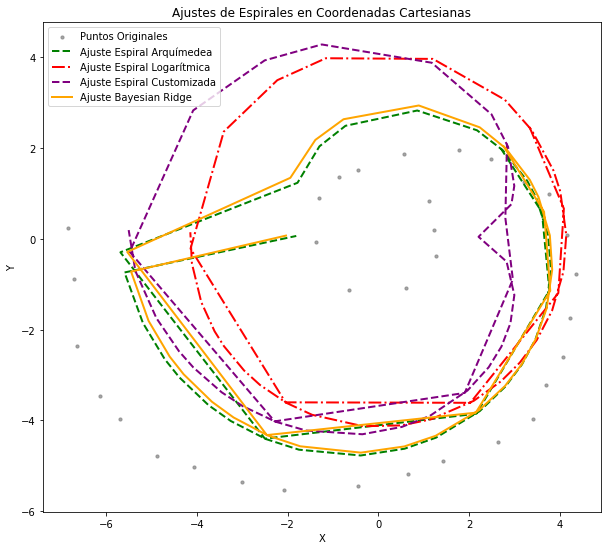

Resultados de los ajustes:
                 Model                                         Parameters  \
0   Espiral Arquímedea          [3.7560390756728417, -0.6267077144601149]   
1  Espiral Logarítmica  [4.144795649283389, 0.011000000000000275, 79.9...   
2  Espiral Customizada  [-19.9999999999996, 0.016170014218153176, 1.52...   
3       Bayesian Ridge                              [-0.5657282630924138]   

        MSE  
0  3.266596  
1  4.316159  
2  3.817522  
3  3.276523  


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from sklearn.linear_model import BayesianRidge
from sklearn.metrics import mean_squared_error

# Funciones de espirales en coordenadas cartesianas
def archimedean_spiral_cartesian(x, a, b):
    theta = np.arctan2(x[:,1], x[:,0])  # Calcular el ángulo a partir de las coordenadas
    return a + b * theta

def log_spiral_cartesian(x, A, B, N):
    theta = np.arctan2(x[:,1], x[:,0])
    return A * np.exp(B * theta / (2 * N))

def custom_spiral_cartesian(x, A, B, N):
    theta = np.arctan2(x[:,1], x[:,0])
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Cargar datos y convertir a coordenadas cartesianas
data_file = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
data = pd.read_csv(data_file)
x_values = data['x'].values
y_values = data['y'].values

# Preparar datos de entrada para ajuste (en formato [x, y])
points = np.column_stack((x_values, y_values))

# Graficar datos originales
fig, ax = plt.subplots(figsize=(10, 10))
ax.scatter(x_values, y_values, color='gray', s=10, alpha=0.7, label='Puntos Originales')

# Diccionario para almacenar los resultados de ajuste y MSE
fit_results = {'Model': [], 'Parameters': [], 'MSE': []}

# Ajuste con espiral arquimedeana en coordenadas cartesianas
try:
    popt_arch, _ = curve_fit(
        archimedean_spiral_cartesian, points, np.sqrt(x_values**2 + y_values**2), p0=[10, 0.1], maxfev=10000
    )
    r_fit_arch = archimedean_spiral_cartesian(points, *popt_arch)
    x_fit_arch = r_fit_arch * np.cos(np.arctan2(y_values, x_values))
    y_fit_arch = r_fit_arch * np.sin(np.arctan2(y_values, x_values))
    mse_arch = mean_squared_error(np.sqrt(x_values**2 + y_values**2), r_fit_arch)
    ax.plot(x_fit_arch, y_fit_arch, '--', color='green', linewidth=2, label='Ajuste Espiral Arquímedea')
    
    fit_results['Model'].append('Espiral Arquímedea')
    fit_results['Parameters'].append(popt_arch)
    fit_results['MSE'].append(mse_arch)
except RuntimeError:
    print("No se pudo ajustar la Espiral Arquímedea.")

# Ajuste con espiral logarítmica en coordenadas cartesianas
try:
    popt_log, _ = curve_fit(
        log_spiral_cartesian, points, np.sqrt(x_values**2 + y_values**2), p0=[10, 0.05, 2],
        bounds=((-20, 0.011, 0.1), (60, 10, 80)), maxfev=10000
    )
    r_fit_log = log_spiral_cartesian(points, *popt_log)
    x_fit_log = r_fit_log * np.cos(np.arctan2(y_values, x_values))
    y_fit_log = r_fit_log * np.sin(np.arctan2(y_values, x_values))
    mse_log = mean_squared_error(np.sqrt(x_values**2 + y_values**2), r_fit_log)
    ax.plot(x_fit_log, y_fit_log, '-.', color='red', linewidth=2, label='Ajuste Espiral Logarítmica')
    
    fit_results['Model'].append('Espiral Logarítmica')
    fit_results['Parameters'].append(popt_log)
    fit_results['MSE'].append(mse_log)
except RuntimeError:
    print("No se pudo ajustar la Espiral Logarítmica.")

# Ajuste con espiral personalizada en coordenadas cartesianas
try:
    popt_custom, _ = curve_fit(
        custom_spiral_cartesian, points, np.sqrt(x_values**2 + y_values**2), p0=[10, 0.5, 4],
        bounds=((-20, 0.01, 0.2), (60, 10, 80)), maxfev=10000
    )
    r_fit_custom = custom_spiral_cartesian(points, *popt_custom)
    x_fit_custom = r_fit_custom * np.cos(np.arctan2(y_values, x_values))
    y_fit_custom = r_fit_custom * np.sin(np.arctan2(y_values, x_values))
    mse_custom = mean_squared_error(np.sqrt(x_values**2 + y_values**2), r_fit_custom)
    ax.plot(x_fit_custom, y_fit_custom, '--', color='purple', linewidth=2, label='Ajuste Espiral Customizada')
    
    fit_results['Model'].append('Espiral Customizada')
    fit_results['Parameters'].append(popt_custom)
    fit_results['MSE'].append(mse_custom)
except RuntimeError:
    print("No se pudo ajustar la Espiral Customizada.")

# Ajuste con Bayesian Ridge Regression en coordenadas cartesianas
try:
    bayesian_ridge = BayesianRidge()
    theta_values = np.arctan2(y_values, x_values).reshape(-1, 1)
    bayesian_ridge.fit(theta_values, np.sqrt(x_values**2 + y_values**2))
    r_fit_bayesian = bayesian_ridge.predict(theta_values)
    x_fit_bayesian = r_fit_bayesian * np.cos(theta_values.flatten())
    y_fit_bayesian = r_fit_bayesian * np.sin(theta_values.flatten())
    mse_bayesian = mean_squared_error(np.sqrt(x_values**2 + y_values**2), r_fit_bayesian)
    ax.plot(x_fit_bayesian, y_fit_bayesian, '-', color='orange', linewidth=2, label='Ajuste Bayesian Ridge')
    
    fit_results['Model'].append('Bayesian Ridge')
    fit_results['Parameters'].append(bayesian_ridge.coef_)
    fit_results['MSE'].append(mse_bayesian)
except RuntimeError:
    print("No se pudo ajustar el modelo Bayesian Ridge.")

# Configuración de la gráfica
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_aspect('equal', 'box')
plt.title("Ajustes de Espirales en Coordenadas Cartesianas")
plt.legend()
plt.show()

# Mostrar resultados de ajustes en un DataFrame
df_results = pd.DataFrame(fit_results)
print("Resultados de los ajustes:")
print(df_results)



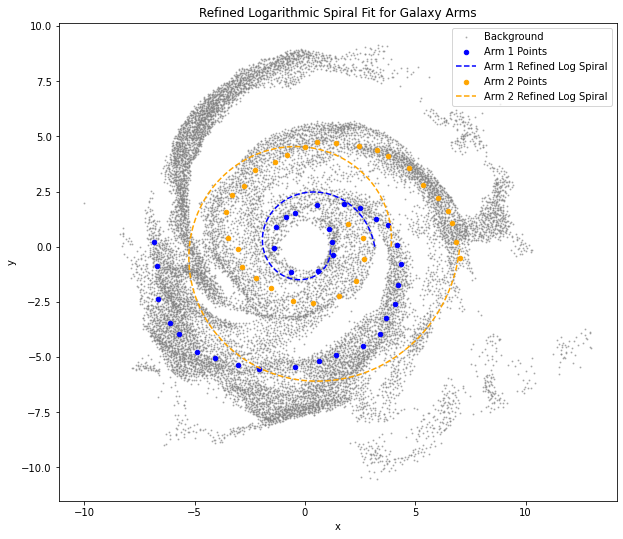

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Load the data from CSV files
arm1_data = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
arm2_data = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv')
background_data = pd.read_csv('../DATA/processed/TracingPoints/data_rho_11_filtered.csv')

# Define a function to fit a logarithmic spiral to the arm data points
def fit_log_spiral(x, y):
    # Convert Cartesian coordinates to polar
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    
    # Linearize the log-spiral equation: log(r) = a + b * theta
    # Using polyfit to fit a line to the transformed data
    b, a = np.polyfit(theta, np.log(r), 1)
    
    # Return the fit parameters
    return a, b

# Define a function to generate points for the fitted spiral
def generate_log_spiral(a, b, theta_range):
    theta_vals = np.linspace(theta_range[0], theta_range[1], 1000)
    r_vals = np.exp(a + b * theta_vals)
    x_vals = r_vals * np.cos(theta_vals)
    y_vals = r_vals * np.sin(theta_vals)
    return x_vals, y_vals

# Fit log spirals to the data for each arm
a1, b1 = fit_log_spiral(arm1_data['x'], arm1_data['y'])
a2, b2 = fit_log_spiral(arm2_data['x'], arm2_data['y'])

# Generate log spiral points based on the fit
theta_range = [0, 2 * np.pi]  # Full circle range
arm1_x_vals, arm1_y_vals = generate_log_spiral(a1, b1, theta_range)
arm2_x_vals, arm2_y_vals = generate_log_spiral(a2, b2, theta_range)

# Plot the background data and spiral arms
plt.figure(figsize=(10, 10))
plt.scatter(background_data['x'], background_data['y'], color='gray', alpha=0.5, s=1, label='Background')

# Plot the points and fitted spirals for each arm
plt.scatter(arm1_data['x'], arm1_data['y'], color='blue', s=20, label='Arm 1 Points')
plt.plot(arm1_x_vals, arm1_y_vals, 'b--', label='Arm 1 Refined Log Spiral')

plt.scatter(arm2_data['x'], arm2_data['y'], color='orange', s=20, label='Arm 2 Points')
plt.plot(arm2_x_vals, arm2_y_vals, 'orange', linestyle='--', label='Arm 2 Refined Log Spiral')

# Formatting the plot
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Refined Logarithmic Spiral Fit for Galaxy Arms')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.show()





In [22]:
background_file = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'
background_data = pd.read_csv(background_file)
x_background = background_data['x'].values
y_background = background_data['y'].values
r_background, theta_background = cartesian_to_polar(x_background, y_background)

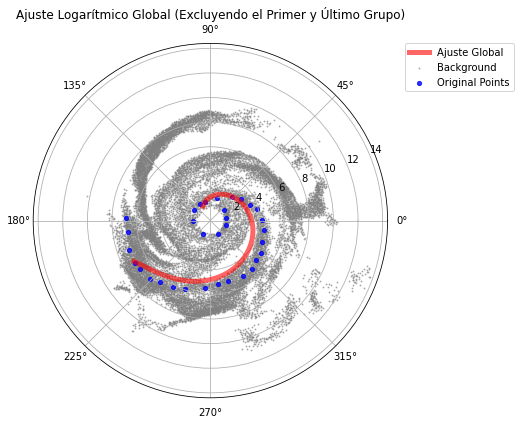

In [29]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import BayesianRidge

# Define the logarithmic spiral function
def log_spiral(phi, A, B, N):
    safe_phi = np.clip(phi, 1e-6, None)  # Avoid problematic values for tan and log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Convert Cartesian coordinates to polar
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return r, phi

# Load data
data_arm = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')

# Extract x and y, then convert to polar coordinates
x_values = data_arm['x'].values
y_values = data_arm['y'].values
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Sort values by angle for better plotting
sorted_indices = np.argsort(phi_values)
r_values_sorted = r_values[sorted_indices]
phi_values_sorted = phi_values[sorted_indices]

# Define limits for the radius
r_min = np.percentile(r_values_sorted, 2.5)  # Avoiding closest points
r_max = np.percentile(r_values_sorted, 97.5)  # Avoiding farthest points

# Store points for global fit excluding the first and last groups
r_values_for_global = []
phi_values_for_global = []

# Function to divide points into groups of a given size
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]

# Bayesian spiral fitting class
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None

    def fit(self, phi, r):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        self.bayesian_ridge.fit(X, r)
        self.A_, self.B_, self.N_ = self.bayesian_ridge.coef_
        return self.bayesian_ridge.score(X, r)

    def predict(self, phi, r_min, r_max):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        r_pred = self.bayesian_ridge.predict(X)
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]

# Fit each subset of points

for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_sorted, phi_values_sorted)):
    if len(r_group) < 3:
        continue
    if group_index == 0 or group_index == (len(r_values_sorted) // 3 - 1):
        continue

    r_values_for_global.extend(r_group)
    phi_values_for_global.extend(phi_group)

    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)

    phi_fit = np.linspace(np.min(phi_values_sorted), np.max(phi_values_sorted), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, r_min, r_max)
    

# Global fit excluding the first and last groups
r_values_for_global = np.array(r_values_for_global)
phi_values_for_global = np.array(phi_values_for_global)

bayesian_spiral_global = BayesianSpiralFitter()
bayesian_spiral_global.fit(phi_values_for_global, r_values_for_global)

phi_fit_global = np.linspace(np.min(phi_values), np.max(phi_values), 100)
r_fit_global, phi_fit_filtered_global = bayesian_spiral_global.predict(phi_fit_global, r_min, r_max)

fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_global.plot(phi_fit_filtered_global, r_fit_global, color='red', linewidth=5, alpha=0.6, label='Ajuste Global')
ax_global.scatter(theta_background,r_background, color='gray', alpha=0.5, s=1, label='Background')
ax_global.scatter(phi_values_sorted, r_values_sorted, s=17, alpha=0.8, c='blue', label="Original Points")

ax_global.set_title('Ajuste Logarítmico Global (Excluyendo el Primer y Último Grupo)')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

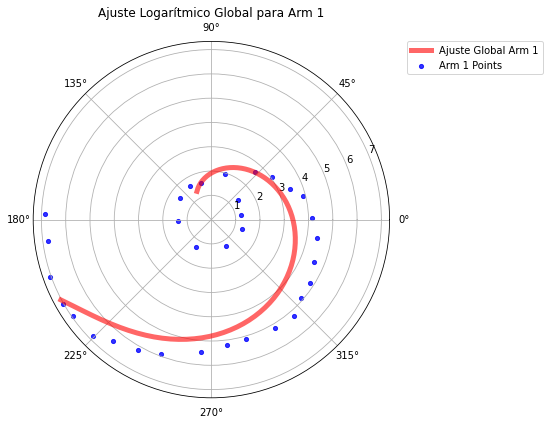

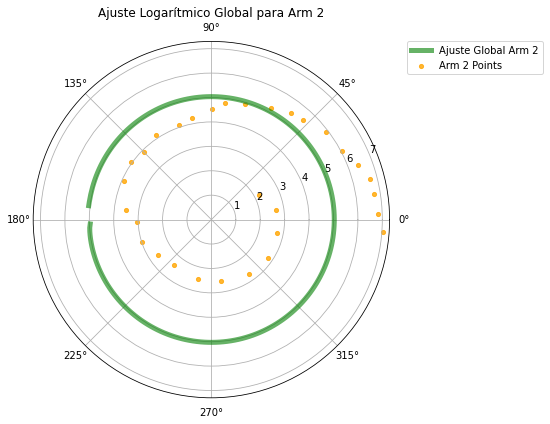

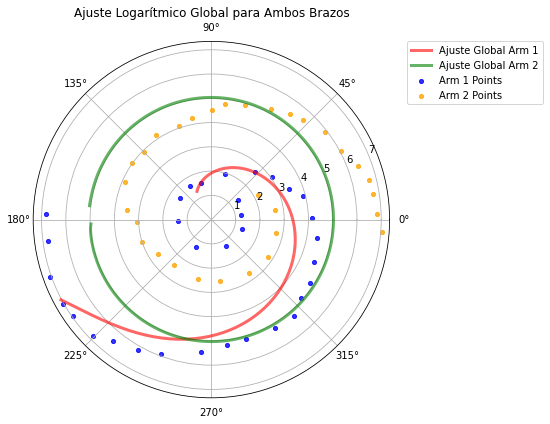

In [32]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import BayesianRidge

# Define the logarithmic spiral function
def log_spiral(phi, A, B, N):
    safe_phi = np.clip(phi, 1e-6, None)  # Avoid problematic values for tan and log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Convert Cartesian coordinates to polar
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return r, phi

# Function to divide points into groups of a given size
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]

# Bayesian spiral fitting class
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None

    def fit(self, phi, r):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        self.bayesian_ridge.fit(X, r)
        self.A_, self.B_, self.N_ = self.bayesian_ridge.coef_

    def predict(self, phi, r_min, r_max):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        r_pred = self.bayesian_ridge.predict(X)
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]

# Load and process data for Arm 1 using the reference approach
data_arm1 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
x_values_arm1, y_values_arm1 = data_arm1['x'].values, data_arm1['y'].values
r_values_arm1, phi_values_arm1 = cartesian_to_polar(x_values_arm1, y_values_arm1)

# Sort values by angle for better plotting
sorted_indices_arm1 = np.argsort(phi_values_arm1)
r_values_sorted_arm1 = r_values_arm1[sorted_indices_arm1]
phi_values_sorted_arm1 = phi_values_arm1[sorted_indices_arm1]

# Define limits for the radius
r_min_arm1 = np.percentile(r_values_sorted_arm1, 2.5)
r_max_arm1 = np.percentile(r_values_sorted_arm1, 97.5)

# Store points for global fit excluding the first and last groups
r_values_for_global_arm1 = []
phi_values_for_global_arm1 = []

for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_sorted_arm1, phi_values_sorted_arm1)):
    if len(r_group) < 3:
        continue
    if group_index == 0 or group_index == (len(r_values_sorted_arm1) // 3 - 1):
        continue
    r_values_for_global_arm1.extend(r_group)
    phi_values_for_global_arm1.extend(phi_group)

# Perform global fitting for Arm 1
r_values_for_global_arm1 = np.array(r_values_for_global_arm1)
phi_values_for_global_arm1 = np.array(phi_values_for_global_arm1)
bayesian_spiral_global_arm1 = BayesianSpiralFitter()
bayesian_spiral_global_arm1.fit(phi_values_for_global_arm1, r_values_for_global_arm1)

# Predict adjusted data for Arm 1
phi_fit_global_arm1 = np.linspace(np.min(phi_values_arm1), np.max(phi_values_arm1), 100)
r_fit_global_arm1, phi_fit_filtered_global_arm1 = bayesian_spiral_global_arm1.predict(phi_fit_global_arm1, r_min_arm1, r_max_arm1)

# Load and process data for Arm 2 using the modified approach
data_arm2 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv')
x_values_arm2, y_values_arm2 = data_arm2['x'].values, data_arm2['y'].values
r_values_arm2, phi_values_arm2 = cartesian_to_polar(x_values_arm2, y_values_arm2)

# Sort values for Arm 2 for consistent fitting
sorted_indices_arm2 = np.argsort(phi_values_arm2)
r_values_sorted_arm2 = r_values_arm2[sorted_indices_arm2]
phi_values_sorted_arm2 = phi_values_arm2[sorted_indices_arm2]

# Define radius limits for Arm 2
r_min_arm2 = np.percentile(r_values_sorted_arm2, 5)
r_max_arm2 = np.percentile(r_values_sorted_arm2, 95)

# Store points for global fit for Arm 2, excluding more edge groups for stability
r_values_for_global_arm2 = []
phi_values_for_global_arm2 = []
for i, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_sorted_arm2, phi_values_sorted_arm2, group_size=5)):
    if len(r_group) < 3:
        continue
    if i < 3 or i > len(r_values_sorted_arm2) // 5 - 3:
        continue
    r_values_for_global_arm2.extend(r_group)
    phi_values_for_global_arm2.extend(phi_group)

# Perform global fitting for Arm 2
bayesian_spiral_global_arm2 = BayesianSpiralFitter(alpha_1=1e-4, lambda_1=1e-4)  # Adjusted parameters
bayesian_spiral_global_arm2.fit(np.array(phi_values_for_global_arm2), np.array(r_values_for_global_arm2))

# Predict adjusted data for Arm 2
phi_fit_global_arm2 = np.linspace(np.min(phi_values_arm2), np.max(phi_values_arm2), 200)
r_fit_global_arm2, phi_fit_filtered_global_arm2 = bayesian_spiral_global_arm2.predict(phi_fit_global_arm2, r_min_arm2, r_max_arm2)

# Plot Arm 1
fig, ax1 = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax1.plot(phi_fit_filtered_global_arm1, r_fit_global_arm1, color='red', linewidth=5, alpha=0.6, label='Ajuste Global Arm 1')
ax1.scatter(phi_values_sorted_arm1, r_values_sorted_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax1.set_title('Ajuste Logarítmico Global para Arm 1')
ax1.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Plot Arm 2
fig, ax2 = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax2.plot(phi_fit_filtered_global_arm2, r_fit_global_arm2, color='green', linewidth=5, alpha=0.6, label='Ajuste Global Arm 2')
ax2.scatter(phi_values_sorted_arm2, r_values_sorted_arm2, s=17, alpha=0.8, color='orange', label="Arm 2 Points")
ax2.set_title('Ajuste Logarítmico Global para Arm 2')
ax2.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Combined Plot
fig, ax_combined = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_combined.plot(phi_fit_filtered_global_arm1, r_fit_global_arm1, color='red', linewidth=3, alpha=0.6, label='Ajuste Global Arm 1')
ax_combined.plot(phi_fit_filtered_global_arm2, r_fit_global_arm2, color='green', linewidth=3, alpha=0.6, label='Ajuste Global Arm 2')
ax_combined.scatter(phi_values_sorted_arm1, r_values_sorted_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax_combined.scatter(phi_values_sorted_arm2, r_values_sorted_arm2, s=17, alpha=0.8, color='orange', label="Arm 2 Points")
ax_combined.set_title('Ajuste Logarítmico Global para Ambos Brazos')
ax_combined.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()


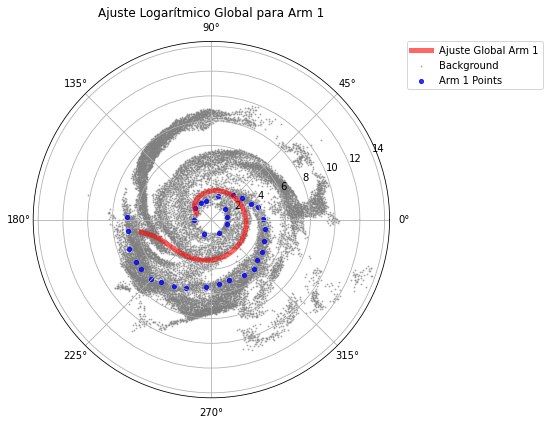

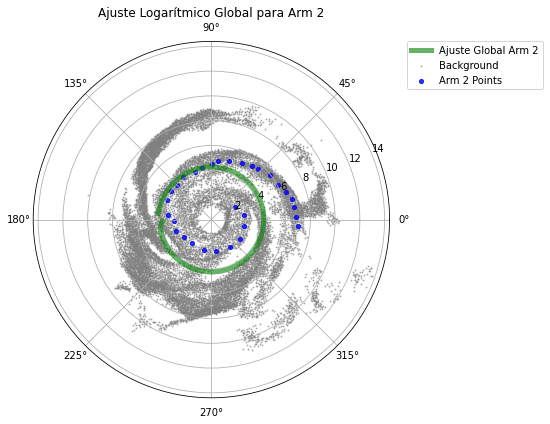

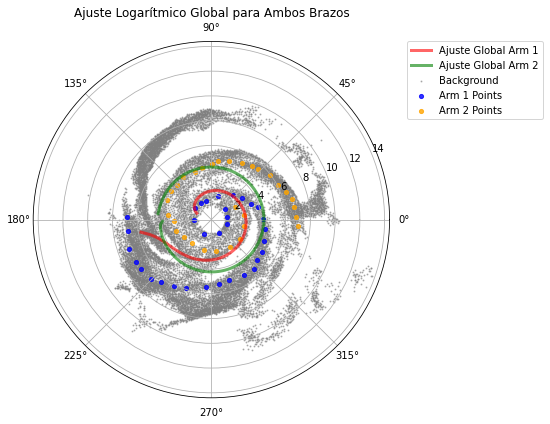

In [30]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import BayesianRidge

# Define the logarithmic spiral function
def log_spiral(phi, A, B, N):
    safe_phi = np.clip(phi, 1e-6, None)  # Avoid problematic values for tan and log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Convert Cartesian coordinates to polar
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return r, phi

# Function to divide points into groups of a given size
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]

# Bayesian spiral fitting class
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None

    def fit(self, phi, r):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        self.bayesian_ridge.fit(X, r)
        self.A_, self.B_, self.N_ = self.bayesian_ridge.coef_

    def predict(self, phi, r_min, r_max):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        r_pred = self.bayesian_ridge.predict(X)
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]

# Load and process data for both arms
data_arm1 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
data_arm2 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv')
background_data = pd.read_csv('../DATA/processed/TracingPoints/data_rho_11_filtered.csv')

# Convert background data to polar coordinates
background_x, background_y = background_data['x'].values, background_data['y'].values
r_background, theta_background = cartesian_to_polar(background_x, background_y)

# Function to process each arm
def process_arm(data):
    x_values, y_values = data['x'].values, data['y'].values
    r_values, phi_values = cartesian_to_polar(x_values, y_values)

    # Sort values for consistent fitting
    sorted_indices = np.argsort(phi_values)
    r_values_sorted = r_values[sorted_indices]
    phi_values_sorted = phi_values[sorted_indices]

    # Define radius limits to exclude extreme points
    r_min = np.percentile(r_values_sorted, 2.5)
    r_max = np.percentile(r_values_sorted, 97.5)

    # Collect points for global fit excluding edge groups
    r_values_for_global = []
    phi_values_for_global = []
    for r_group, phi_group in divide_points_in_groups(r_values_sorted, phi_values_sorted):
        if len(r_group) < 3:
            continue
        r_values_for_global.extend(r_group[1:-1])
        phi_values_for_global.extend(phi_group[1:-1])

    # Perform global fitting
    bayesian_spiral_global = BayesianSpiralFitter()
    bayesian_spiral_global.fit(np.array(phi_values_for_global), np.array(r_values_for_global))

    # Predict adjusted data
    phi_fit_global = np.linspace(np.min(phi_values_sorted), np.max(phi_values_sorted), 100)
    r_fit_global, phi_fit_filtered_global = bayesian_spiral_global.predict(phi_fit_global, r_min, r_max)

    return phi_values_sorted, r_values_sorted, phi_fit_filtered_global, r_fit_global

# Process Arm 1
phi_values_sorted_arm1, r_values_sorted_arm1, phi_fit_filtered_global_arm1, r_fit_global_arm1 = process_arm(data_arm1)

# Process Arm 2
phi_values_sorted_arm2, r_values_sorted_arm2, phi_fit_filtered_global_arm2, r_fit_global_arm2 = process_arm(data_arm2)

# Plot Arm 1 separately
fig, ax1 = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax1.plot(phi_fit_filtered_global_arm1, r_fit_global_arm1, color='red', linewidth=5, alpha=0.6, label='Ajuste Global Arm 1')
ax1.scatter(theta_background, r_background, color='gray', alpha=0.5, s=1, label='Background')
ax1.scatter(phi_values_sorted_arm1, r_values_sorted_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax1.set_title('Ajuste Logarítmico Global para Arm 1')
ax1.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Plot Arm 2 separately
fig, ax2 = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax2.plot(phi_fit_filtered_global_arm2, r_fit_global_arm2, color='green', linewidth=5, alpha=0.6, label='Ajuste Global Arm 2')
ax2.scatter(theta_background, r_background, color='gray', alpha=0.5, s=1, label='Background')
ax2.scatter(phi_values_sorted_arm2, r_values_sorted_arm2, s=17, alpha=0.8, color='blue', label="Arm 2 Points")
ax2.set_title('Ajuste Logarítmico Global para Arm 2')
ax2.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Plot both Arm 1 and Arm 2 together
fig, ax_combined = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_combined.plot(phi_fit_filtered_global_arm1, r_fit_global_arm1, color='red', linewidth=3, alpha=0.6, label='Ajuste Global Arm 1')
ax_combined.plot(phi_fit_filtered_global_arm2, r_fit_global_arm2, color='green', linewidth=3, alpha=0.6, label='Ajuste Global Arm 2')
ax_combined.scatter(theta_background, r_background, color='gray', alpha=0.5, s=1, label='Background')
ax_combined.scatter(phi_values_sorted_arm1, r_values_sorted_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax_combined.scatter(phi_values_sorted_arm2, r_values_sorted_arm2, s=17, alpha=0.8, color='orange', label="Arm 2 Points")
ax_combined.set_title('Ajuste Logarítmico Global para Ambos Brazos')
ax_combined.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()


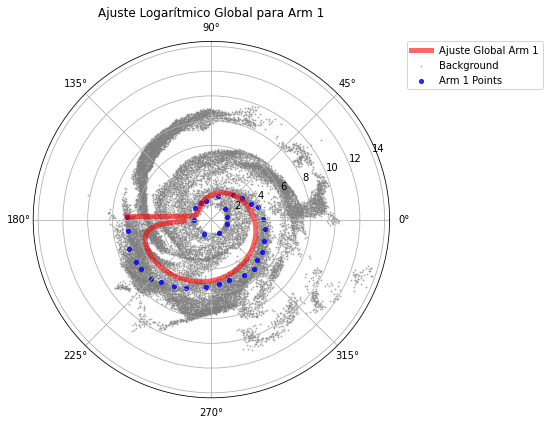

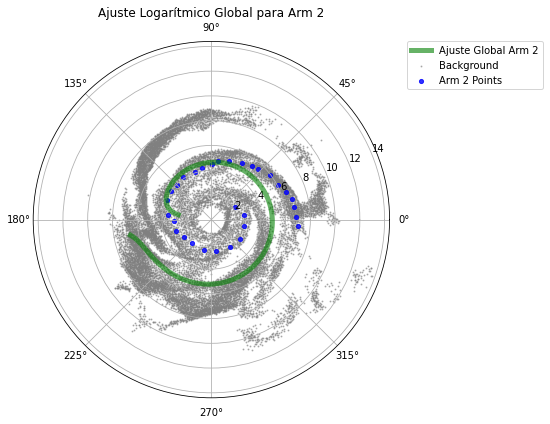

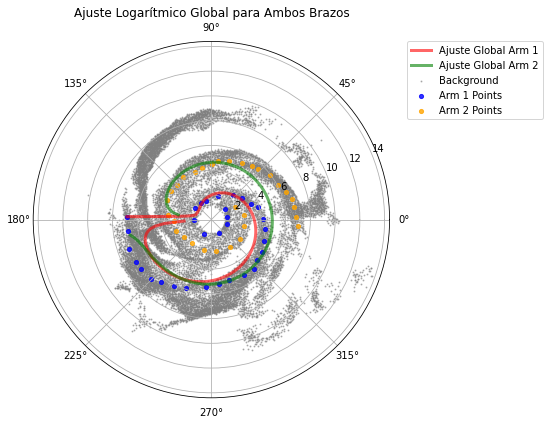

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import BayesianRidge

# Define the logarithmic spiral function
def log_spiral(phi, A, B, N):
    safe_phi = np.clip(phi, 1e-6, None)  # Avoid problematic values for tan and log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Convert Cartesian coordinates to polar
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return r, phi

# Function to divide points into groups of a given size
def divide_points_in_groups(r_values, phi_values, group_size=5):  # Increased group size for stability
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]

# Bayesian spiral fitting class
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-4, lambda_1=1e-4):  # Adjusted parameters for more stability
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None

    def fit(self, phi, r):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        self.bayesian_ridge.fit(X, r)
        self.A_, self.B_, self.N_ = self.bayesian_ridge.coef_

    def predict(self, phi, r_min, r_max):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        r_pred = self.bayesian_ridge.predict(X)
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]

# Load and process data for both arms
data_arm1 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
data_arm2 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv')
background_data = pd.read_csv('../DATA/processed/TracingPoints/data_rho_11_filtered.csv')

# Convert background data to polar coordinates
background_x, background_y = background_data['x'].values, background_data['y'].values
r_background, theta_background = cartesian_to_polar(background_x, background_y)

# Function to process each arm
def process_arm(data, exclude_edges=3):  # Exclude more edge groups for stability
    x_values, y_values = data['x'].values, data['y'].values
    r_values, phi_values = cartesian_to_polar(x_values, y_values)

    # Sort values for consistent fitting
    sorted_indices = np.argsort(phi_values)
    r_values_sorted = r_values[sorted_indices]
    phi_values_sorted = phi_values[sorted_indices]

    # Define radius limits to exclude extreme points
    r_min = np.percentile(r_values_sorted, 5)
    r_max = np.percentile(r_values_sorted, 95)

    # Collect points for global fit excluding more edge groups
    r_values_for_global = []
    phi_values_for_global = []
    for i, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_sorted, phi_values_sorted)):
        if len(r_group) < 3:
            continue
        if i < exclude_edges or i > len(r_values_sorted) // 3 - exclude_edges:
            continue  # Skip edge groups
        r_values_for_global.extend(r_group)
        phi_values_for_global.extend(phi_group)

    # Perform global fitting
    bayesian_spiral_global = BayesianSpiralFitter()
    bayesian_spiral_global.fit(np.array(phi_values_for_global), np.array(r_values_for_global))

    # Predict adjusted data with finer resolution
    phi_fit_global = np.linspace(np.min(phi_values_sorted), np.max(phi_values_sorted), 200)  # Increased resolution
    r_fit_global, phi_fit_filtered_global = bayesian_spiral_global.predict(phi_fit_global, r_min, r_max)

    return phi_values_sorted, r_values_sorted, phi_fit_filtered_global, r_fit_global

# Process Arm 1
phi_values_sorted_arm1, r_values_sorted_arm1, phi_fit_filtered_global_arm1, r_fit_global_arm1 = process_arm(data_arm1)

# Process Arm 2
phi_values_sorted_arm2, r_values_sorted_arm2, phi_fit_filtered_global_arm2, r_fit_global_arm2 = process_arm(data_arm2)

# Plot Arm 1 separately
fig, ax1 = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax1.plot(phi_fit_filtered_global_arm1, r_fit_global_arm1, color='red', linewidth=5, alpha=0.6, label='Ajuste Global Arm 1')
ax1.scatter(theta_background, r_background, color='gray', alpha=0.5, s=1, label='Background')
ax1.scatter(phi_values_sorted_arm1, r_values_sorted_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax1.set_title('Ajuste Logarítmico Global para Arm 1')
ax1.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Plot Arm 2 separately
fig, ax2 = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax2.plot(phi_fit_filtered_global_arm2, r_fit_global_arm2, color='green', linewidth=5, alpha=0.6, label='Ajuste Global Arm 2')
ax2.scatter(theta_background, r_background, color='gray', alpha=0.5, s=1, label='Background')
ax2.scatter(phi_values_sorted_arm2, r_values_sorted_arm2, s=17, alpha=0.8, color='blue', label="Arm 2 Points")
ax2.set_title('Ajuste Logarítmico Global para Arm 2')
ax2.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Plot both Arm 1 and Arm 2 together
fig, ax_combined = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_combined.plot(phi_fit_filtered_global_arm1, r_fit_global_arm1, color='red', linewidth=3, alpha=0.6, label='Ajuste Global Arm 1')
ax_combined.plot(phi_fit_filtered_global_arm2, r_fit_global_arm2, color='green', linewidth=3, alpha=0.6, label='Ajuste Global Arm 2')
ax_combined.scatter(theta_background, r_background, color='gray', alpha=0.5, s=1, label='Background')
ax_combined.scatter(phi_values_sorted_arm1, r_values_sorted_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax_combined.scatter(phi_values_sorted_arm2, r_values_sorted_arm2, s=17, alpha=0.8, color='orange', label="Arm 2 Points")
ax_combined.set_title('Ajuste Logarítmico Global para Ambos Brazos')
ax_combined.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()


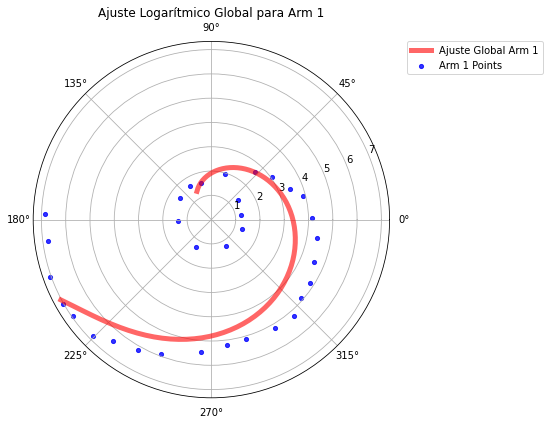

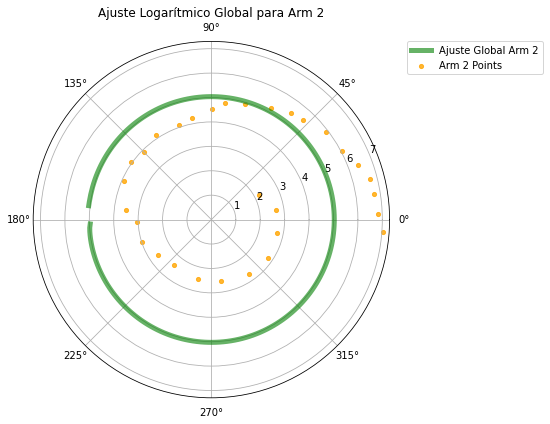

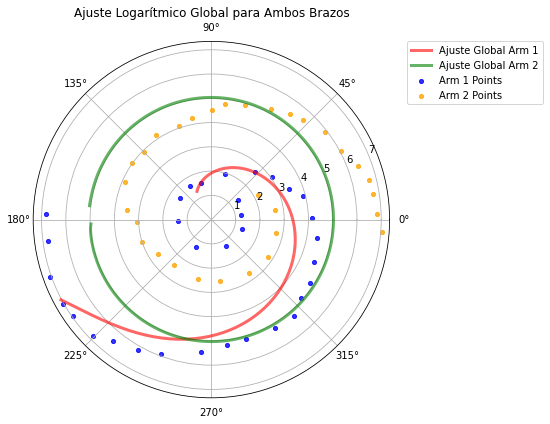

In [37]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import BayesianRidge

# Define the logarithmic spiral function
def log_spiral(phi, A, B, N):
    safe_phi = np.clip(phi, 1e-6, None)  # Avoid problematic values for tan and log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Convert Cartesian coordinates to polar
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return r, phi

# Function to divide points into groups of a given size
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]

# Bayesian spiral fitting class
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None

    def fit(self, phi, r):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        self.bayesian_ridge.fit(X, r)
        self.A_, self.B_, self.N_ = self.bayesian_ridge.coef_

    def predict(self, phi, r_min, r_max):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        r_pred = self.bayesian_ridge.predict(X)
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]

# Load and process data for Arm 1 with the original correct method
data_arm1 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
x_values_arm1, y_values_arm1 = data_arm1['x'].values, data_arm1['y'].values
r_values_arm1, phi_values_arm1 = cartesian_to_polar(x_values_arm1, y_values_arm1)

# Sort values for better plotting
sorted_indices_arm1 = np.argsort(phi_values_arm1)
r_values_sorted_arm1 = r_values_arm1[sorted_indices_arm1]
phi_values_sorted_arm1 = phi_values_arm1[sorted_indices_arm1]

# Define limits for the radius
r_min_arm1 = np.percentile(r_values_sorted_arm1, 2.5)
r_max_arm1 = np.percentile(r_values_sorted_arm1, 97.5)

# Store points for global fit excluding the first and last groups
r_values_for_global_arm1 = []
phi_values_for_global_arm1 = []

for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_sorted_arm1, phi_values_sorted_arm1)):
    if len(r_group) < 3:
        continue
    if group_index == 0 or group_index == (len(r_values_sorted_arm1) // 3 - 1):
        continue
    r_values_for_global_arm1.extend(r_group)
    phi_values_for_global_arm1.extend(phi_group)

# Perform global fitting for Arm 1
r_values_for_global_arm1 = np.array(r_values_for_global_arm1)
phi_values_for_global_arm1 = np.array(phi_values_for_global_arm1)
bayesian_spiral_global_arm1 = BayesianSpiralFitter()
bayesian_spiral_global_arm1.fit(phi_values_for_global_arm1, r_values_for_global_arm1)

# Predict adjusted data for Arm 1
phi_fit_global_arm1 = np.linspace(np.min(phi_values_arm1), np.max(phi_values_arm1), 100)
r_fit_global_arm1, phi_fit_filtered_global_arm1 = bayesian_spiral_global_arm1.predict(phi_fit_global_arm1, r_min_arm1, r_max_arm1)

# Load and process data for Arm 2 with the modified method
data_arm2 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv')
x_values_arm2, y_values_arm2 = data_arm2['x'].values, data_arm2['y'].values
r_values_arm2, phi_values_arm2 = cartesian_to_polar(x_values_arm2, y_values_arm2)

# Sort values for Arm 2 for consistent fitting
sorted_indices_arm2 = np.argsort(phi_values_arm2)
r_values_sorted_arm2 = r_values_arm2[sorted_indices_arm2]
phi_values_sorted_arm2 = phi_values_arm2[sorted_indices_arm2]

# Define radius limits for Arm 2
r_min_arm2 = np.percentile(r_values_sorted_arm2, 5)
r_max_arm2 = np.percentile(r_values_sorted_arm2, 95)

# Store points for global fit for Arm 2, excluding more edge groups for stability
r_values_for_global_arm2 = []
phi_values_for_global_arm2 = []
for i, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_sorted_arm2, phi_values_sorted_arm2, group_size=5)):
    if len(r_group) < 3:
        continue
    if i < 3 or i > len(r_values_sorted_arm2) // 5 - 3:
        continue
    r_values_for_global_arm2.extend(r_group)
    phi_values_for_global_arm2.extend(phi_group)

# Perform global fitting for Arm 2
bayesian_spiral_global_arm2 = BayesianSpiralFitter(alpha_1=1e-4, lambda_1=1e-4)  # Adjusted parameters
bayesian_spiral_global_arm2.fit(np.array(phi_values_for_global_arm2), np.array(r_values_for_global_arm2))

# Predict adjusted data for Arm 2
phi_fit_global_arm2 = np.linspace(np.min(phi_values_arm2), np.max(phi_values_arm2), 200)
r_fit_global_arm2, phi_fit_filtered_global_arm2 = bayesian_spiral_global_arm2.predict(phi_fit_global_arm2, r_min_arm2, r_max_arm2)

# Plot Arm 1
fig, ax1 = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax1.plot(phi_fit_filtered_global_arm1, r_fit_global_arm1, color='red', linewidth=5, alpha=0.6, label='Ajuste Global Arm 1')
ax1.scatter(phi_values_sorted_arm1, r_values_sorted_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax1.set_title('Ajuste Logarítmico Global para Arm 1')
ax1.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Plot Arm 2
fig, ax2 = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax2.plot(phi_fit_filtered_global_arm2, r_fit_global_arm2, color='green', linewidth=5, alpha=0.6, label='Ajuste Global Arm 2')
ax2.scatter(phi_values_sorted_arm2, r_values_sorted_arm2, s=17, alpha=0.8, color='orange', label="Arm 2 Points")
ax2.set_title('Ajuste Logarítmico Global para Arm 2')
ax2.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Combined Plot
fig, ax_combined = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_combined.plot(phi_fit_filtered_global_arm1, r_fit_global_arm1, color='red', linewidth=3, alpha=0.6, label='Ajuste Global Arm 1')
ax_combined.plot(phi_fit_filtered_global_arm2, r_fit_global_arm2, color='green', linewidth=3, alpha=0.6, label='Ajuste Global Arm 2')
ax_combined.scatter(phi_values_sorted_arm1, r_values_sorted_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax_combined.scatter(phi_values_sorted_arm2, r_values_sorted_arm2, s=17, alpha=0.8, color='orange', label="Arm 2 Points")
ax_combined.set_title('Ajuste Logarítmico Global para Ambos Brazos')
ax_combined.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()


Parámetros ajustados: A = 1.912, B = 0.205


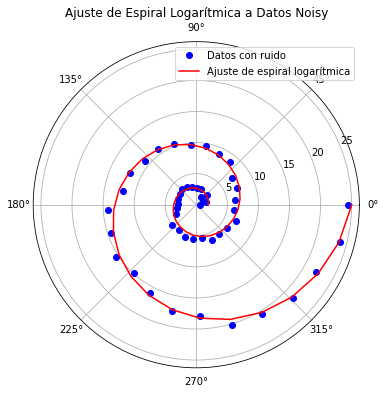

In [38]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Ejemplo de puntos en coordenadas polares (ángulo en radianes y radio)
# Puedes reemplazar estos datos con tus propios puntos
theta_data = np.linspace(0, 4 * np.pi, 50)  # Ángulos de 0 a 4π
r_data = 2 * np.exp(0.2 * theta_data)  # Ejemplo de espiral con A=2 y B=0.2

# Agregar un poco de ruido a los datos simulados
r_data_noisy = r_data + 0.5 * np.random.normal(size=theta_data.size)

# Definir la función de espiral logarítmica a ajustar
def log_spiral(theta, A, B):
    return A * np.exp(B * theta)

# Realizar el ajuste de curva utilizando scipy.optimize.curve_fit
popt, pcov = curve_fit(log_spiral, theta_data, r_data_noisy, p0=[1, 0.1])

# Extraer los valores óptimos de A y B
A_fit, B_fit = popt
print(f"Parámetros ajustados: A = {A_fit:.3f}, B = {B_fit:.3f}")

# Generar puntos ajustados con los parámetros obtenidos
r_fit = log_spiral(theta_data, A_fit, B_fit)

# Visualización del ajuste
plt.figure(figsize=(8, 6))
plt.polar(theta_data, r_data_noisy, 'o', label='Datos con ruido', color='blue')
plt.polar(theta_data, r_fit, '-', label='Ajuste de espiral logarítmica', color='red')
plt.legend(loc="upper right")
plt.title("Ajuste de Espiral Logarítmica a Datos Noisy")
plt.show()


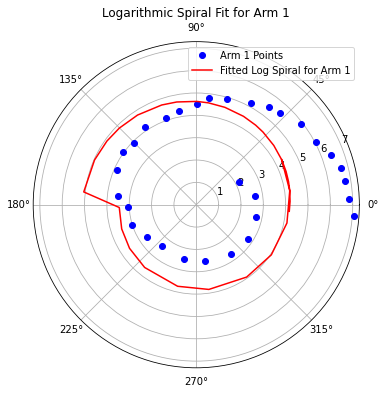

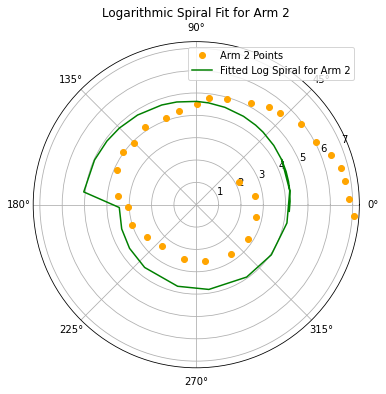

Parámetros ajustados para Arm 1: A = 4.191, B = 0.063
Parámetros ajustados para Arm 2: A = 4.191, B = 0.063


In [39]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)  # Radio
    theta = np.arctan2(y, x)  # Ángulo en radianes
    return r, theta

# Definir la función de espiral logarítmica
def log_spiral(theta, A, B):
    return A * np.exp(B * theta)

# Cargar los datos de cada brazo
data_arm1 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
data_arm1 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv')
# Convertir datos de Arm 1 a coordenadas polares
r_arm1, theta_arm1 = cartesian_to_polar(data_arm1['x'].values, data_arm1['y'].values)

# Convertir datos de Arm 2 a coordenadas polares
r_arm2, theta_arm2 = cartesian_to_polar(data_arm2['x'].values, data_arm2['y'].values)

# Ajustar el modelo a los datos de Arm 1
popt_arm1, _ = curve_fit(log_spiral, theta_arm1, r_arm1, p0=[1, 0.1])
A_fit_arm1, B_fit_arm1 = popt_arm1

# Ajustar el modelo a los datos de Arm 2
popt_arm2, _ = curve_fit(log_spiral, theta_arm2, r_arm2, p0=[1, 0.1])
A_fit_arm2, B_fit_arm2 = popt_arm2

# Generar los valores ajustados para cada brazo
r_fit_arm1 = log_spiral(theta_arm1, A_fit_arm1, B_fit_arm1)
r_fit_arm2 = log_spiral(theta_arm2, A_fit_arm2, B_fit_arm2)

# Graficar Arm 1 con su espiral ajustada
plt.figure(figsize=(8, 6))
ax1 = plt.subplot(111, projection='polar')
ax1.plot(theta_arm1, r_arm1, 'o', label='Arm 1 Points', color='blue')
ax1.plot(theta_arm1, r_fit_arm1, '-', label='Fitted Log Spiral for Arm 1', color='red')
ax1.set_title("Logarithmic Spiral Fit for Arm 1")
ax1.legend(loc='upper right')
plt.show()

# Graficar Arm 2 con su espiral ajustada
plt.figure(figsize=(8, 6))
ax2 = plt.subplot(111, projection='polar')
ax2.plot(theta_arm2, r_arm2, 'o', label='Arm 2 Points', color='orange')
ax2.plot(theta_arm2, r_fit_arm2, '-', label='Fitted Log Spiral for Arm 2', color='green')
ax2.set_title("Logarithmic Spiral Fit for Arm 2")
ax2.legend(loc='upper right')
plt.show()

# Imprimir parámetros ajustados
print(f"Parámetros ajustados para Arm 1: A = {A_fit_arm1:.3f}, B = {B_fit_arm1:.3f}")
print(f"Parámetros ajustados para Arm 2: A = {A_fit_arm2:.3f}, B = {B_fit_arm2:.3f}")


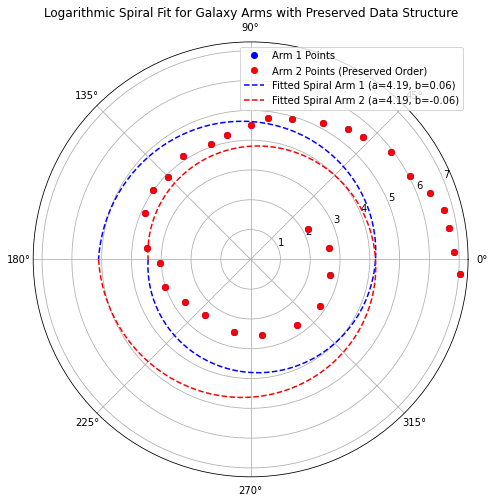

Fitted parameters for Arm 1: [4.1911375  0.06277888]
Fitted parameters for Arm 2: [ 4.19113615 -0.06277937]


In [41]:

# Convert Cartesian coordinates to polar coordinates
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Logarithmic spiral function
def logarithmic_spiral(theta, a, b):
    return a * np.exp(b * theta)

# Define the initial orientation based on the first three points
def calculate_initial_orientation(x, y):
    r_initial, theta_initial = cartesian_to_polar(x[:3], y[:3])
    avg_theta = np.mean(theta_initial)
    return avg_theta

# Calculate initial orientations for each arm
initial_theta_arm1 = calculate_initial_orientation(data_arm1['x'], data_arm1['y'])
initial_theta_arm2 = calculate_initial_orientation(data_arm2['x'], data_arm2['y'])

# Convert data to polar coordinates without reordering
r_arm1, theta_arm1 = cartesian_to_polar(data_arm1['x'], data_arm1['y'])
r_arm2, theta_arm2 = cartesian_to_polar(data_arm2['x'], data_arm2['y'])

# Fit the logarithmic spiral to Arm 1
params_arm1, _ = curve_fit(logarithmic_spiral, theta_arm1, r_arm1, p0=[1, 0.1])

# Fit the logarithmic spiral to Arm 2 with opposite orientation
params_arm2, _ = curve_fit(logarithmic_spiral, -theta_arm2, r_arm2, p0=[1, 0.1])

# Generate fitted curves for visualization
theta_fit = np.linspace(-np.pi, np.pi, 500)
r_fit_arm1 = logarithmic_spiral(theta_fit, *params_arm1)
r_fit_arm2 = logarithmic_spiral(theta_fit, *params_arm2)

# Plot the original points and fitted spirals with preserved data order
plt.figure(figsize=(10, 8))
plt.polar(theta_arm1, r_arm1, 'bo', label='Arm 1 Points')
plt.polar(theta_arm2, r_arm2, 'ro', label='Arm 2 Points (Preserved Order)')
plt.polar(theta_fit, r_fit_arm1, 'b--', label=f'Fitted Spiral Arm 1 (a={params_arm1[0]:.2f}, b={params_arm1[1]:.2f})')
plt.polar(theta_fit, r_fit_arm2, 'r--', label=f'Fitted Spiral Arm 2 (a={params_arm2[0]:.2f}, b={params_arm2[1]:.2f})')
plt.title("Logarithmic Spiral Fit for Galaxy Arms with Preserved Data Structure")
plt.legend(loc='upper right')
plt.show()

# Display the fitted parameters
print("Fitted parameters for Arm 1:", params_arm1)
print("Fitted parameters for Arm 2:", params_arm2)


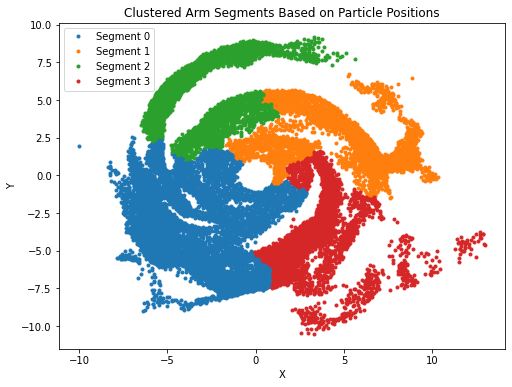

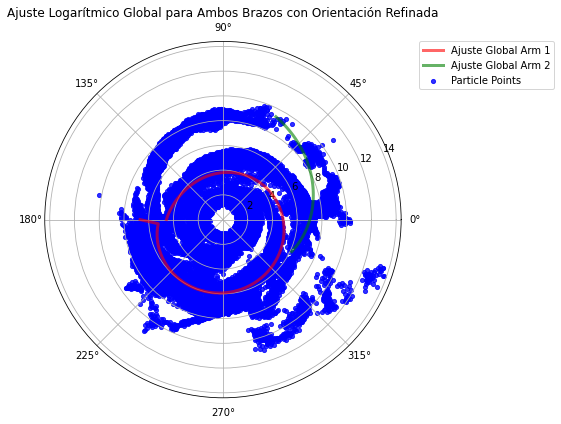

In [46]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import BayesianRidge
from sklearn.cluster import AgglomerativeClustering

# Define the logarithmic spiral function
def log_spiral(phi, A, B, N):
    safe_phi = np.clip(phi, 1e-6, None)  # Avoid problematic values for tan and log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Convert Cartesian coordinates to polar
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return r, phi

# Bayesian spiral fitting class
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None

    def fit(self, phi, r):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        self.bayesian_ridge.fit(X, r)
        self.A_, self.B_, self.N_ = self.bayesian_ridge.coef_

    def predict(self, phi, r_min, r_max):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        r_pred = self.bayesian_ridge.predict(X)
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]

# Load data for particles
data_particles = pd.read_csv('../DATA/processed/TracingPoints/data_rho_11_filtered.csv')
x_values, y_values = data_particles['x'].values, data_particles['y'].values
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Cluster segments by orientation using Cartesian coordinates (x, y)
pixels = np.column_stack((x_values, y_values))
clustering = AgglomerativeClustering(n_clusters=4).fit(pixels)

# Plot clustered arm segments with orientation
plt.figure(figsize=(8, 6))
for cluster_id in np.unique(clustering.labels_):
    cluster_points = pixels[clustering.labels_ == cluster_id]
    plt.plot(cluster_points[:, 0], cluster_points[:, 1], '.', label=f"Segment {cluster_id}")
plt.legend()
plt.title("Clustered Arm Segments Based on Particle Positions")
plt.xlabel("X")
plt.ylabel("Y")
plt.show()

# Perform Bayesian fitting for each main cluster (assuming 0 and 1 represent different arms)
arm1_indices = clustering.labels_ == 0
arm2_indices = clustering.labels_ == 1

# Fit for Arm 1
phi_arm1, r_arm1 = phi_values[arm1_indices], r_values[arm1_indices]
bayesian_spiral_arm1 = BayesianSpiralFitter()
bayesian_spiral_arm1.fit(phi_arm1, r_arm1)

# Predict for Arm 1
phi_fit_arm1 = np.linspace(np.min(phi_arm1), np.max(phi_arm1), 100)
r_fit_arm1, phi_fit_filtered_arm1 = bayesian_spiral_arm1.predict(phi_fit_arm1, np.percentile(r_arm1, 2.5), np.percentile(r_arm1, 97.5))

# Fit for Arm 2
phi_arm2, r_arm2 = phi_values[arm2_indices], r_values[arm2_indices]
bayesian_spiral_arm2 = BayesianSpiralFitter(alpha_1=1e-4, lambda_1=1e-4)
bayesian_spiral_arm2.fit(-phi_arm2, r_arm2)  # Invert for opposite direction

# Predict for Arm 2
phi_fit_arm2 = np.linspace(np.min(phi_arm2), np.max(phi_arm2), 100)
r_fit_arm2, phi_fit_filtered_arm2 = bayesian_spiral_arm2.predict(phi_fit_arm2, np.percentile(r_arm2, 2.5), np.percentile(r_arm2, 97.5))

# Combined Plot with Orientation
fig, ax_combined = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_combined.plot(phi_fit_filtered_arm1, r_fit_arm1, color='red', linewidth=3, alpha=0.6, label='Ajuste Global Arm 1')
ax_combined.plot(phi_fit_filtered_arm2, r_fit_arm2, color='green', linewidth=3, alpha=0.6, label='Ajuste Global Arm 2')
ax_combined.scatter(phi_values, r_values, s=17, alpha=0.8, color='blue', label="Particle Points")
ax_combined.set_title('Ajuste Logarítmico Global para Ambos Brazos con Orientación Refinada')
ax_combined.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()



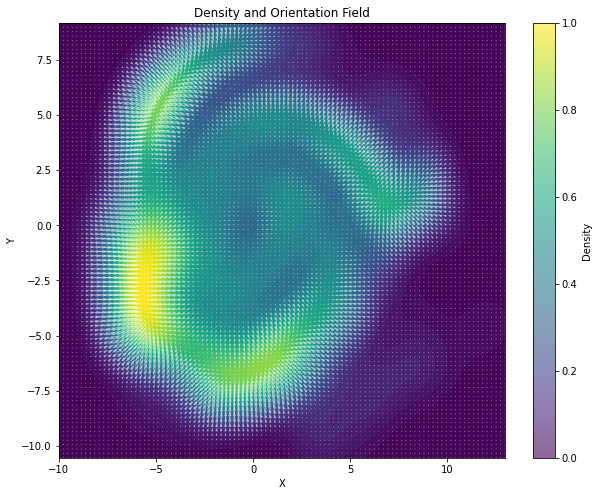

In [47]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import KernelDensity
from scipy.ndimage import gaussian_gradient_magnitude, sobel

# Load particle data
data_particles = pd.read_csv('../DATA/processed/TracingPoints/data_rho_11_filtered.csv')
x_values, y_values = data_particles['x'].values, data_particles['y'].values

# Estimate the density using Kernel Density Estimation (KDE)
# Define the grid
x_grid = np.linspace(x_values.min(), x_values.max(), 100)
y_grid = np.linspace(y_values.min(), y_values.max(), 100)
x_grid, y_grid = np.meshgrid(x_grid, y_grid)
grid_points = np.vstack([x_grid.ravel(), y_grid.ravel()]).T

# Apply KDE
kde = KernelDensity(bandwidth=1.0, kernel='gaussian')
kde.fit(np.vstack([x_values, y_values]).T)
log_density = kde.score_samples(grid_points)
density = np.exp(log_density).reshape(x_grid.shape)

# Calculate the gradient of the density to get the orientation field
grad_x = sobel(density, axis=1)  # Gradient along the x-axis
grad_y = sobel(density, axis=0)  # Gradient along the y-axis
orientation_field = np.arctan2(grad_y, grad_x)  # Orientation angle in radians

# Plot the density and orientation field
plt.figure(figsize=(10, 8))
plt.contourf(x_grid, y_grid, density, cmap='viridis', levels=50)
plt.quiver(x_grid, y_grid, grad_x, grad_y, color='white', alpha=0.6)
plt.title('Density and Orientation Field')
plt.xlabel('X')
plt.ylabel('Y')
plt.colorbar(label='Density')
plt.show()


In [57]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import Ridge
from scipy.interpolate import griddata
from scipy.ndimage import sobel
from sklearn.neighbors import KernelDensity

# Load particle data for arms
data_arm1 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
data_arm2 = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv')

# Extract coordinates for arms
x_values_arm1, y_values_arm1 = data_arm1['x'].values, data_arm1['y'].values
x_values_arm2, y_values_arm2 = data_arm2['x'].values, data_arm2['y'].values

# Create a grid for density estimation using both arms' data
x_values = np.concatenate([x_values_arm1, x_values_arm2])
y_values = np.concatenate([y_values_arm1, y_values_arm2])
x_grid = np.linspace(x_values.min(), x_values.max(), 100)
y_grid = np.linspace(y_values.min(), y_values.max(), 100)
x_grid, y_grid = np.meshgrid(x_grid, y_grid)
grid_points = np.vstack([x_grid.ravel(), y_grid.ravel()]).T

# Apply KDE to estimate density
kde = KernelDensity(bandwidth=1.0, kernel='gaussian')
kde.fit(np.vstack([x_values, y_values]).T)
log_density = kde.score_samples(grid_points)
density = np.exp(log_density).reshape(x_grid.shape)

# Calculate the gradient of the density to get the orientation field
grad_x = sobel(density, axis=1)  # Gradient along the x-axis
grad_y = sobel(density, axis=0)  # Gradient along the y-axis
orientation_field = np.arctan2(grad_y, grad_x)  # Orientation angle in radians

# Define logarithmic spiral function
def log_spiral(phi, A, B, N):
    return A / np.log(B * np.tan(phi / (2 * N)) + 1e-6)

# Ridge spiral fitting class with orientation guidance
class RidgeSpiralFitter:
    def __init__(self, alpha=1e-6):
        self.model = Ridge(alpha=alpha)
        self.A_ = None
        self.B_ = None
        self.N_ = None

    def fit(self, phi, r, orientation_weights):
        # Use weights based on orientation alignment
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        self.model.fit(X, r, sample_weight=orientation_weights)
        self.A_, self.B_, self.N_ = self.model.coef_

    def predict(self, phi):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        return self.model.predict(X)

# Calculate orientation weights based on alignment with the field
def calculate_orientation_weights(x_values, y_values, grad_x, grad_y, x_grid, y_grid):
    weights = []
    for x, y in zip(x_values, y_values):
        # Find nearest grid point indices for the (x, y) position
        x_idx = np.abs(x_grid[0, :] - x).argmin()
        y_idx = np.abs(y_grid[:, 0] - y).argmin()
        
        # Calculate local orientation at the grid point
        local_orientation = np.arctan2(grad_y[y_idx, x_idx], grad_x[y_idx, x_idx])
        
        # Calculate weight as the alignment of the local orientation with the radial direction
        radial_orientation = np.arctan2(y, x)
        weight = np.cos(local_orientation - radial_orientation)
        weights.append(max(weight, 0))  # Use only positive alignment
    return np.array(weights)

# Process arm 1
r_values_arm1, phi_values_arm1 = cartesian_to_polar(x_values_arm1, y_values_arm1)
orientation_weights_arm1 = calculate_orientation_weights(x_values_arm1, y_values_arm1, grad_x, grad_y, x_grid, y_grid)
ridge_spiral_arm1 = RidgeSpiralFitter()
ridge_spiral_arm1.fit(phi_values_arm1, r_values_arm1, orientation_weights_arm1)

# Predict adjusted data for Arm 1
phi_fit_arm1 = np.linspace(np.min(phi_values_arm1), np.max(phi_values_arm1), 100)
r_fit_arm1 = ridge_spiral_arm1.predict(phi_fit_arm1)

# Process arm 2
r_values_arm2, phi_values_arm2 = cartesian_to_polar(x_values_arm2, y_values_arm2)
orientation_weights_arm2 = calculate_orientation_weights(x_values_arm2, y_values_arm2, grad_x, grad_y, x_grid, y_grid)
ridge_spiral_arm2 = RidgeSpiralFitter(alpha=1e-4)  # Adjusted parameters for Arm 2
ridge_spiral_arm2.fit(-phi_values_arm2, r_values_arm2, orientation_weights_arm2)  # Invert phi for opposite direction

# Predict adjusted data for Arm 2
phi_fit_arm2 = np.linspace(np.min(phi_values_arm2), np.max(phi_values_arm2), 100)
r_fit_arm2 = ridge_spiral_arm2.predict(phi_fit_arm2)

# Plot both arms with orientation guidance
fig, ax_combined = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_combined.plot(phi_fit_arm1, r_fit_arm1, color='red', linewidth=3, alpha=0.6, label='Ajuste Arm 1')
ax_combined.plot(phi_fit_arm2, r_fit_arm2, color='green', linewidth=3, alpha=0.6, label='Ajuste Arm 2')
ax_combined.scatter(phi_values_arm1, r_values_arm1, s=17, alpha=0.8, color='blue', label="Arm 1 Points")
ax_combined.scatter(phi_values_arm2, r_values_arm2, s=17, alpha=0.8, color='orange', label="Arm 2 Points")
ax_combined.set_title('Ajuste Logarítmico Global para Ambos Brazos con Campo de Orientación')
ax_combined.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()






ZeroDivisionError: Weights sum to zero, can't be normalized

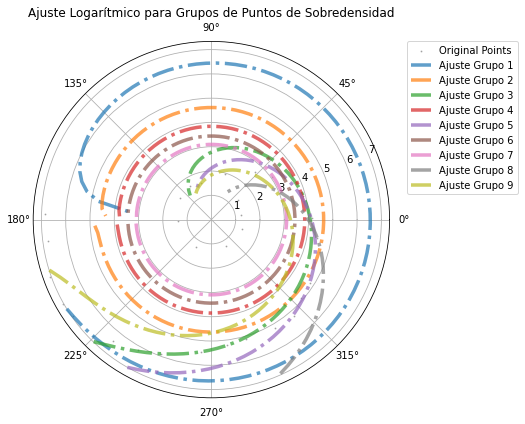

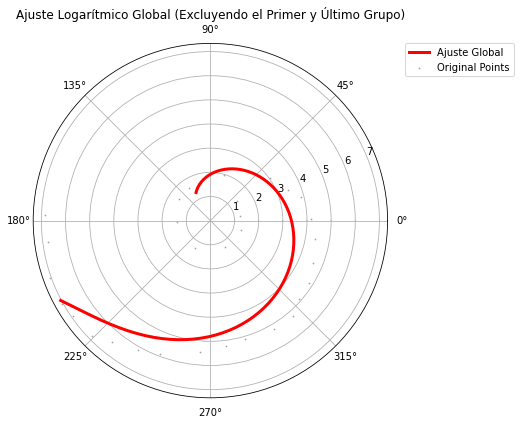

In [15]:
# Load data
data_arm = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')

# Extract x and y, then convert to polar coordinates
x_values = data_arm['x'].values
y_values = data_arm['y'].values
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Sort values by angle for better plotting
sorted_indices = np.argsort(phi_values)
r_values_sorted = r_values[sorted_indices]
phi_values_sorted = phi_values[sorted_indices]

# Define limits for the radius
r_min = np.percentile(r_values_sorted, 2.5)  # Avoiding closest points
r_max = np.percentile(r_values_sorted, 97.5)  # Avoiding farthest points

# Store points for global fit excluding the first and last groups
r_values_for_global = []
phi_values_for_global = []

# Function to divide points into groups of a given size
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]

# Bayesian spiral fitting class
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None

    def fit(self, phi, r):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        self.bayesian_ridge.fit(X, r)
        self.A_, self.B_, self.N_ = self.bayesian_ridge.coef_
        return self.bayesian_ridge.score(X, r)

    def predict(self, phi, r_min, r_max):
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / (2 * 3))])
        r_pred = self.bayesian_ridge.predict(X)
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]

# Fit and plot each subset of points
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax.scatter(phi_values_sorted, r_values_sorted, s=0.7, alpha=0.6, c='gray', label="Original Points")

for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_sorted, phi_values_sorted)):
    if len(r_group) < 3:
        continue
    if group_index == 0 or group_index == (len(r_values_sorted) // 3 - 1):
        continue

    r_values_for_global.extend(r_group)
    phi_values_for_global.extend(phi_group)

    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)

    phi_fit = np.linspace(np.min(phi_values_sorted), np.max(phi_values_sorted), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, r_min, r_max)
    
    ax.plot(phi_fit_filtered, r_fit, '-.', label=f'Ajuste Grupo {group_index}', linewidth=3.5, alpha=0.7)

ax.set_title('Ajuste Logarítmico para Grupos de Puntos de Sobredensidad')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Global fit excluding the first and last groups
r_values_for_global = np.array(r_values_for_global)
phi_values_for_global = np.array(phi_values_for_global)

bayesian_spiral_global = BayesianSpiralFitter()
bayesian_spiral_global.fit(phi_values_for_global, r_values_for_global)

phi_fit_global = np.linspace(np.min(phi_values), np.max(phi_values), 100)
r_fit_global, phi_fit_filtered_global = bayesian_spiral_global.predict(phi_fit_global, r_min, r_max)

fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_global.plot(phi_fit_filtered_global, r_fit_global, color='red', linewidth=3, label='Ajuste Global')
ax_global.scatter(phi_values_sorted, r_values_sorted, s=0.7, alpha=0.6, c='gray', label="Original Points")
ax_global.set_title('Ajuste Logarítmico Global (Excluyendo el Primer y Último Grupo)')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

In [14]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import skimage as ski
import cv2

from scipy import ndimage as ndi

from skimage import data, util, filters, color
from skimage.segmentation import watershed
from skimage.feature import peak_local_max


from scipy.optimize import curve_fit
from sklearn.linear_model import BayesianRidge

def read_data(id):
    # Leer el archivo de datos correspondiente al id de la galaxia
    file_path = f'../DATA/processed/TracingPoints/data_rho_{id}_filtered.csv'
    data = pd.read_csv(file_path)
    return data

def sort_by_delta_rho(data):
    # Ordenar las partículas por deltaRho en orden decreciente
    sorted_data = data.sort_values(by='deltaRho', ascending=False).reset_index(drop=True)
    return sorted_data

# Colores
h_alpha_color = '#DC143C'  # emisiones H-alpha - Carmesí o rojo


In [15]:
#funciones

def cartesian_to_polar(x, y):
    """
    Convert Cartesian coordinates (x, y) to polar coordinates (r, phi).
    
    Parameters:
    x : array-like
        x-coordinates.
    y : array-like
        y-coordinates.
    
    Returns:
    r : array-like
        Radial distance from the origin.
    phi : array-like
        Angle in radians.
    """
    # Calculate radial distance
    r = np.sqrt(x**2 + y**2)
    
    # Calculate the angle using atan2 (handles all quadrants)
    phi = np.arctan2(y, x)
    
    return r, phi


def polar_to_cartesian(r, phi):
    """
    Convert polar coordinates (r, phi) to Cartesian coordinates (x, y).
    
    Parameters:
    r : array-like
        Radial distance from the origin.
    phi : array-like
        Angle in radians.
    
    Returns:
    x : array-like
        x-coordinates.
    y : array-like
        y-coordinates.
    """
    x = r * np.cos(phi)
    y = r * np.sin(phi)
    
    return x, y

# Clase para el ajuste Bayesiano
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None
        self.r2_score_ = None

    def fit(self, phi, r):
        # Preprocesar los valores: φ, tan(φ/2), tan(φ/2N)
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / 2)])
        self.bayesian_ridge.fit(X, r)
        
        # Obtener los coeficientes ajustados
        self.A_ = self.bayesian_ridge.coef_[0]
        self.B_ = self.bayesian_ridge.coef_[1]
        self.N_ = self.bayesian_ridge.coef_[2]
        
        # Calcular el score R^2 para este ajuste
        self.r2_score_ = self.bayesian_ridge.score(X, r)
        return self.r2_score_

    def predict(self, phi, r_min, r_max):
        """
        Predecir los valores de r para un rango de φ dentro de r_min y r_max.
        Filtra los valores de r fuera del rango dado.
        """
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / 2)])
        r_pred = self.bayesian_ridge.predict(X)
        
        # Aplicar el filtro de r_min y r_max
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]  # Devuelve los valores de r y phi filtrados


# Dividir los puntos en subconjuntos de 3 en 3
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]


## nuevo intento

In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Función para cargar los datos
def read_data(id_halo, id_brazo):
    file_path = f'../DATA/processed/TracingPoints/arm_tracing_{id_halo}_arm{id_brazo}_rho_dani.csv'
    return pd.read_csv(file_path)

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return r, phi

# Definir la función logarítmica de la espiral
def log_spiral(phi, A, B, N):
    safe_phi = np.clip(phi, 1e-6, None)
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)


In [27]:
# Función para realizar el ajuste usando un ajustador bayesiano
def fit_global_spiral(phi_values, r_values, r_min, r_max):
    bayesian_spiral = BayesianSpiralFitter()
    r2_score = bayesian_spiral.fit(phi_values, r_values)
    phi_fit = np.linspace(np.min(phi_values), np.max(phi_values), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, r_min, r_max)
    return r_fit, phi_fit_filtered, r2_score, bayesian_spiral


In [28]:
# Función para graficar el ajuste
def plot_spiral(phi_values, r_values, r_fit, phi_fit_filtered, title):
    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
    ax.scatter(phi_values, r_values, s=0.7, alpha=0.6, c='gray')
    ax.plot(phi_fit_filtered, r_fit, label='Ajuste Global', color='red', linewidth=3)
    ax.set_title(title)
    plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
    plt.tight_layout()
    plt.show()


In [32]:
# Pipeline para procesar y ajustar el brazo espiral
def process_and_fit_spiral(id_halo, id_brazo):
    # Cargar datos
    data = read_data(id_halo, id_brazo)
    x_values = data['x'].values
    y_values = data['y'].values
    r_values, phi_values = cartesian_to_polar(x_values, y_values)

    # Filtrar los valores de r para el rango del ajuste global
    r_min = np.percentile(r_values, 2.5)
    r_max = np.percentile(r_values, 97.5)

    # Ajustar la espiral global excluyendo el primer y último grupo
    r_fit, phi_fit_filtered, r2_score, bayesian_spiral = fit_global_spiral(phi_values, r_values, r_min, r_max)

    # Graficar el ajuste global
    plot_spiral(phi_values, r_values, r_fit, phi_fit_filtered, 'Ajuste Logarítmico Global (Excluyendo el Primer y Último Grupo)')
    print(f"Score R^2 del ajuste global: {r2_score}")
    return bayesian_spiral


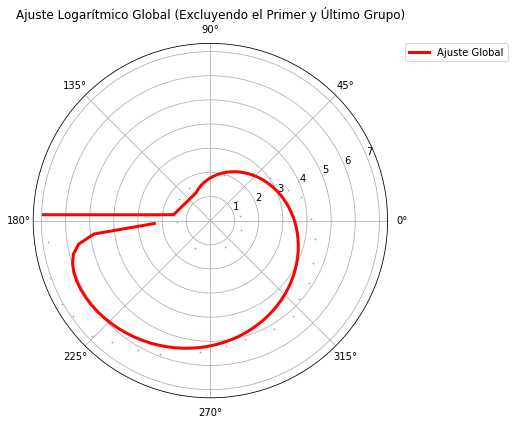

Score R^2 del ajuste global: 0.606153526676966


In [33]:
# Ejecutar para un halo específico
bayesian_spiral_11 = process_and_fit_spiral(11, 1)

# Ejecutar para otro halo, si es necesario
# bayesian_spiral_17 = process_and_fit_spiral(17)



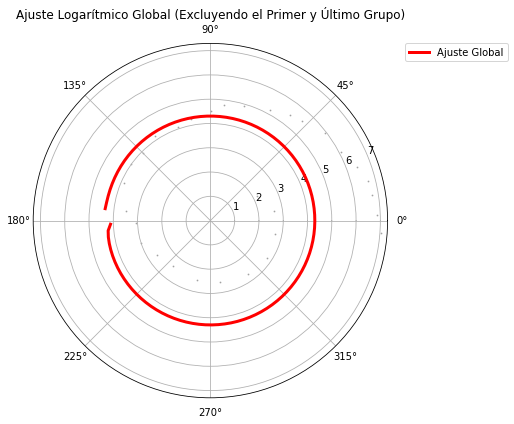

Score R^2 del ajuste global: 0.007027343134070719


In [34]:
# Ejecutar para un halo específico
bayesian_spiral_11 = process_and_fit_spiral(11, 2)

# Ejecutar para otro halo, si es necesario
# bayesian_spiral_17 = process_and_fit_spiral(17)

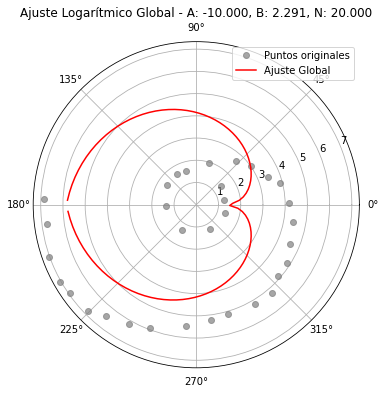

In [37]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Cargar datos y convertir a coordenadas polares
data_arm = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')
x_values = data_arm['x'].values
y_values = data_arm['y'].values

def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

r_values, theta_values = cartesian_to_polar(x_values, y_values)

# Función espiral para ajuste
def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Encontrar el r máximo y mínimo global
r_min = np.percentile(r_values, 2.5)
r_max = np.percentile(r_values, 97.5)

try:
    # Ajuste con curve_fit sobre todos los datos
    popt, _ = curve_fit(
        custom_spiral, theta_values, r_values,
        p0=[0.1, 0.63, 4],
        bounds=((-10, 0.001, 0.1), (20, 20, 20)),
        maxfev=10000
    )
    A_fit, B_fit, N_fit = popt

    # Generar theta para el rango relevante de los datos
    theta_fit = np.linspace(np.min(theta_values), np.max(theta_values), 100)
    r_fit = custom_spiral(theta_fit, A_fit, B_fit, N_fit)

    # Filtrar r_fit dentro del rango de [r_min, r_max]
    r_fit_filtered = r_fit[(r_fit >= r_min) & (r_fit <= r_max)]
    theta_fit_filtered = theta_fit[(r_fit >= r_min) & (r_fit <= r_max)]

    # Graficar el ajuste global
    plt.figure(figsize=(6, 6))
    ax = plt.subplot(111, projection='polar')
    ax.plot(theta_values, r_values, 'o', color='gray', label='Puntos originales', alpha=0.7)
    ax.plot(theta_fit_filtered, r_fit_filtered, '-', color='red', label='Ajuste Global')
    plt.title(f"Ajuste Logarítmico Global - A: {A_fit:.3f}, B: {B_fit:.3f}, N: {N_fit:.3f}")
    plt.legend()
    plt.show()

except RuntimeError:
    print("Error en el ajuste global. Parámetros no encontrados.")

    


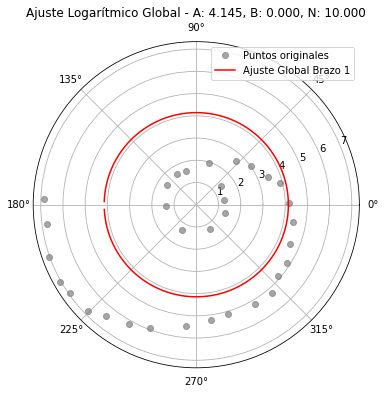

In [40]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Función de la espiral logarítmica
def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

# Función para ajustar espiral logarítmica y graficar el ajuste
def fit_log_spiral(data_file, arm_label):
    # Cargar datos
    data_arm = pd.read_csv(data_file)
    x_values = data_arm['x'].values
    y_values = data_arm['y'].values

    # Convertir a coordenadas polares
    r_values, theta_values = cartesian_to_polar(x_values, y_values)

    # Definir los límites de r para restringir el ajuste a los datos observados
    r_min = np.percentile(r_values, 2.5)
    r_max = np.percentile(r_values, 97.5)

    try:
        # Ajuste con curve_fit sobre todos los datos
        popt, _ = curve_fit(
            log_spiral, theta_values, r_values,
            p0=[0.5, 0.2, 2],
            bounds=((0, 0, 0.1), (10, 10, 10)),
            maxfev=10000
        )
        A_fit, B_fit, N_fit = popt

        # Generar theta para el rango relevante de los datos
        theta_fit = np.linspace(np.min(theta_values), np.max(theta_values), 500)
        r_fit = log_spiral(theta_fit, A_fit, B_fit, N_fit)

        # Filtrar r_fit dentro del rango [r_min, r_max]
        r_fit_filtered = r_fit[(r_fit >= r_min) & (r_fit <= r_max)]
        theta_fit_filtered = theta_fit[(r_fit >= r_min) & (r_fit <= r_max)]

        # Graficar el ajuste global
        plt.figure(figsize=(6, 6))
        ax = plt.subplot(111, projection='polar')
        ax.plot(theta_values, r_values, 'o', color='gray', label='Puntos originales', alpha=0.7)
        ax.plot(theta_fit_filtered, r_fit_filtered, '-', color='red', label=f'Ajuste Global {arm_label}')
        plt.title(f"Ajuste Logarítmico Global - A: {A_fit:.3f}, B: {B_fit:.3f}, N: {N_fit:.3f}")
        plt.legend()
        plt.show()

    except RuntimeError:
        print(f"Error al ajustar el brazo {arm_label}. Parámetros no encontrados.")

# Aplicar el ajuste a diferentes subhalos o brazos
fit_log_spiral('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv', 'Brazo 1')
# fit_log_spiral('ruta_a_otro_brazo.csv', 'Brazo 2') # Descomenta y cambia la ruta para otros brazos



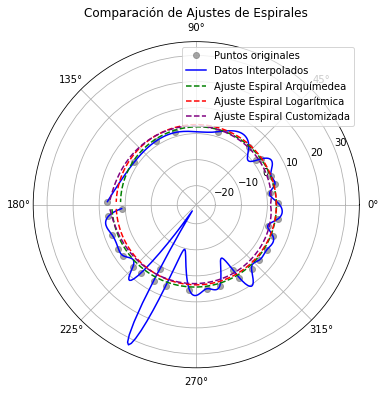

Parámetros de ajuste:
Espiral Arquímedea: [ 3.46020325 -0.53800793]
Espiral Logarítmica: [3.45563442e+00 2.58782983e-10 9.99999986e+00]
Espiral Customizada: [-10.           0.04271012   1.15068999]


In [41]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.optimize import curve_fit

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para interpolar los datos
def interpolate_data(r_values, theta_values, num_points=500):
    theta_interp = np.linspace(np.min(theta_values), np.max(theta_values), num_points)
    interp_func = interp1d(theta_values, r_values, kind='cubic')
    r_interp = interp_func(theta_interp)
    return r_interp, theta_interp

# Función para realizar ajustes con diferentes modelos
def fit_spirals(r_values, theta_values):
    # Interpolación
    r_interp, theta_interp = interpolate_data(r_values, theta_values)

    # Ajuste con la espiral arquimedeana
    popt_arch, _ = curve_fit(archimedean_spiral, theta_interp, r_interp, p0=[1, 0.1])

    # Ajuste con la espiral logarítmica
    popt_log, _ = curve_fit(log_spiral, theta_interp, r_interp, p0=[0.5, 0.2, 2], bounds=((0, 0, 0.1), (10, 10, 10)))

    # Ajuste con la espiral personalizada
    popt_custom, _ = curve_fit(custom_spiral, theta_interp, r_interp, p0=[0.5, 0.2, 2], bounds=((-10, 0.001, 0.1), (20, 20, 20)))

    # Generación de valores ajustados para cada modelo
    r_fit_arch = archimedean_spiral(theta_interp, *popt_arch)
    r_fit_log = log_spiral(theta_interp, *popt_log)
    r_fit_custom = custom_spiral(theta_interp, *popt_custom)

    # Graficar resultados de cada ajuste
    plt.figure(figsize=(6, 6))
    ax = plt.subplot(111, projection='polar')
    ax.plot(theta_values, r_values, 'o', color='gray', label='Puntos originales', alpha=0.7)
    ax.plot(theta_interp, r_interp, '-', color='blue', label='Datos Interpolados')
    ax.plot(theta_interp, r_fit_arch, '--', color='green', label='Ajuste Espiral Arquímedea')
    ax.plot(theta_interp, r_fit_log, '--', color='red', label='Ajuste Espiral Logarítmica')
    ax.plot(theta_interp, r_fit_custom, '--', color='purple', label='Ajuste Espiral Customizada')
    
    plt.title("Comparación de Ajustes de Espirales")
    plt.legend()
    plt.show()

    # Devolver los parámetros de ajuste para análisis
    return {
        'archimedean': popt_arch,
        'logarithmic': popt_log,
        'custom': popt_custom
    }

# Cargar datos y realizar el ajuste
data_file = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
data_arm = pd.read_csv(data_file)
x_values = data_arm['x'].values
y_values = data_arm['y'].values
r_values, theta_values = cartesian_to_polar(x_values, y_values)

# Realizar el ajuste y comparar los modelos
fit_results = fit_spirals(r_values, theta_values)

# Mostrar los parámetros ajustados
print("Parámetros de ajuste:")
print("Espiral Arquímedea:", fit_results['archimedean'])
print("Espiral Logarítmica:", fit_results['logarithmic'])
print("Espiral Customizada:", fit_results['custom'])


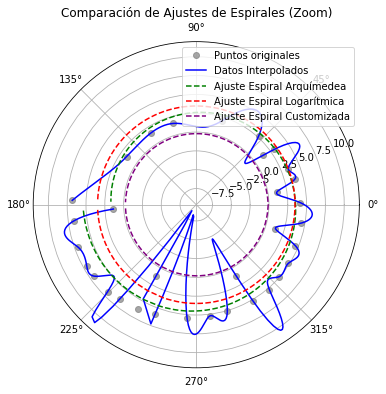

Parámetros de ajuste:
Espiral Arquímedea: [ 3.53635044 -0.59196968]
Espiral Logarítmica: [3.46481302e+00 1.52838751e-12 1.00000000e+01]
Espiral Customizada: [ 1.   0.1 10. ]


In [43]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.optimize import curve_fit

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para interpolar los datos
def interpolate_data(r_values, theta_values, num_points=500):
    theta_interp = np.linspace(np.min(theta_values), np.max(theta_values), num_points)
    interp_func = interp1d(theta_values, r_values, kind='cubic')
    r_interp = interp_func(theta_interp)
    return r_interp, theta_interp

# Función para realizar ajustes con diferentes modelos
def fit_spirals(r_values, theta_values):
    # Interpolación
    r_interp, theta_interp = interpolate_data(r_values, theta_values)

    # Filtrar para enfocarse en un rango confiable
    r_min, r_max = np.percentile(r_interp, 2.5), np.percentile(r_interp, 97.5)
    mask = (r_interp >= r_min) & (r_interp <= r_max)
    theta_interp_filtered = theta_interp[mask]
    r_interp_filtered = r_interp[mask]

    # Ajuste con la espiral arquimedeana
    popt_arch, _ = curve_fit(archimedean_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.1])

    # Ajuste con la espiral logarítmica
    popt_log, _ = curve_fit(log_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.05, 2], bounds=((0, 0, 0.1), (50, 10, 10)))

    # Ajuste con la espiral personalizada
    popt_custom, _ = curve_fit(custom_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.5, 4], bounds=((1, 0.1, 0.5), (30, 5, 10)))

    # Generación de valores ajustados para cada modelo
    r_fit_arch = archimedean_spiral(theta_interp_filtered, *popt_arch)
    r_fit_log = log_spiral(theta_interp_filtered, *popt_log)
    r_fit_custom = custom_spiral(theta_interp_filtered, *popt_custom)

    # Graficar resultados de cada ajuste con zoom en el rango confiable
    plt.figure(figsize=(6, 6))
    ax = plt.subplot(111, projection='polar')
    ax.plot(theta_values, r_values, 'o', color='gray', label='Puntos originales', alpha=0.7)
    ax.plot(theta_interp_filtered, r_interp_filtered, '-', color='blue', label='Datos Interpolados')
    ax.plot(theta_interp_filtered, r_fit_arch, '--', color='green', label='Ajuste Espiral Arquímedea')
    ax.plot(theta_interp_filtered, r_fit_log, '--', color='red', label='Ajuste Espiral Logarítmica')
    ax.plot(theta_interp_filtered, r_fit_custom, '--', color='purple', label='Ajuste Espiral Customizada')
    
    plt.title("Comparación de Ajustes de Espirales (Zoom)")
    plt.legend(loc = 'upper right')
    plt.show()

    # Devolver los parámetros de ajuste para análisis
    return {
        'archimedean': popt_arch,
        'logarithmic': popt_log,
        'custom': popt_custom
    }

# Cargar datos y realizar el ajuste
data_file = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
data_arm = pd.read_csv(data_file)
x_values = data_arm['x'].values
y_values = data_arm['y'].values
r_values, theta_values = cartesian_to_polar(x_values, y_values)

# Realizar el ajuste y comparar los modelos
fit_results = fit_spirals(r_values, theta_values)

# Mostrar los parámetros ajustados
print("Parámetros de ajuste:")
print("Espiral Arquímedea:", fit_results['archimedean'])
print("Espiral Logarítmica:", fit_results['logarithmic'])
print("Espiral Customizada:", fit_results['custom'])


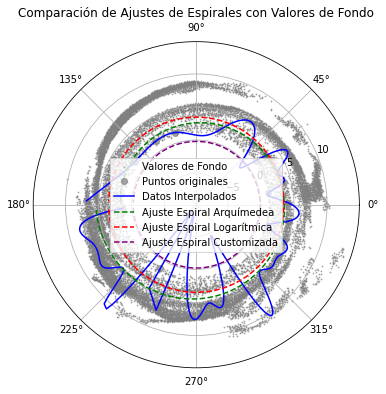

Parámetros de ajuste:
Espiral Arquímedea: [ 3.53635044 -0.59196968]
Espiral Logarítmica: [3.46481302e+00 1.52838751e-12 1.00000000e+01]
Espiral Customizada: [ 1.   0.1 10. ]


In [44]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.optimize import curve_fit

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para interpolar los datos
def interpolate_data(r_values, theta_values, num_points=500):
    theta_interp = np.linspace(np.min(theta_values), np.max(theta_values), num_points)
    interp_func = interp1d(theta_values, r_values, kind='cubic')
    r_interp = interp_func(theta_interp)
    return r_interp, theta_interp

# Función para realizar ajustes con diferentes modelos y graficar
def fit_spirals(r_values, theta_values, background_file):
    # Interpolación
    r_interp, theta_interp = interpolate_data(r_values, theta_values)

    # Cargar los datos de fondo
    background_data = pd.read_csv(background_file)
    x_background = background_data['x'].values
    y_background = background_data['y'].values
    r_background, theta_background = cartesian_to_polar(x_background, y_background)

    # Filtrar para enfocarse en un rango confiable
    r_min, r_max = np.percentile(r_interp, 2.5), np.percentile(r_interp, 97.5)
    mask = (r_interp >= r_min) & (r_interp <= r_max)
    theta_interp_filtered = theta_interp[mask]
    r_interp_filtered = r_interp[mask]

    # Ajuste con la espiral arquimedeana
    popt_arch, _ = curve_fit(archimedean_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.1])

    # Ajuste con la espiral logarítmica
    popt_log, _ = curve_fit(log_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.05, 2], bounds=((0, 0, 0.1), (50, 10, 10)))

    # Ajuste con la espiral personalizada
    popt_custom, _ = curve_fit(custom_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.5, 4], bounds=((1, 0.1, 0.5), (30, 5, 10)))

    # Generación de valores ajustados para cada modelo
    r_fit_arch = archimedean_spiral(theta_interp_filtered, *popt_arch)
    r_fit_log = log_spiral(theta_interp_filtered, *popt_log)
    r_fit_custom = custom_spiral(theta_interp_filtered, *popt_custom)

    # Graficar resultados de cada ajuste con zoom en el rango confiable y agregar fondo
    plt.figure(figsize=(6, 6))
    ax = plt.subplot(111, projection='polar')
    ax.scatter(theta_background, r_background, s=0.7, alpha=0.6, color='gray', label='Valores de Fondo')
    ax.plot(theta_values, r_values, 'o', color='gray', label='Puntos originales', alpha=0.7)
    ax.plot(theta_interp_filtered, r_interp_filtered, '-', color='blue', label='Datos Interpolados')
    ax.plot(theta_interp_filtered, r_fit_arch, '--', color='green', label='Ajuste Espiral Arquímedea')
    ax.plot(theta_interp_filtered, r_fit_log, '--', color='red', label='Ajuste Espiral Logarítmica')
    ax.plot(theta_interp_filtered, r_fit_custom, '--', color='purple', label='Ajuste Espiral Customizada')
    
    plt.title("Comparación de Ajustes de Espirales con Valores de Fondo")
    plt.legend()
    plt.show()

    # Devolver los parámetros de ajuste para análisis
    return {
        'archimedean': popt_arch,
        'logarithmic': popt_log,
        'custom': popt_custom
    }

# Cargar datos y realizar el ajuste
data_file = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
background_file = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'
data_arm = pd.read_csv(data_file)
x_values = data_arm['x'].values
y_values = data_arm['y'].values
r_values, theta_values = cartesian_to_polar(x_values, y_values)

# Realizar el ajuste y comparar los modelos
fit_results = fit_spirals(r_values, theta_values, background_file)

# Mostrar los parámetros ajustados
print("Parámetros de ajuste:")
print("Espiral Arquímedea:", fit_results['archimedean'])
print("Espiral Logarítmica:", fit_results['logarithmic'])
print("Espiral Customizada:", fit_results['custom'])


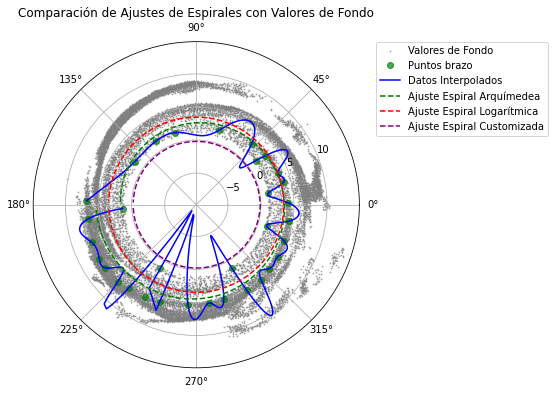

Parámetros de ajuste:
Espiral Arquímedea: [ 3.53635044 -0.59196968]
Espiral Logarítmica: [3.46481302e+00 1.52838751e-12 1.00000000e+01]
Espiral Customizada: [ 1.   0.1 10. ]


In [47]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.optimize import curve_fit

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para interpolar los datos
def interpolate_data(r_values, theta_values, num_points=500):
    theta_interp = np.linspace(np.min(theta_values), np.max(theta_values), num_points)
    interp_func = interp1d(theta_values, r_values, kind='cubic')
    r_interp = interp_func(theta_interp)
    return r_interp, theta_interp

# Función para realizar ajustes con diferentes modelos y graficar
def fit_spirals(r_values, theta_values, background_file):
    # Interpolación
    r_interp, theta_interp = interpolate_data(r_values, theta_values)

    # Cargar los datos de fondo
    background_data = pd.read_csv(background_file)
    x_background = background_data['x'].values
    y_background = background_data['y'].values
    r_background, theta_background = cartesian_to_polar(x_background, y_background)

    # Filtrar para enfocarse en un rango confiable
    r_min, r_max = np.percentile(r_interp, 2.5), np.percentile(r_interp, 97.5)
    mask = (r_interp >= r_min) & (r_interp <= r_max)
    theta_interp_filtered = theta_interp[mask]
    r_interp_filtered = r_interp[mask]

    # Ajuste con la espiral arquimedeana
    popt_arch, _ = curve_fit(archimedean_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.1])

    # Ajuste con la espiral logarítmica
    popt_log, _ = curve_fit(log_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.05, 2], bounds=((0, 0, 0.1), (50, 10, 10)))

    # Ajuste con la espiral personalizada
    popt_custom, _ = curve_fit(custom_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.5, 4], bounds=((1, 0.1, 0.5), (30, 5, 10)))

    # Generación de valores ajustados para cada modelo
    r_fit_arch = archimedean_spiral(theta_interp_filtered, *popt_arch)
    r_fit_log = log_spiral(theta_interp_filtered, *popt_log)
    r_fit_custom = custom_spiral(theta_interp_filtered, *popt_custom)

    # Graficar resultados de cada ajuste con zoom en el rango confiable y agregar fondo
    plt.figure(figsize=(6, 6))
    ax = plt.subplot(111, projection='polar')
    ax.scatter(theta_background, r_background, s=0.7, alpha=0.6, color='gray', label='Valores de Fondo')
    ax.plot(theta_values, r_values, 'o', color='green', label='Puntos brazo', alpha=0.7)
    ax.plot(theta_interp_filtered, r_interp_filtered, '-', color='blue', label='Datos Interpolados')
    ax.plot(theta_interp_filtered, r_fit_arch, '--', color='green', label='Ajuste Espiral Arquímedea')
    ax.plot(theta_interp_filtered, r_fit_log, '--', color='red', label='Ajuste Espiral Logarítmica')
    ax.plot(theta_interp_filtered, r_fit_custom, '--', color='purple', label='Ajuste Espiral Customizada')
    
    plt.title("Comparación de Ajustes de Espirales con Valores de Fondo")
    plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
    plt.show()

    # Devolver los parámetros de ajuste para análisis
    return {
        'archimedean': popt_arch,
        'logarithmic': popt_log,
        'custom': popt_custom
    }

# Cargar datos y realizar el ajuste
data_file = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
background_file = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'
data_arm = pd.read_csv(data_file)
x_values = data_arm['x'].values
y_values = data_arm['y'].values
r_values, theta_values = cartesian_to_polar(x_values, y_values)

# Realizar el ajuste y comparar los modelos
fit_results = fit_spirals(r_values, theta_values, background_file)

# Mostrar los parámetros ajustados
print("Parámetros de ajuste:")
print("Espiral Arquímedea:", fit_results['archimedean'])
print("Espiral Logarítmica:", fit_results['logarithmic'])
print("Espiral Customizada:", fit_results['custom'])


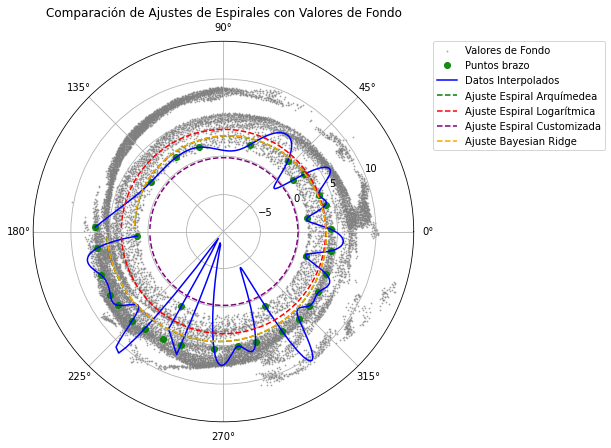

Parámetros de ajuste:
Espiral Arquímedea: [ 3.53635044 -0.59196968]
Espiral Logarítmica: [3.46481302e+00 1.52838751e-12 1.00000000e+01]
Espiral Customizada: [ 1.   0.1 10. ]
Coeficiente Bayesian Ridge: [-0.5826054]


In [51]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.optimize import curve_fit
from sklearn.linear_model import BayesianRidge

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para interpolar los datos
def interpolate_data(r_values, theta_values, num_points=500):
    theta_interp = np.linspace(np.min(theta_values), np.max(theta_values), num_points)
    interp_func = interp1d(theta_values, r_values, kind='cubic')
    r_interp = interp_func(theta_interp)
    return r_interp, theta_interp

# Función para realizar ajustes con diferentes modelos y graficar
def fit_spirals(r_values, theta_values, background_file):
    # Interpolación
    r_interp, theta_interp = interpolate_data(r_values, theta_values)

    # Cargar los datos de fondo
    background_data = pd.read_csv(background_file)
    x_background = background_data['x'].values
    y_background = background_data['y'].values
    r_background, theta_background = cartesian_to_polar(x_background, y_background)

    # Filtrar para enfocarse en un rango confiable
    r_min, r_max = np.percentile(r_interp, 2.5), np.percentile(r_interp, 97.5)
    mask = (r_interp >= r_min) & (r_interp <= r_max)
    theta_interp_filtered = theta_interp[mask]
    r_interp_filtered = r_interp[mask]

    # Ajuste con la espiral arquimedeana
    popt_arch, _ = curve_fit(archimedean_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.1])

    # Ajuste con la espiral logarítmica
    popt_log, _ = curve_fit(log_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.05, 2], bounds=((0, 0, 0.1), (50, 10, 10)))

    # Ajuste con la espiral personalizada
    popt_custom, _ = curve_fit(custom_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.5, 4], bounds=((1, 0.1, 0.5), (30, 5, 10)))

    # Ajuste con Bayesian Ridge Regression
    bayesian_ridge = BayesianRidge()
    theta_interp_filtered_reshaped = theta_interp_filtered.reshape(-1, 1)
    bayesian_ridge.fit(theta_interp_filtered_reshaped, r_interp_filtered)
    r_fit_bayesian = bayesian_ridge.predict(theta_interp_filtered_reshaped)

    # Generación de valores ajustados para cada modelo
    r_fit_arch = archimedean_spiral(theta_interp_filtered, *popt_arch)
    r_fit_log = log_spiral(theta_interp_filtered, *popt_log)
    r_fit_custom = custom_spiral(theta_interp_filtered, *popt_custom)

    # Graficar resultados de cada ajuste con zoom en el rango confiable y agregar fondo
    plt.figure(figsize=(7, 7))
    ax = plt.subplot(111, projection='polar')
    ax.scatter(theta_background, r_background, s=0.7, alpha=0.6, color='gray', label='Valores de Fondo')
    ax.plot(theta_values, r_values, 'o', color='green', label='Puntos brazo', alpha=0.9)
    ax.plot(theta_interp_filtered, r_interp_filtered, '-', color='blue', label='Datos Interpolados')
    ax.plot(theta_interp_filtered, r_fit_arch, '--', color='green', label='Ajuste Espiral Arquímedea')
    ax.plot(theta_interp_filtered, r_fit_log, '--', color='red', label='Ajuste Espiral Logarítmica')
    ax.plot(theta_interp_filtered, r_fit_custom, '--', color='purple', label='Ajuste Espiral Customizada')
    ax.plot(theta_interp_filtered, r_fit_bayesian, '--', color='orange', label='Ajuste Bayesian Ridge')
    
    plt.title("Comparación de Ajustes de Espirales con Valores de Fondo")
    plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
    plt.show()

    # Devolver los parámetros de ajuste para análisis
    return {
        'archimedean': popt_arch,
        'logarithmic': popt_log,
        'custom': popt_custom,
        'bayesian_ridge': bayesian_ridge.coef_
    }

# Cargar datos y realizar el ajuste
data_file = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
background_file = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'
data_arm = pd.read_csv(data_file)
x_values = data_arm['x'].values
y_values = data_arm['y'].values
r_values, theta_values = cartesian_to_polar(x_values, y_values)

# Realizar el ajuste y comparar los modelos
fit_results = fit_spirals(r_values, theta_values, background_file)

# Mostrar los parámetros ajustados
print("Parámetros de ajuste:")
print("Espiral Arquímedea:", fit_results['archimedean'])
print("Espiral Logarítmica:", fit_results['logarithmic'])
print("Espiral Customizada:", fit_results['custom'])
print("Coeficiente Bayesian Ridge:", fit_results['bayesian_ridge'])


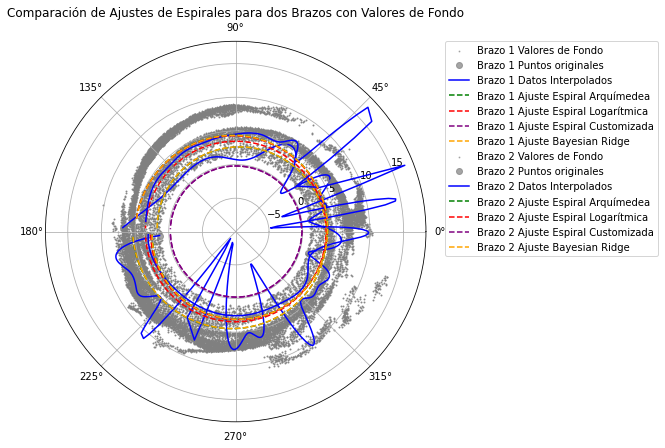

Parámetros de ajuste para Brazo 1:
Espiral Arquímedea: [ 3.53635044 -0.59196968]
Espiral Logarítmica: [3.46481302e+00 1.52838751e-12 1.00000000e+01]
Espiral Customizada: [ 1.   0.1 10. ]
Coeficiente Bayesian Ridge: [-0.5826054]

Parámetros de ajuste para Brazo 2:
Espiral Arquímedea: [3.71529648 0.40389409]
Espiral Logarítmica: [3.65882689 0.38645962 1.94042982]
Espiral Customizada: [ 1.   0.1 10. ]
Coeficiente Bayesian Ridge: [0.39617903]


In [52]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.optimize import curve_fit
from sklearn.linear_model import BayesianRidge

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para interpolar los datos
def interpolate_data(r_values, theta_values, num_points=500):
    theta_interp = np.linspace(np.min(theta_values), np.max(theta_values), num_points)
    interp_func = interp1d(theta_values, r_values, kind='cubic')
    r_interp = interp_func(theta_interp)
    return r_interp, theta_interp

# Función para realizar ajustes con diferentes modelos y graficar
def fit_and_plot_spirals(r_values, theta_values, background_file, ax, label_prefix=""):
    # Interpolación
    r_interp, theta_interp = interpolate_data(r_values, theta_values)

    # Cargar los datos de fondo
    background_data = pd.read_csv(background_file)
    x_background = background_data['x'].values
    y_background = background_data['y'].values
    r_background, theta_background = cartesian_to_polar(x_background, y_background)

    # Filtrar para enfocarse en un rango confiable
    r_min, r_max = np.percentile(r_interp, 2.5), np.percentile(r_interp, 97.5)
    mask = (r_interp >= r_min) & (r_interp <= r_max)
    theta_interp_filtered = theta_interp[mask]
    r_interp_filtered = r_interp[mask]

    # Ajuste con la espiral arquimedeana
    popt_arch, _ = curve_fit(archimedean_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.1])

    # Ajuste con la espiral logarítmica
    popt_log, _ = curve_fit(log_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.05, 2], bounds=((0, 0, 0.1), (50, 10, 10)))

    # Ajuste con la espiral personalizada
    popt_custom, _ = curve_fit(custom_spiral, theta_interp_filtered, r_interp_filtered, p0=[10, 0.5, 4], bounds=((1, 0.1, 0.5), (30, 5, 10)))

    # Ajuste con Bayesian Ridge Regression
    bayesian_ridge = BayesianRidge()
    theta_interp_filtered_reshaped = theta_interp_filtered.reshape(-1, 1)
    bayesian_ridge.fit(theta_interp_filtered_reshaped, r_interp_filtered)
    r_fit_bayesian = bayesian_ridge.predict(theta_interp_filtered_reshaped)

    # Generación de valores ajustados para cada modelo
    r_fit_arch = archimedean_spiral(theta_interp_filtered, *popt_arch)
    r_fit_log = log_spiral(theta_interp_filtered, *popt_log)
    r_fit_custom = custom_spiral(theta_interp_filtered, *popt_custom)

    # Graficar resultados de cada ajuste para el brazo actual
    ax.scatter(theta_background, r_background, s=0.7, alpha=0.6, color='gray', label=f'{label_prefix} Valores de Fondo')
    ax.plot(theta_values, r_values, 'o', color='gray', label=f'{label_prefix} Puntos originales', alpha=0.7)
    ax.plot(theta_interp_filtered, r_interp_filtered, '-', color='blue', label=f'{label_prefix} Datos Interpolados')
    ax.plot(theta_interp_filtered, r_fit_arch, '--', color='green', label=f'{label_prefix} Ajuste Espiral Arquímedea')
    ax.plot(theta_interp_filtered, r_fit_log, '--', color='red', label=f'{label_prefix} Ajuste Espiral Logarítmica')
    ax.plot(theta_interp_filtered, r_fit_custom, '--', color='purple', label=f'{label_prefix} Ajuste Espiral Customizada')
    ax.plot(theta_interp_filtered, r_fit_bayesian, '--', color='orange', label=f'{label_prefix} Ajuste Bayesian Ridge')

    # Retornar los parámetros ajustados para cada modelo
    return {
        'archimedean': popt_arch,
        'logarithmic': popt_log,
        'custom': popt_custom,
        'bayesian_ridge': bayesian_ridge.coef_
    }

# Cargar datos y realizar el ajuste para ambos brazos
data_file_1 = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
data_file_2 = '../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv'
background_file_1 = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'
background_file_2 = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'  # Ajusta este nombre si los datos de fondo son diferentes para cada brazo

# Crear gráfica polar
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw={'projection': 'polar'})

# Ajuste y gráfica para el primer brazo
data_arm_1 = pd.read_csv(data_file_1)
x_values_1 = data_arm_1['x'].values
y_values_1 = data_arm_1['y'].values
r_values_1, theta_values_1 = cartesian_to_polar(x_values_1, y_values_1)
fit_results_1 = fit_and_plot_spirals(r_values_1, theta_values_1, background_file_1, ax, label_prefix="Brazo 1")

# Ajuste y gráfica para el segundo brazo
data_arm_2 = pd.read_csv(data_file_2)
x_values_2 = data_arm_2['x'].values
y_values_2 = data_arm_2['y'].values
r_values_2, theta_values_2 = cartesian_to_polar(x_values_2, y_values_2)
fit_results_2 = fit_and_plot_spirals(r_values_2, theta_values_2, background_file_2, ax, label_prefix="Brazo 2")

# Configuración de la leyenda y visualización final
plt.title("Comparación de Ajustes de Espirales para dos Brazos con Valores de Fondo")
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.show()

# Mostrar los parámetros ajustados para ambos brazos
print("Parámetros de ajuste para Brazo 1:")
print("Espiral Arquímedea:", fit_results_1['archimedean'])
print("Espiral Logarítmica:", fit_results_1['logarithmic'])
print("Espiral Customizada:", fit_results_1['custom'])
print("Coeficiente Bayesian Ridge:", fit_results_1['bayesian_ridge'])

print("\nParámetros de ajuste para Brazo 2:")
print("Espiral Arquímedea:", fit_results_2['archimedean'])
print("Espiral Logarítmica:", fit_results_2['logarithmic'])
print("Espiral Customizada:", fit_results_2['custom'])
print("Coeficiente Bayesian Ridge:", fit_results_2['bayesian_ridge'])


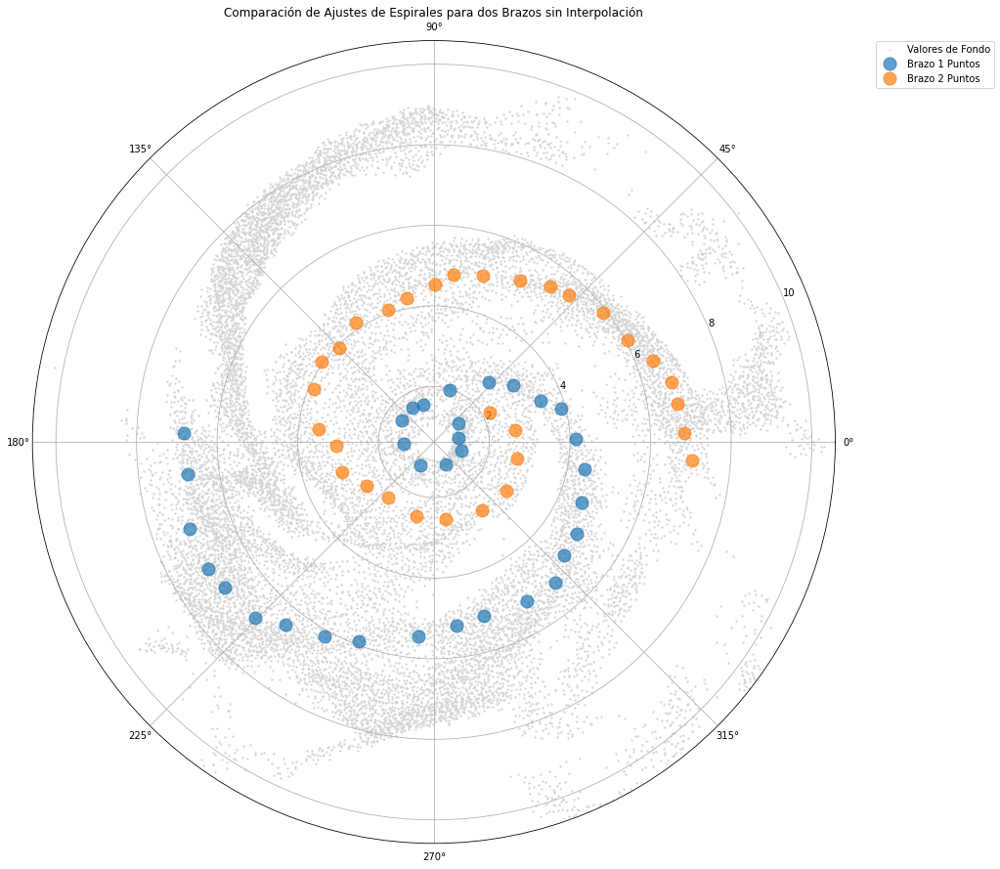

Parámetros de ajuste para Brazo 1:
Espiral Arquímedea: [ 3.75603908 -0.62670771]
Espiral Logarítmica: [4.14473413e+00 1.49248459e-11 1.00000000e+01]
Espiral Customizada: [ 1.   0.1 10. ]
Coeficiente Bayesian Ridge: [-0.56572826]

Parámetros de ajuste para Brazo 2:
Espiral Arquímedea: [4.193053   0.31375576]
Espiral Logarítmica: [4.19113824 0.29530981 2.35199394]
Espiral Customizada: [ 1.   0.1 10. ]
Coeficiente Bayesian Ridge: [0.23205562]


In [43]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from sklearn.linear_model import BayesianRidge

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para realizar ajustes con diferentes modelos y graficar
def fit_and_plot_spirals(r_values, theta_values, background_file, ax, label_prefix=""):
    # Cargar los datos de fondo
    background_data = pd.read_csv(background_file)
    x_background = background_data['x'].values
    y_background = background_data['y'].values
    r_background, theta_background = cartesian_to_polar(x_background, y_background)

    # Ajuste con la espiral arquimedeana
    try:
        popt_arch, _ = curve_fit(
            archimedean_spiral, theta_values, r_values, p0=[10, 0.1], maxfev=10000
        )
        r_fit_arch = archimedean_spiral(theta_values, *popt_arch)
        #ax.plot(theta_values, r_fit_arch, '--', color='green', label=f'{label_prefix} Ajuste Espiral Arquímedea')
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Arquímedea para {label_prefix}")

    # Ajuste con la espiral logarítmica
    try:
        popt_log, _ = curve_fit(
            log_spiral, theta_values, r_values, p0=[10, 0.05, 2],
            bounds=((0, 0, 0.1), (50, 10, 10)), maxfev=10000
        )
        r_fit_log = log_spiral(theta_values, *popt_log)
        #ax.plot(theta_values, r_fit_log, '--', color='red', label=f'{label_prefix} Ajuste Espiral Logarítmica')
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Logarítmica para {label_prefix}")

    # Ajuste con la espiral personalizada
    try:
        popt_custom, _ = curve_fit(
            custom_spiral, theta_values, r_values, p0=[10, 0.5, 4],
            bounds=((1, 0.1, 0.5), (30, 5, 10)), maxfev=10000
        )
        r_fit_custom = custom_spiral(theta_values, *popt_custom)
        #ax.plot(theta_values, r_fit_custom, '--', color='purple', label=f'{label_prefix} Ajuste Espiral Customizada')
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Customizada para {label_prefix}")

    # Ajuste con Bayesian Ridge Regression
    bayesian_ridge = BayesianRidge()
    theta_values_reshaped = theta_values.reshape(-1, 1)
    bayesian_ridge.fit(theta_values_reshaped, r_values)
    r_fit_bayesian = bayesian_ridge.predict(theta_values_reshaped)
    #ax.plot(theta_values, r_fit_bayesian, '--', color='orange', label=f'{label_prefix} Ajuste Bayesian Ridge')

    # Graficar los puntos originales y los datos de fondo
    ax.scatter(theta_background, r_background, s=1.5, alpha=0.6, color='lightgray', label='Valores de Fondo' if label_prefix == "Brazo 1" else "")
    ax.plot(theta_values, r_values, 'o', label=f'{label_prefix} Puntos', alpha=0.7, markersize=13)

    # Retornar los parámetros ajustados para cada modelo
    return {
        'archimedean': popt_arch if 'popt_arch' in locals() else None,
        'logarithmic': popt_log if 'popt_log' in locals() else None,
        'custom': popt_custom if 'popt_custom' in locals() else None,
        'bayesian_ridge': bayesian_ridge.coef_
    }

# Cargar datos y realizar el ajuste para ambos brazos
data_file_1 = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
data_file_2 = '../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv'
background_file = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'

# Crear gráfica polar
fig, ax = plt.subplots(figsize=(14, 14), subplot_kw={'projection': 'polar'})

# Ajuste y gráfica para el primer brazo
data_arm_1 = pd.read_csv(data_file_1)
x_values_1 = data_arm_1['x'].values
y_values_1 = data_arm_1['y'].values
r_values_1, theta_values_1 = cartesian_to_polar(x_values_1, y_values_1)
fit_results_1 = fit_and_plot_spirals(r_values_1, theta_values_1, background_file, ax, label_prefix="Brazo 1")

# Ajuste y gráfica para el segundo brazo
data_arm_2 = pd.read_csv(data_file_2)
x_values_2 = data_arm_2['x'].values
y_values_2 = data_arm_2['y'].values
r_values_2, theta_values_2 = cartesian_to_polar(x_values_2, y_values_2)
fit_results_2 = fit_and_plot_spirals(r_values_2, theta_values_2, background_file, ax, label_prefix="Brazo 2")

# Ajustar el zoom de la gráfica
ax.set_rmin(np.min([np.min(r_values_1), np.min(r_values_2)]) * 0.5)
ax.set_rmax(np.max([np.max(r_values_1), np.max(r_values_2)]) * 1.5)

# Configuración de la leyenda y visualización final
plt.title("Comparación de Ajustes de Espirales para dos Brazos sin Interpolación")
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Mostrar los parámetros ajustados para ambos brazos
print("Parámetros de ajuste para Brazo 1:")
if fit_results_1['archimedean'] is not None:
    print("Espiral Arquímedea:", fit_results_1['archimedean'])
if fit_results_1['logarithmic'] is not None:
    print("Espiral Logarítmica:", fit_results_1['logarithmic'])
if fit_results_1['custom'] is not None:
    print("Espiral Customizada:", fit_results_1['custom'])
print("Coeficiente Bayesian Ridge:", fit_results_1['bayesian_ridge'])

print("\nParámetros de ajuste para Brazo 2:")
if fit_results_2['archimedean'] is not None:
    print("Espiral Arquímedea:", fit_results_2['archimedean'])
if fit_results_2['logarithmic'] is not None:
    print("Espiral Logarítmica:", fit_results_2['logarithmic'])
if fit_results_2['custom'] is not None:
    print("Espiral Customizada:", fit_results_2['custom'])
print("Coeficiente Bayesian Ridge:", fit_results_2['bayesian_ridge'])


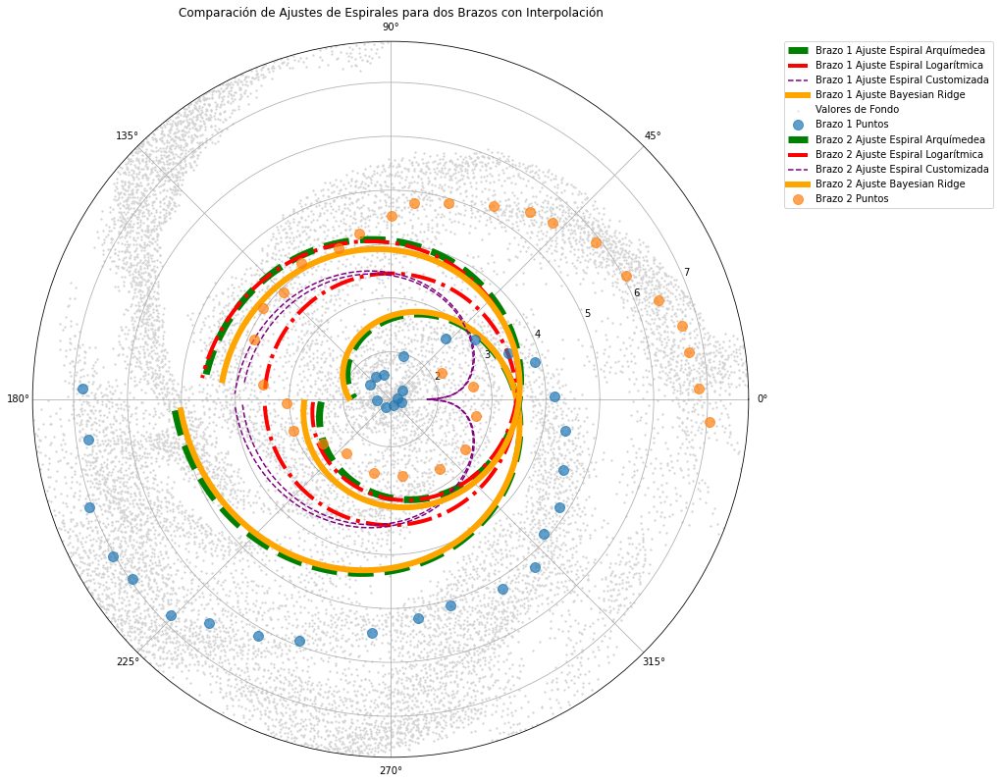

Parámetros de ajuste para Brazo 1:
Espiral Arquímedea: [ 3.46020326 -0.53800789]
Espiral Logarítmica: [3.45551327e+00 1.10000000e-02 7.99999542e+01]
Espiral Customizada: [-2.00000000e+01  1.00000000e-02  2.59435093e+00]
Coeficiente Bayesian Ridge: [-0.50381717]

Parámetros de ajuste para Brazo 2:
Espiral Arquímedea: [3.50635793 0.35438431]
Espiral Logarítmica: [3.45725039 0.37781852 1.94900105]
Espiral Customizada: [-20.           0.29226259  79.99980248]
Coeficiente Bayesian Ridge: [0.25029938]


In [69]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.interpolate import interp1d
from sklearn.linear_model import BayesianRidge

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para interpolar los datos
def interpolate_data(r_values, theta_values, num_points=500):
    theta_interp = np.linspace(np.min(theta_values), np.max(theta_values), num_points)
    interp_func = interp1d(theta_values, r_values, kind='cubic')
    r_interp = interp_func(theta_interp)
    return r_interp, theta_interp

# Función para realizar ajustes con diferentes modelos y graficar
def fit_and_plot_spirals(r_values, theta_values, background_file, ax, label_prefix=""):
    # Interpolación
    r_interp, theta_interp = interpolate_data(r_values, theta_values)

    # Cargar los datos de fondo
    background_data = pd.read_csv(background_file)
    x_background = background_data['x'].values
    y_background = background_data['y'].values
    r_background, theta_background = cartesian_to_polar(x_background, y_background)

    # Ajuste con la espiral arquimedeana
    try:
        popt_arch, _ = curve_fit(
            archimedean_spiral, theta_interp, r_interp, p0=[10, 0.1], maxfev=10000
        )
        r_fit_arch = archimedean_spiral(theta_interp, *popt_arch)
        ax.plot(theta_interp, r_fit_arch, '--', color='green', linewidth=7,label=f'{label_prefix} Ajuste Espiral Arquímedea')
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Arquímedea para {label_prefix}")

    # Ajuste con la espiral logarítmica
    try:
        popt_log, _ = curve_fit(
            log_spiral, theta_interp, r_interp, p0=[10, 0.05, 2],
            bounds=((-20, 0.011, 0.1), (60, 10, 80)), maxfev=10000
        )
        r_fit_log = log_spiral(theta_interp, *popt_log)
        ax.plot(theta_interp, r_fit_log, '-.', color='red', linewidth=4, label=f'{label_prefix} Ajuste Espiral Logarítmica')
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Logarítmica para {label_prefix}")

    # Ajuste con la espiral personalizada
    try:
        popt_custom, _ = curve_fit(
            custom_spiral, theta_interp, r_interp, p0=[10, 0.5, 4],
            bounds=((-20, 0.01, 0.2), (60, 10, 80)), maxfev=10000
        )
        r_fit_custom = custom_spiral(theta_interp, *popt_custom)
        ax.plot(theta_interp, r_fit_custom, '--', color='purple', label=f'{label_prefix} Ajuste Espiral Customizada')
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Customizada para {label_prefix}")

    # Ajuste con Bayesian Ridge Regression
    bayesian_ridge = BayesianRidge()
    theta_interp_reshaped = theta_interp.reshape(-1, 1)
    bayesian_ridge.fit(theta_interp_reshaped, r_interp)
    r_fit_bayesian = bayesian_ridge.predict(theta_interp_reshaped)
    ax.plot(theta_interp, r_fit_bayesian, '-', color='orange',  linewidth=6, markersize=20,label=f'{label_prefix} Ajuste Bayesian Ridge')

    # Graficar los puntos originales y los datos de fondo
    ax.scatter(theta_background, r_background, s=1.5, alpha=0.6, color='lightgray', label='Valores de Fondo' if label_prefix == "Brazo 1" else "")
    ax.plot(theta_values, r_values, 'o', label=f'{label_prefix} Puntos', alpha=0.7, markersize=10)

    # Retornar los parámetros ajustados para cada modelo
    return {
        'archimedean': popt_arch if 'popt_arch' in locals() else None,
        'logarithmic': popt_log if 'popt_log' in locals() else None,
        'custom': popt_custom if 'popt_custom' in locals() else None,
        'bayesian_ridge': bayesian_ridge.coef_
    }

# Cargar datos y realizar el ajuste para ambos brazos
data_file_1 = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
data_file_2 = '../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv'
background_file = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'

# Crear gráfica polar
fig, ax = plt.subplots(figsize=(14, 14), subplot_kw={'projection': 'polar'})

# Ajuste y gráfica para el primer brazo
data_arm_1 = pd.read_csv(data_file_1)
x_values_1 = data_arm_1['x'].values
y_values_1 = data_arm_1['y'].values
r_values_1, theta_values_1 = cartesian_to_polar(x_values_1, y_values_1)
fit_results_1 = fit_and_plot_spirals(r_values_1, theta_values_1, background_file, ax, label_prefix="Brazo 1")

# Ajuste y gráfica para el segundo brazo
data_arm_2 = pd.read_csv(data_file_2)
x_values_2 = data_arm_2['x'].values
y_values_2 = data_arm_2['y'].values
r_values_2, theta_values_2 = cartesian_to_polar(x_values_2, y_values_2)
fit_results_2 = fit_and_plot_spirals(r_values_2, theta_values_2, background_file, ax, label_prefix="Brazo 2")

# Ajustar el zoom de la gráfica
ax.set_rmin(np.min([np.min(r_values_1), np.min(r_values_2)]) * 0.9)
ax.set_rmax(np.max([np.max(r_values_1), np.max(r_values_2)]) * 1.1)

# Configuración de la leyenda y visualización final
plt.title("Comparación de Ajustes de Espirales para dos Brazos con Interpolación")
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Mostrar los parámetros ajustados para ambos brazos
print("Parámetros de ajuste para Brazo 1:")
if fit_results_1['archimedean'] is not None:
    print("Espiral Arquímedea:", fit_results_1['archimedean'])
if fit_results_1['logarithmic'] is not None:
    print("Espiral Logarítmica:", fit_results_1['logarithmic'])
if fit_results_1['custom'] is not None:
    print("Espiral Customizada:", fit_results_1['custom'])
print("Coeficiente Bayesian Ridge:", fit_results_1['bayesian_ridge'])

print("\nParámetros de ajuste para Brazo 2:")
if fit_results_2['archimedean'] is not None:
    print("Espiral Arquímedea:", fit_results_2['archimedean'])
if fit_results_2['logarithmic'] is not None:
    print("Espiral Logarítmica:", fit_results_2['logarithmic'])
if fit_results_2['custom'] is not None:
    print("Espiral Customizada:", fit_results_2['custom'])
print("Coeficiente Bayesian Ridge:", fit_results_2['bayesian_ridge'])


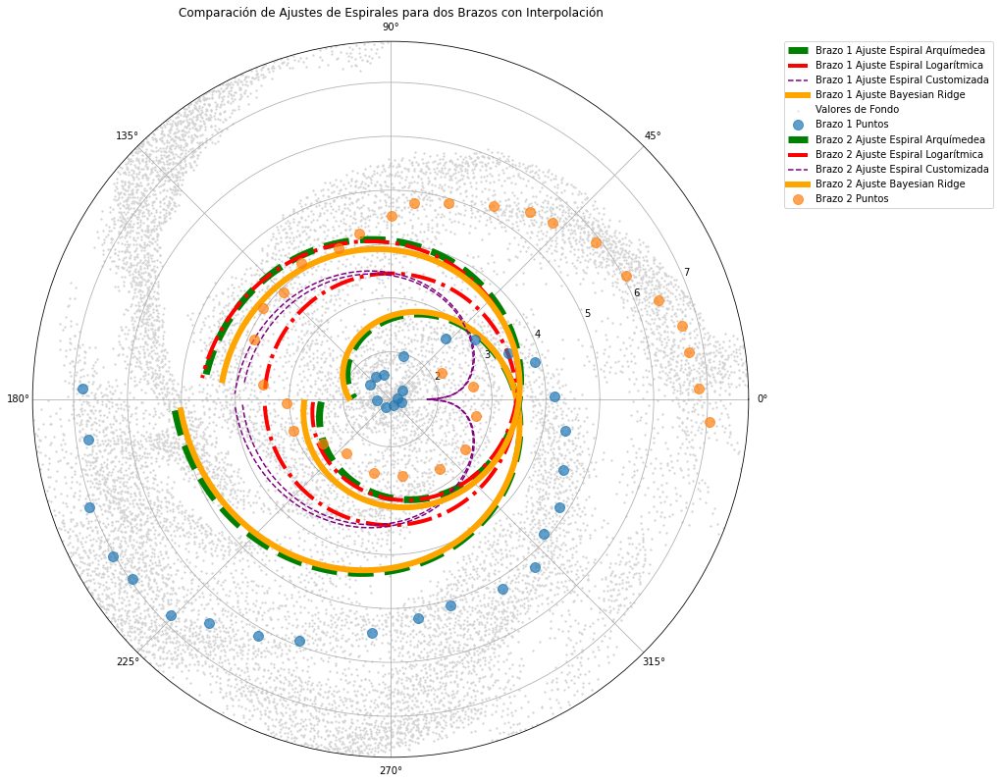

Resultados de los ajustes:
                         Model  \
0   Brazo 1 Espiral Arquímedea   
1  Brazo 1 Espiral Logarítmica   
2  Brazo 1 Espiral Customizada   
3       Brazo 1 Bayesian Ridge   
4   Brazo 2 Espiral Arquímedea   
5  Brazo 2 Espiral Logarítmica   
6  Brazo 2 Espiral Customizada   
7       Brazo 2 Bayesian Ridge   

                                          Parameters        MSE  
0          [3.4602032635055195, -0.5380078891176351]  29.488857  
1  [3.4555132685903054, 0.011000000012118339, 79....  30.419414  
2  [-19.999999999999996, 0.010000000002546021, 2....  30.606064  
3                              [-0.5038171703121587]  29.492612  
4          [3.5063579277288004, 0.35438430913139873]  58.023556  
5  [3.4572503867019133, 0.37781852055821225, 1.94...  58.039991  
6  [-19.999999997880092, 0.29226258937786354, 79....  58.914192  
7                              [0.25029938190474443]  58.057659  


In [70]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.interpolate import interp1d
from sklearn.linear_model import BayesianRidge
from sklearn.metrics import mean_squared_error

# Función para convertir coordenadas cartesianas a polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

# Funciones de espirales para ajuste
def archimedean_spiral(theta, a, b):
    return a + b * theta

def log_spiral(theta, A, B, N):
    return A * np.exp(B * theta / (2 * N))

def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Función para interpolar los datos
def interpolate_data(r_values, theta_values, num_points=500):
    theta_interp = np.linspace(np.min(theta_values), np.max(theta_values), num_points)
    interp_func = interp1d(theta_values, r_values, kind='cubic')
    r_interp = interp_func(theta_interp)
    return r_interp, theta_interp

# Función para realizar ajustes con diferentes modelos y graficar
def fit_and_plot_spirals(r_values, theta_values, background_file, ax, label_prefix=""):
    # Interpolación
    r_interp, theta_interp = interpolate_data(r_values, theta_values)

    # Cargar los datos de fondo
    background_data = pd.read_csv(background_file)
    x_background = background_data['x'].values
    y_background = background_data['y'].values
    r_background, theta_background = cartesian_to_polar(x_background, y_background)

    # Inicializar diccionario para almacenar resultados
    fit_results = {'Model': [], 'Parameters': [], 'MSE': []}

    # Ajuste con la espiral arquimedeana
    try:
        popt_arch, _ = curve_fit(
            archimedean_spiral, theta_interp, r_interp, p0=[10, 0.1], maxfev=10000
        )
        r_fit_arch = archimedean_spiral(theta_interp, *popt_arch)
        mse_arch = mean_squared_error(r_interp, r_fit_arch)
        ax.plot(theta_interp, r_fit_arch, '--', color='green', linewidth=7, label=f'{label_prefix} Ajuste Espiral Arquímedea')

        # Guardar resultados
        fit_results['Model'].append(f'{label_prefix} Espiral Arquímedea')
        fit_results['Parameters'].append(popt_arch)
        fit_results['MSE'].append(mse_arch)
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Arquímedea para {label_prefix}")

    # Ajuste con la espiral logarítmica
    try:
        popt_log, _ = curve_fit(
            log_spiral, theta_interp, r_interp, p0=[10, 0.05, 2],
            bounds=((-20, 0.011, 0.1), (60, 10, 80)), maxfev=10000
        )
        r_fit_log = log_spiral(theta_interp, *popt_log)
        mse_log = mean_squared_error(r_interp, r_fit_log)
        ax.plot(theta_interp, r_fit_log, '-.', color='red', linewidth=4, label=f'{label_prefix} Ajuste Espiral Logarítmica')

        # Guardar resultados
        fit_results['Model'].append(f'{label_prefix} Espiral Logarítmica')
        fit_results['Parameters'].append(popt_log)
        fit_results['MSE'].append(mse_log)
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Logarítmica para {label_prefix}")

    # Ajuste con la espiral personalizada
    try:
        popt_custom, _ = curve_fit(
            custom_spiral, theta_interp, r_interp, p0=[10, 0.5, 4],
            bounds=((-20, 0.01, 0.2), (60, 10, 80)), maxfev=10000
        )
        r_fit_custom = custom_spiral(theta_interp, *popt_custom)
        mse_custom = mean_squared_error(r_interp, r_fit_custom)
        ax.plot(theta_interp, r_fit_custom, '--', color='purple', label=f'{label_prefix} Ajuste Espiral Customizada')

        # Guardar resultados
        fit_results['Model'].append(f'{label_prefix} Espiral Customizada')
        fit_results['Parameters'].append(popt_custom)
        fit_results['MSE'].append(mse_custom)
    except RuntimeError:
        print(f"No se pudo ajustar la Espiral Customizada para {label_prefix}")

    # Ajuste con Bayesian Ridge Regression
    bayesian_ridge = BayesianRidge()
    theta_interp_reshaped = theta_interp.reshape(-1, 1)
    bayesian_ridge.fit(theta_interp_reshaped, r_interp)
    r_fit_bayesian = bayesian_ridge.predict(theta_interp_reshaped)
    mse_bayesian = mean_squared_error(r_interp, r_fit_bayesian)
    ax.plot(theta_interp, r_fit_bayesian, '-', color='orange', linewidth=6, markersize=20, label=f'{label_prefix} Ajuste Bayesian Ridge')

    # Guardar resultados de Bayesian Ridge
    fit_results['Model'].append(f'{label_prefix} Bayesian Ridge')
    fit_results['Parameters'].append(bayesian_ridge.coef_)
    fit_results['MSE'].append(mse_bayesian)

    # Graficar los puntos originales y los datos de fondo
    ax.scatter(theta_background, r_background, s=1.5, alpha=0.6, color='lightgray', label='Valores de Fondo' if label_prefix == "Brazo 1" else "")
    ax.plot(theta_values, r_values, 'o', label=f'{label_prefix} Puntos', alpha=0.7, markersize=10)

    return fit_results

# Cargar datos y realizar el ajuste para ambos brazos
data_file_1 = '../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv'
data_file_2 = '../DATA/processed/TracingPoints/arm_tracing_11_arm2_rho_dani.csv'
background_file = '../DATA/processed/TracingPoints/data_rho_11_filtered.csv'

# Crear gráfica polar
fig, ax = plt.subplots(figsize=(14, 14), subplot_kw={'projection': 'polar'})

# Ajuste y gráfica para el primer brazo
data_arm_1 = pd.read_csv(data_file_1)
x_values_1 = data_arm_1['x'].values
y_values_1 = data_arm_1['y'].values
r_values_1, theta_values_1 = cartesian_to_polar(x_values_1, y_values_1)
fit_results_1 = fit_and_plot_spirals(r_values_1, theta_values_1, background_file, ax, label_prefix="Brazo 1")

# Ajuste y gráfica para el segundo brazo
data_arm_2 = pd.read_csv(data_file_2)
x_values_2 = data_arm_2['x'].values
y_values_2 = data_arm_2['y'].values
r_values_2, theta_values_2 = cartesian_to_polar(x_values_2, y_values_2)
fit_results_2 = fit_and_plot_spirals(r_values_2, theta_values_2, background_file, ax, label_prefix="Brazo 2")

# Ajustar el zoom de la gráfica
ax.set_rmin(np.min([np.min(r_values_1), np.min(r_values_2)]) * 0.9)
ax.set_rmax(np.max([np.max(r_values_1), np.max(r_values_2)]) * 1.1)

# Configuración de la leyenda y visualización final
plt.title("Comparación de Ajustes de Espirales para dos Brazos con Interpolación")
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()

# Convertir resultados a DataFrame y guardar en CSV
df_results_1 = pd.DataFrame(fit_results_1)
df_results_2 = pd.DataFrame(fit_results_2)
df_combined = pd.concat([df_results_1, df_results_2], ignore_index=True)
df_combined.to_csv("fit_results.csv", index=False)

# Mostrar el DataFrame en pantalla
print("Resultados de los ajustes:")
print(df_combined)


In [16]:
id_halo = 11
data = read_data(id_halo)

sorted_data = sort_by_delta_rho(data)

In [17]:
x = sorted_data['x']
y = sorted_data['y']


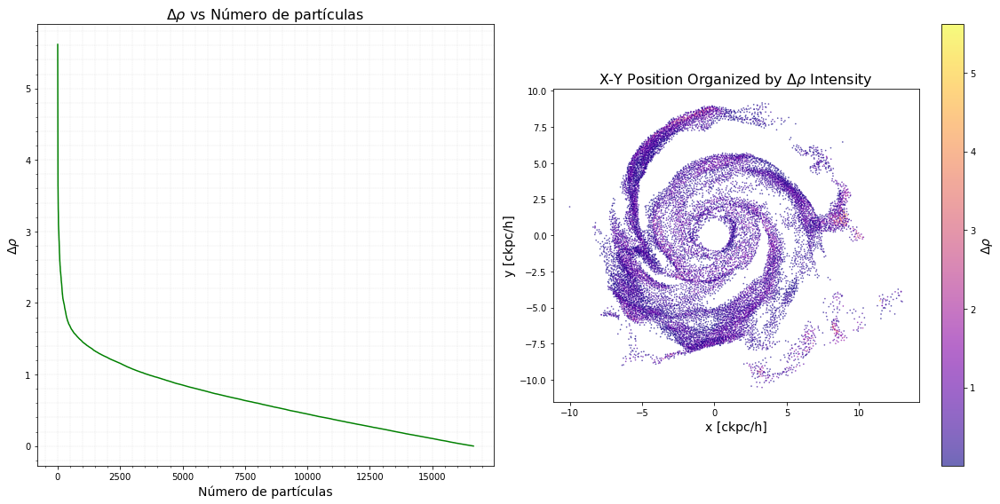

In [18]:
# Datos
x = sorted_data['x']
y = sorted_data['y']
delta_rho = sorted_data['deltaRho']
num_particles = range(1, len(delta_rho) + 1)

# Gráficas
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# Primer gráfico: DeltaRho vs Número de partículas
ax1.plot(num_particles, delta_rho, color='g', linewidth=1.5)
ax1.set_title(r'$\Delta \rho$ vs Número de partículas', fontsize=16)
ax1.set_xlabel(r'Número de partículas', fontsize=14)
ax1.set_ylabel(r'$\Delta \rho$', fontsize=14)
ax1.grid(True, which='both', linestyle='--', linewidth=0.4, alpha=0.4)
ax1.minorticks_on()

# Segundo gráfico: Posición X-Y de las partículas, organizadas por la intensidad de DeltaRho
scatter = ax2.scatter(x, y, c=delta_rho, cmap='plasma', s=0.5, alpha=0.6)
ax2.set_title(r'X-Y Position Organized by $\Delta \rho$ Intensity', fontsize=16)
ax2.set_xlabel('x [ckpc/h]', fontsize=14)
ax2.set_ylabel('y [ckpc/h]', fontsize=14)
ax2.set_aspect('equal', adjustable='box')

# Barra de color
cbar = fig.colorbar(scatter, ax=ax2, orientation='vertical')
cbar.set_label(r'$\Delta \rho$', fontsize=14)


plt.tight_layout()
plt.show()


## Cartesian to Polar Transformations
To transform Cartesian coordinates \((x, y)\) into polar coordinates \((r, $\phi$)\), we use the following mathematical relationships:

$$
r = \sqrt{x^2 + y^2}
$$

$$
\phi = \text{atan2}(y, x)
$$

Here, \( r \) is the radial distance from the origin, and \( $\phi$ \) is the angle (in radians) measured counterclockwise from the positive \(x\)-axis.


## Inverse Polar to Cartesian:
These transformations:

$$
x = r \cdot \cos(\phi)
$$
$$
y = r \cdot \sin(\phi)
$$


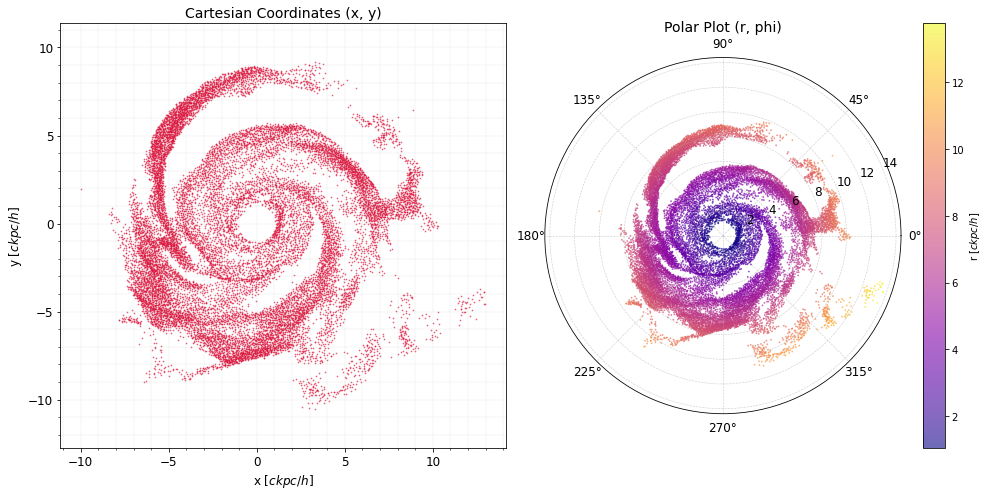

In [19]:
x_values_s = sorted_data['x'].values
y_values_s = sorted_data['y'].values

# Convert to polar coordinates
r_values_sorted, phi_values_sorted = cartesian_to_polar(x_values_s, y_values_s)

# Plotting the Cartesian and Polar Coordinates
fig = plt.figure(figsize=(14, 7))

# Plot Cartesian coordinates
ax1 = fig.add_subplot(121)
ax1.scatter(x_values_s, y_values_s, c=h_alpha_color, s=0.5, alpha=0.6)
ax1.set_title('Cartesian Coordinates (x, y)', fontsize=14)
ax1.set_xlabel('x [$\it{ckpc/h}$]', fontsize=12)
ax1.set_ylabel('y [$\it{ckpc/h}$]', fontsize=12)
ax1.set_aspect('equal')
ax1.grid(True, which='both', linestyle='--', linewidth=0.4, alpha=0.4)
ax1.minorticks_on()
ax1.tick_params(axis='both', which='major', labelsize=12)
ax1.tick_params(axis='both', which='minor', labelsize=10)
ax1.axis('equal')

# Plot Polar coordinates 
ax2 = fig.add_subplot(122, projection='polar')
sc = ax2.scatter(phi_values_sorted, r_values_sorted, c=r_values_sorted, cmap='plasma', s=0.7, alpha=0.6)
ax2.set_title('Polar Plot (r, phi)', fontsize=14)
ax2.grid(True, which='both', linestyle='--', linewidth=0.6, alpha=0.6)
ax2.tick_params(axis='both', which='major', labelsize=12)

plt.colorbar(sc, ax=ax2, label='r [$\it{ckpc/h}$]')

plt.tight_layout()
plt.show()



## A new formula describing the scaffold structure of spiral galaxies

The formula presented in the article is:

$$
r(\phi) = \frac{A}{\log \left( B \tan \left( \frac{\phi}{2N} \right) \right)}
$$

Where:
- \( A \) is a scale parameter,
- \( B \) controls the bulge-to-arm size,
- \( N \) determines the spiral's tightness, and
- \( $\phi $\) is the polar angle.


- **`spiral_structure`** function takes the angle \( $\phi$ \), and parameters \( A \), \( B \), and \( N \) to compute the radial distance \( r($\phi$) \) for the spiral.

  
### Customization:
- You can adjust the parameters \( A \), \( B \), and \( N \) based on the specific galaxy morphology or dataset.
- The formula allows flexibility in fitting different types of spiral structures, and you can fine-tune these parameters to fit your galaxy data.



In [20]:
def spiral_structure(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    
    Parameters:
    phi : array-like
        Array of angle values in radians.
    A : float
        Scale parameter for the spiral.
    B : float
        Parameter that controls the bulge-to-arm size.
    N : float
        Winding number that controls the spiral's tightness.
    
    Returns:
    r : array-like
        Radial distances corresponding to the angle values.
    """
    r = A / np.log(B * np.tan(phi / (2 * N)))
    return r



## Numerical Estimation


## Ajuste con curve_fit

/home/daniel/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in log
  import sys


Parámetros ajustados: A = -0.5030690658648425, B = 1.133603558405297, N = 0.9888308798205969


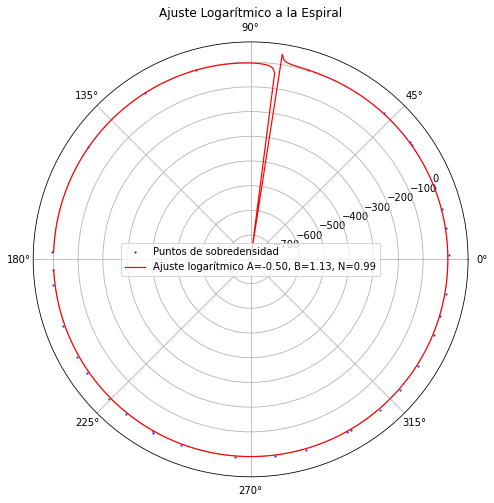

In [21]:
# Definir la función de espiral logarítmica a ajustar
def log_spiral(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    """
    safe_phi = np.clip(phi, 1e-6, None)  # Evitar valores problemáticos para tan y log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Cargar los datos 
data_arm = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')

# Extraer los valores de x e y
x_values = data_arm['x'].values
y_values = data_arm['y'].values

# Convertir a coordenadas polares (r, φ)
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Ajuste por mínimos cuadrados no lineales usando curve_fit de scipy
def fit_log_spiral_numerical(r_values, phi_values):

    initial_guess = [1.0, 1.0, 1.0]
    
    # Ajustar los datos con curve_fit
    try:
        popt, pcov = curve_fit(log_spiral, phi_values, r_values, p0=initial_guess, maxfev=10000)
    except RuntimeError:
        print("No se pudo ajustar el modelo a los datos")
        return None, None

    # Retornar los parámetros ajustados (A, B, N)
    return popt, pcov

# Ajustar el modelo y obtener los parámetros A, B y N
params, covariance = fit_log_spiral_numerical(r_values, phi_values)

if params is not None:
    A_fit, B_fit, N_fit = params
    print(f"Parámetros ajustados: A = {A_fit}, B = {B_fit}, N = {N_fit}")

    # Graficar 
    phi_fit = np.linspace(np.min(phi_values), np.max(phi_values), 500)
    r_fit = log_spiral(phi_fit, A_fit, B_fit, N_fit)

    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))
    ax.scatter(phi_values, r_values, color='blue', s=2, alpha=0.6, label='Puntos de sobredensidad')
    ax.plot(phi_fit, r_fit, label=f'Ajuste logarítmico A={A_fit:.2f}, B={B_fit:.2f}, N={N_fit:.2f}', color='red', linewidth=1.2)
    ax.set_title('Ajuste Logarítmico a la Espiral')
    ax.legend()
    plt.show()
else:
    print("No se pudo realizar el ajuste")


### 2do intento

-
Usando BayesianRidge
-

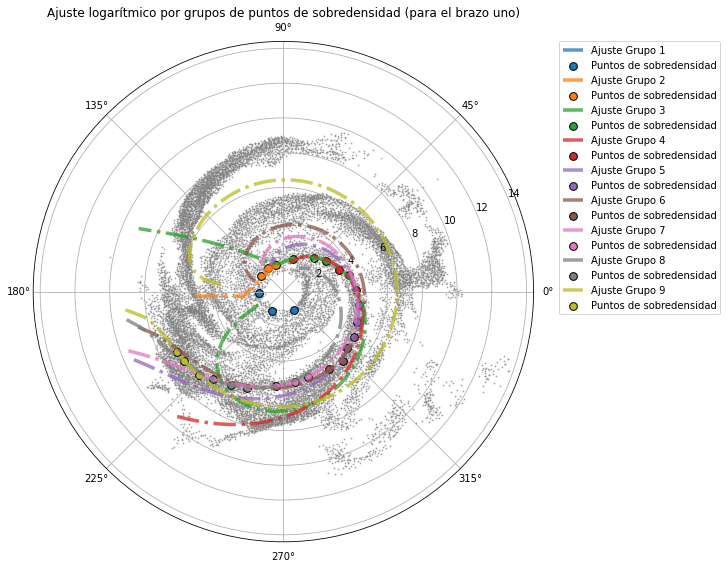

In [22]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Función logarítmica de la espiral incluyendo A, B y N
def log_spiral(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    """
    safe_phi = np.clip(phi, 1e-6, None)  # Evitar valores problemáticos para tan y log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Extraer los valores de x e y
x_values = data_arm['x'].values
y_values = data_arm['y'].values

# Convertir a coordenadas polares
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Definir los límites de radio para los ajustes
r_min = np.percentile(r_values_sorted, 2.5)  # 5% más cercano al centro
r_max = np.percentile(r_values_sorted, 97.5)  # 95% más lejano al borde

# Lista ajustes y estadísticas
adjustment_info = []

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))

# Puntos originales
ax.scatter(phi_values_sorted, r_values_sorted, s=0.7, alpha=0.6, c='gray')

# Ajustar para cada conjunto de tres puntos
for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values, phi_values)):
    if len(r_group) < 3:  # Asegurarnos de que haya 3 puntos en el grupo
        continue

    # Omitir el primer y el último grupo
    if group_index == 0 or (group_index + 1) * 3 >= len(r_values):
        continue

    # Ajuste bayesiano para este subconjunto
    bayesian_spiral = BayesianSpiralFitter()
    r2_score = bayesian_spiral.fit(phi_group, r_group)
    
    # Guardar los valores del ajuste en la lista
    adjustment_info.append({
        'grupo': group_index,
        'A': bayesian_spiral.A_,
        'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_,
        'r_min': r_min,
        'r_max': r_max,
        'phi_group': phi_group,
        'r_group': r_group,
        'r2_score': r2_score  # Guardar el score R^2
    })
    
    # Ajuste para todo el rango global de φ dentro del rango [r_min, r_max]
    phi_fit = np.linspace(np.min(phi_values), np.max(phi_values), 100)  # Usar el phi global
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, r_min, r_max)
    
    ax.plot(phi_fit_filtered, r_fit, '-.' ,label=f'Ajuste Grupo {group_index}',linewidth=3.5, alpha=0.75)
    ax.scatter(phi_group, r_group, label='Puntos de sobredensidad', edgecolor= 'black', s=60)


ax.set_title('Ajuste logarítmico por grupos de puntos de sobredensidad (para el brazo uno)')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()

# Mostrar el gráfico
plt.show();


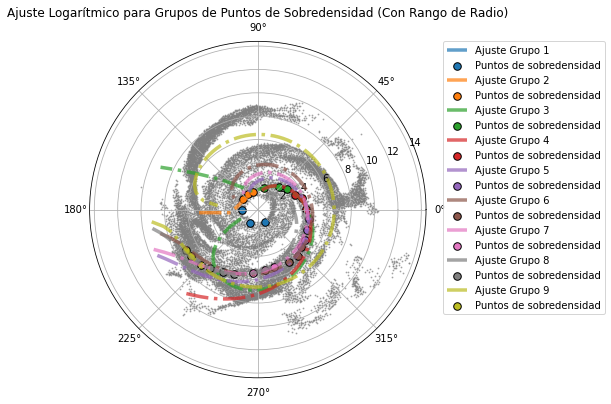

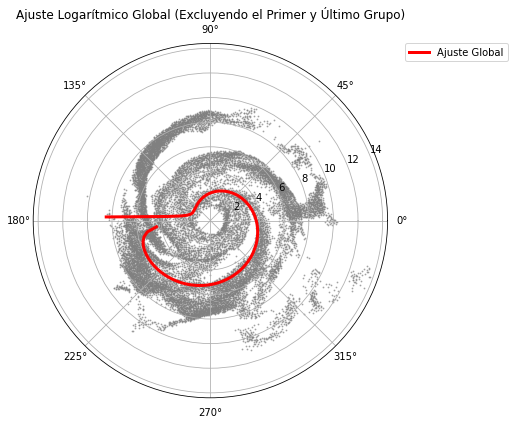

In [11]:
# Definir la función logarítmica de la espiral incluyendo A, B y N
def log_spiral(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    """
    safe_phi = np.clip(phi, 1e-6, None)  # Evitar valores problemáticos para tan y log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)


# Cargar los datos
data_arm = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')

# Extraer los valores de x e y
x_values = data_arm['x'].values
y_values = data_arm['y'].values

# Convertir a coordenadas polares
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Límites de radio 
r_min = np.percentile(r_values_sorted, 2.5)  # 5% más cercano al centro
r_max = np.percentile(r_values_sorted, 97.5)  # 95% más lejano al borde

# Lista ajustes y estadísticas
adjustment_info = []

# Ajustar y graficar para cada grupo de 3 puntos
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))

# Graficar los puntos originales
ax.scatter(phi_values_sorted, r_values_sorted, s=0.7, alpha=0.6, c='gray')

# Almacenar los puntos para el ajuste global 
#(excluyendo el primer y último grupo)
r_values_for_global = []
phi_values_for_global = []

# Ajustar para cada conjunto de tres puntos
for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values, phi_values)):
    if len(r_group) < 3:  # Asegurarnos de que haya 3 puntos en el grupo
        continue

    # Omitir el primer y el último grupo
    if group_index == 0 or (group_index + 1) * 3 >= len(r_values):
        continue

    # Guardar los valores de r y phi para el ajuste global
    r_values_for_global.extend(r_group)
    phi_values_for_global.extend(phi_group)

    # Ajuste bayesiano para este subconjunto
    bayesian_spiral = BayesianSpiralFitter()
    r2_score = bayesian_spiral.fit(phi_group, r_group)
    
    # Guardar los valores del ajuste en la lista
    adjustment_info.append({
        'grupo': group_index,
        'A': bayesian_spiral.A_,
        'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_,
        'r_min': r_min,
        'r_max': r_max,
        'phi_group': phi_group,
        'r_group': r_group,
        'r2_score': r2_score  # Guardar el score R^2
    })
    
    # Ajuste para todo el rango global de φ dentro del rango [r_min, r_max]
    phi_fit = np.linspace(np.min(phi_values), np.max(phi_values), 100)  # Usar el phi global
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, r_min, r_max)
    
    # Graficar el ajuste para este subconjunto
    ax.plot(phi_fit_filtered, r_fit, '-.', label=f'Ajuste Grupo {group_index}', linewidth=3.5, alpha=0.7)
    ax.scatter(phi_group, r_group, label='Puntos de sobredensidad', edgecolor='black', s=57)

# Ajustar leyenda y moverla fuera de la gráfica
ax.set_title('Ajuste Logarítmico para Grupos de Puntos de Sobredensidad (Con Rango de Radio)')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()

# Mostrar el gráfico
plt.show()

# Ajuste Global (para todos los puntos, menos el primer y último grupo)
# Convertir a numpy arrays para el ajuste global
r_values_for_global = np.array(r_values_for_global)
phi_values_for_global = np.array(phi_values_for_global)

# Realizar el ajuste global con todos los puntos
bayesian_spiral_global = BayesianSpiralFitter()
r2_score_global = bayesian_spiral_global.fit(phi_values_for_global, r_values_for_global)

# Predecir los valores ajustados para todo el rango global de φ dentro del rango [r_min, r_max]
phi_fit_global = np.linspace(np.min(phi_values), np.max(phi_values), 100)
r_fit_global, phi_fit_filtered_global = bayesian_spiral_global.predict(phi_fit_global, r_min, r_max)

# Graficar el ajuste global
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_global.plot(phi_fit_filtered_global, r_fit_global, label='Ajuste Global', color='red', linewidth=3)
ax_global.scatter(phi_values_sorted, r_values_sorted, s=0.7, alpha=0.6, c='gray')
ax_global.set_title('Ajuste Logarítmico Global (Excluyendo el Primer y Último Grupo)')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()

# Mostrar el gráfico global
plt.show()



In [12]:
print(f"Ajuste Global: A = {bayesian_spiral_global.A_}, B = {bayesian_spiral_global.B_}, N = {bayesian_spiral_global.N_}, R^2 = {r2_score_global:.4f}")


Ajuste Global: A = -1.030445663182945, B = 0.06974937008071613, N = 0.06974937008072146, R^2 = 0.6008


In [30]:
for adjustment in adjustment_info:
    print(f"Grupo: {adjustment['grupo']}, A: {adjustment['A']}, B: {adjustment['B']}, N: {adjustment['N']}, R^2: {adjustment['r2_score']:.4f}")


Grupo: 1, A: -0.04554300048861058, B: -0.0005767136535506307, N: -0.0005767136535506307, R^2: 1.0000
Grupo: 2, A: 0.34666173679792944, B: -0.06500197074830302, N: -0.06500197074830302, R^2: 1.0000
Grupo: 3, A: -3.5886680354432663, B: 1.5203860675557603, N: 1.5203860675557603, R^2: 1.0000
Grupo: 4, A: -1.1554431650692538, B: -0.6005033359601774, N: -0.6005033359601774, R^2: 0.8919
Grupo: 5, A: -0.6487091025269099, B: -0.3771645714060246, N: -0.3771645714060246, R^2: 0.9657
Grupo: 6, A: -0.3123227121574796, B: -0.18252241628735869, N: -0.18252241628735869, R^2: 0.4898
Grupo: 7, A: -0.16747348111814858, B: -0.4504023383582848, N: -0.4504023383582848, R^2: 0.9880
Grupo: 8, A: -1.3426505386566614, B: -0.09558675800310645, N: -0.09558675800310645, R^2: 1.0000
Grupo: 9, A: 0.032917424507592274, B: -0.0777750598349223, N: -0.0777750598349223, R^2: 1.0000


In [14]:
import csv

## watershed

In [15]:
# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

distance_threshold = 1.5  # Umbral basado en la distancia entre grupos
arm_adjustments, adjustment_info = {}, []
arm_count = 0

# Calcular distancia entre grupos
def calculate_distance(r1, r2): return np.mean(np.abs(r1 - r2))

# Ciclo para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3: continue
    if group_idx == 0 or calculate_distance(r_group, arm_adjustments[arm_count]['groups'][-1]['r_group']) >= distance_threshold:
        arm_count += 1
        arm_adjustments[arm_count] = {'groups': [], 'total_particles': 0}

    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)
    
    phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

    arm_adjustments[arm_count]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_, 'r2_score': bayesian_spiral.r2_score_, 'phi_fit': phi_fit_filtered, 'r_fit': r_fit
    })
    arm_adjustments[arm_count]['total_particles'] += len(r_group)
    
    adjustment_info.append({
        'brazo': arm_count, 'grupo': group_idx, 
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'r_min': np.min(r_group), 'r_max': np.max(r_group), 'num_particles': len(r_group),
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r2_score': bayesian_spiral.r2_score_
    })

# Guardar la información en un archivo CSV
with open('adjustment_info.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info[0].keys())
    writer.writeheader()
    writer.writerows(adjustment_info)

# Resumen de brazos
total_arms = len(arm_adjustments)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")




Se crearon 4136 brazos.
Brazo 1: Número de grupos: 28, Total partículas: 84
Brazo 2: Número de grupos: 1, Total partículas: 3
Brazo 3: Número de grupos: 8, Total partículas: 24
Brazo 4: Número de grupos: 1, Total partículas: 3
Brazo 5: Número de grupos: 1, Total partículas: 3
Brazo 6: Número de grupos: 1, Total partículas: 3
Brazo 7: Número de grupos: 3, Total partículas: 9
Brazo 8: Número de grupos: 2, Total partículas: 6
Brazo 9: Número de grupos: 1, Total partículas: 3
Brazo 10: Número de grupos: 1, Total partículas: 3
Brazo 11: Número de grupos: 7, Total partículas: 21
Brazo 12: Número de grupos: 1, Total partículas: 3
Brazo 13: Número de grupos: 3, Total partículas: 9
Brazo 14: Número de grupos: 1, Total partículas: 3
Brazo 15: Número de grupos: 3, Total partículas: 9
Brazo 16: Número de grupos: 1, Total partículas: 3
Brazo 17: Número de grupos: 1, Total partículas: 3
Brazo 18: Número de grupos: 8, Total partículas: 24
Brazo 19: Número de grupos: 1, Total partículas: 3
Brazo 20: 

Brazo 1375: Número de grupos: 1, Total partículas: 3
Brazo 1376: Número de grupos: 1, Total partículas: 3
Brazo 1377: Número de grupos: 1, Total partículas: 3
Brazo 1378: Número de grupos: 1, Total partículas: 3
Brazo 1379: Número de grupos: 1, Total partículas: 3
Brazo 1380: Número de grupos: 2, Total partículas: 6
Brazo 1381: Número de grupos: 1, Total partículas: 3
Brazo 1382: Número de grupos: 2, Total partículas: 6
Brazo 1383: Número de grupos: 1, Total partículas: 3
Brazo 1384: Número de grupos: 1, Total partículas: 3
Brazo 1385: Número de grupos: 1, Total partículas: 3
Brazo 1386: Número de grupos: 1, Total partículas: 3
Brazo 1387: Número de grupos: 1, Total partículas: 3
Brazo 1388: Número de grupos: 1, Total partículas: 3
Brazo 1389: Número de grupos: 1, Total partículas: 3
Brazo 1390: Número de grupos: 1, Total partículas: 3
Brazo 1391: Número de grupos: 1, Total partículas: 3
Brazo 1392: Número de grupos: 1, Total partículas: 3
Brazo 1393: Número de grupos: 2, Total partícu

Brazo 2374: Número de grupos: 2, Total partículas: 6
Brazo 2375: Número de grupos: 1, Total partículas: 3
Brazo 2376: Número de grupos: 1, Total partículas: 3
Brazo 2377: Número de grupos: 1, Total partículas: 3
Brazo 2378: Número de grupos: 1, Total partículas: 3
Brazo 2379: Número de grupos: 1, Total partículas: 3
Brazo 2380: Número de grupos: 1, Total partículas: 3
Brazo 2381: Número de grupos: 1, Total partículas: 3
Brazo 2382: Número de grupos: 1, Total partículas: 3
Brazo 2383: Número de grupos: 1, Total partículas: 3
Brazo 2384: Número de grupos: 1, Total partículas: 3
Brazo 2385: Número de grupos: 1, Total partículas: 3
Brazo 2386: Número de grupos: 1, Total partículas: 3
Brazo 2387: Número de grupos: 1, Total partículas: 3
Brazo 2388: Número de grupos: 1, Total partículas: 3
Brazo 2389: Número de grupos: 1, Total partículas: 3
Brazo 2390: Número de grupos: 1, Total partículas: 3
Brazo 2391: Número de grupos: 1, Total partículas: 3
Brazo 2392: Número de grupos: 3, Total partícu

Brazo 3374: Número de grupos: 1, Total partículas: 3
Brazo 3375: Número de grupos: 2, Total partículas: 6
Brazo 3376: Número de grupos: 1, Total partículas: 3
Brazo 3377: Número de grupos: 1, Total partículas: 3
Brazo 3378: Número de grupos: 1, Total partículas: 3
Brazo 3379: Número de grupos: 1, Total partículas: 3
Brazo 3380: Número de grupos: 1, Total partículas: 3
Brazo 3381: Número de grupos: 2, Total partículas: 6
Brazo 3382: Número de grupos: 1, Total partículas: 3
Brazo 3383: Número de grupos: 3, Total partículas: 9
Brazo 3384: Número de grupos: 1, Total partículas: 3
Brazo 3385: Número de grupos: 2, Total partículas: 6
Brazo 3386: Número de grupos: 7, Total partículas: 21
Brazo 3387: Número de grupos: 1, Total partículas: 3
Brazo 3388: Número de grupos: 1, Total partículas: 3
Brazo 3389: Número de grupos: 1, Total partículas: 3
Brazo 3390: Número de grupos: 1, Total partículas: 3
Brazo 3391: Número de grupos: 1, Total partículas: 3
Brazo 3392: Número de grupos: 1, Total partíc

In [16]:
# Resumen de brazos
total_arms = len(arm_adjustments)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")



Se crearon 29 brazos.
Brazo 1: Número de grupos: 145, Total partículas: 435
Brazo 2: Número de grupos: 376, Total partículas: 1128
Brazo 3: Número de grupos: 5, Total partículas: 15
Brazo 4: Número de grupos: 408, Total partículas: 1224
Brazo 5: Número de grupos: 269, Total partículas: 807
Brazo 6: Número de grupos: 367, Total partículas: 1101
Brazo 7: Número de grupos: 274, Total partículas: 822
Brazo 8: Número de grupos: 139, Total partículas: 417
Brazo 9: Número de grupos: 999, Total partículas: 2997
Brazo 10: Número de grupos: 84, Total partículas: 252
Brazo 11: Número de grupos: 106, Total partículas: 318
Brazo 12: Número de grupos: 22, Total partículas: 66
Brazo 13: Número de grupos: 120, Total partículas: 360
Brazo 14: Número de grupos: 30, Total partículas: 90
Brazo 15: Número de grupos: 252, Total partículas: 756
Brazo 16: Número de grupos: 155, Total partículas: 465
Brazo 17: Número de grupos: 129, Total partículas: 387
Brazo 18: Número de grupos: 128, Total partículas: 384


/home/daniel/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


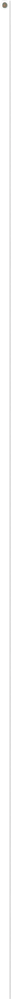

In [16]:
# Filtrar el último grupo calculado de cada brazo
last_groups = {}
for adjustment in adjustment_info:
    brazo = adjustment['brazo']
    if brazo not in last_groups or adjustment['grupo'] > last_groups[brazo]['grupo']:
        last_groups[brazo] = adjustment

# Crear una figura en coordenadas polares
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(11, 10))

# Limitar a los primeros 4 brazos
for idx, (brazo, adjustment) in enumerate(last_groups.items()):
    
    # Obtener phi_fit y r_fit del último grupo de cada brazo
    phi_fit = adjustment['phi_fit']
    r_fit = adjustment['r_fit']
    
    # Graficar el ajuste del brazo (phi_fit, r_fit)
    ax_global.plot(phi_fit, r_fit, label=f'Ajuste Brazo {brazo}', linewidth=2, alpha=0.6)

# Configurar el título y la leyenda
ax_global.set_title('Ajuste Logarítmico del Último Grupo de los Primeros 4 Brazos', fontsize=12)
ax_global.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

# Graficar los valores originales (phi_values_s, r_values_s)
ax_global.scatter(phi_values_s, r_values_s, s=0.87, alpha=0.46, c='gray', label='Datos Originales')

# Ajustar el layout para la leyenda
plt.tight_layout()

# Mostrar el gráfico
plt.show()


In [18]:
import numpy as np
import matplotlib.pyplot as plt
import csv

# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

distance_threshold = 5.2  # Umbral basado en la distancia entre grupos
arm_adjustments, adjustment_info = {}, []
arm_count = 0

# Calcular distancia entre grupos
def calculate_distance(r1, r2): 
    return np.mean(np.abs(r1 - r2))

# Ciclo para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3: 
        continue
    # Si es el primer grupo o la distancia entre el grupo actual y el último es mayor al umbral
    if group_idx == 0 or calculate_distance(r_group, arm_adjustments[arm_count]['groups'][-1]['r_group']) >= distance_threshold:
        arm_count += 1
        arm_adjustments[arm_count] = {'groups': [], 'total_particles': 0}

    # Ajuste bayesiano del brazo espiral
    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)
    
    # Usar solo los valores del grupo actual para generar el ajuste (no r_min y r_max globales)
    phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

    arm_adjustments[arm_count]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_, 'r2_score': bayesian_spiral.r2_score_, 'phi_fit': phi_fit_filtered, 'r_fit': r_fit
    })
    arm_adjustments[arm_count]['total_particles'] += len(r_group)
    
    adjustment_info.append({
        'brazo': arm_count, 'grupo': group_idx, 
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'r_min': np.min(r_group), 'r_max': np.max(r_group), 'num_particles': len(r_group),
        'r_group': r_group, 'phi_group': phi_group, 
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r2_score': bayesian_spiral.r2_score_
    })

# Guardar la información en un archivo CSV
with open('adjustment_info.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info[0].keys())
    writer.writeheader()
    writer.writerows(adjustment_info)

# Resumen de brazos
total_arms = len(arm_adjustments)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")




Se crearon 29 brazos.
Brazo 1: Número de grupos: 145, Total partículas: 435
Brazo 2: Número de grupos: 376, Total partículas: 1128
Brazo 3: Número de grupos: 5, Total partículas: 15
Brazo 4: Número de grupos: 408, Total partículas: 1224
Brazo 5: Número de grupos: 269, Total partículas: 807
Brazo 6: Número de grupos: 367, Total partículas: 1101
Brazo 7: Número de grupos: 274, Total partículas: 822
Brazo 8: Número de grupos: 139, Total partículas: 417
Brazo 9: Número de grupos: 999, Total partículas: 2997
Brazo 10: Número de grupos: 84, Total partículas: 252
Brazo 11: Número de grupos: 106, Total partículas: 318
Brazo 12: Número de grupos: 22, Total partículas: 66
Brazo 13: Número de grupos: 120, Total partículas: 360
Brazo 14: Número de grupos: 30, Total partículas: 90
Brazo 15: Número de grupos: 252, Total partículas: 756
Brazo 16: Número de grupos: 155, Total partículas: 465
Brazo 17: Número de grupos: 129, Total partículas: 387
Brazo 18: Número de grupos: 128, Total partículas: 384


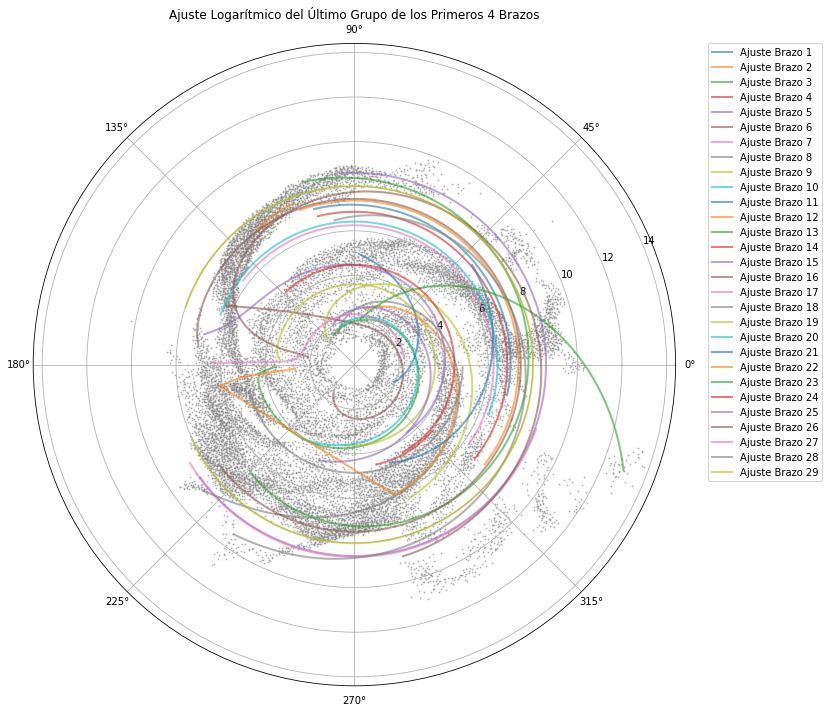

In [19]:
# Filtrar el último grupo calculado de cada brazo
last_groups = {}
for adjustment in adjustment_info:
    brazo = adjustment['brazo']
    if brazo not in last_groups or adjustment['grupo'] > last_groups[brazo]['grupo']:
        last_groups[brazo] = adjustment

# Crear una figura en coordenadas polares
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(11, 10))

# Limitar a los primeros 4 brazos
for idx, (brazo, adjustment) in enumerate(last_groups.items()):
    
    # Obtener phi_fit y r_fit del último grupo de cada brazo
    phi_fit = adjustment['phi_fit']
    r_fit = adjustment['r_fit']
    
    # Graficar el ajuste del brazo (phi_fit, r_fit)
    ax_global.plot(phi_fit, r_fit, label=f'Ajuste Brazo {brazo}', linewidth=2, alpha=0.6)

# Configurar el título y la leyenda
ax_global.set_title('Ajuste Logarítmico del Último Grupo de los Primeros 4 Brazos', fontsize=12)
ax_global.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

# Graficar los valores originales (phi_values_s, r_values_s)
ax_global.scatter(phi_values_s, r_values_s, s=0.87, alpha=0.46, c='gray', label='Datos Originales')

# Ajustar el layout para la leyenda
plt.tight_layout()

# Mostrar el gráfico
plt.show()


### nuevo intento

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import csv

# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

distance_threshold = 0.9  # Umbral basado en la distancia entre grupos
arm_adjustments, adjustment_info = {}, []
arm_count = 0

# Calcular la distancia vertical mínima entre un punto y varios ajustes
def vertical_distance_to_adjustments__(r_data, phi_data, adjustments):
    min_distance = np.inf
    best_fit_index = -1

    # Iterar sobre cada ajuste posible
    for i, adjustment in enumerate(adjustments):
        r_fit = adjustment['r_fit']
        phi_fit = adjustment['phi_fit']

        # Interpolar r_fit en función de phi_fit para obtener el r_ajuste correspondiente a phi_data
        r_fit_interp = np.interp(phi_data, phi_fit, r_fit)

        # Calcular la distancia vertical entre r_data y r_fit_interp
        distance = np.abs(r_data - r_fit_interp)

        # Actualizar la distancia mínima y el índice del mejor ajuste si es necesario
        if distance < min_distance:
            min_distance = distance
            best_fit_index = i

    return min_distance, best_fit_index

# Ciclo para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3: 
        continue

    # Verificar si el grupo actual cumple con la distancia mínima a los ajustes existentes
    add_to_existing_arm = False
    for arm in range(1, arm_count + 1):
        previous_adjustments = [{'r_fit': adj['r_fit'], 'phi_fit': adj['phi_fit']} for adj in arm_adjustments[arm]['groups']]

        # Calcular la distancia vertical mínima para cada punto en el grupo
        point_distances = [
            vertical_distance_to_adjustments__(r_point, phi_point, previous_adjustments)[0]
            for r_point, phi_point in zip(r_group, phi_group)
        ]

        # Si todos los puntos cumplen con el threshold, asignar al brazo
        if all(dist < distance_threshold for dist in point_distances):
            add_to_existing_arm = True
            selected_arm = arm
            break

    # Si el grupo no pertenece a ningún brazo, crear uno nuevo
    if not add_to_existing_arm:
        arm_count += 1
        selected_arm = arm_count
        arm_adjustments[selected_arm] = {'groups': [], 'total_particles': 0}

    # Ajuste bayesiano del brazo espiral
    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)

    # Usar solo los valores del grupo actual para generar el ajuste (no r_min y r_max globales)
    phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

    # Agregar los puntos y ajuste al brazo seleccionado
    arm_adjustments[selected_arm]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_, 'r2_score': bayesian_spiral.r2_score_, 'phi_fit': phi_fit_filtered, 'r_fit': r_fit
    })
    arm_adjustments[selected_arm]['total_particles'] += len(r_group)

    # Registrar la información de ajuste
    adjustment_info.append({
        'brazo': selected_arm, 'grupo': group_idx, 
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'r_min': np.min(r_group), 'r_max': np.max(r_group), 'num_particles': len(r_group),
        'r_group': r_group, 'phi_group': phi_group, 
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r2_score': bayesian_spiral.r2_score_
    })

# Guardar la información en un archivo CSV
with open('adjustment_info.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info[0].keys())
    writer.writeheader()
    writer.writerows(adjustment_info)

# Resumen de brazos
total_arms = len(arm_adjustments)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")



Se crearon 107 brazos.
Brazo 1: Número de grupos: 5140, Total partículas: 15420
Brazo 2: Número de grupos: 2, Total partículas: 6
Brazo 3: Número de grupos: 3, Total partículas: 9
Brazo 4: Número de grupos: 1, Total partículas: 3
Brazo 5: Número de grupos: 8, Total partículas: 24
Brazo 6: Número de grupos: 276, Total partículas: 828
Brazo 7: Número de grupos: 2, Total partículas: 6
Brazo 8: Número de grupos: 1, Total partículas: 3
Brazo 9: Número de grupos: 4, Total partículas: 12
Brazo 10: Número de grupos: 1, Total partículas: 3
Brazo 11: Número de grupos: 1, Total partículas: 3
Brazo 12: Número de grupos: 1, Total partículas: 3
Brazo 13: Número de grupos: 2, Total partículas: 6
Brazo 14: Número de grupos: 1, Total partículas: 3
Brazo 15: Número de grupos: 1, Total partículas: 3
Brazo 16: Número de grupos: 3, Total partículas: 9
Brazo 17: Número de grupos: 1, Total partículas: 3
Brazo 18: Número de grupos: 6, Total partículas: 18
Brazo 19: Número de grupos: 1, Total partículas: 3
Br

/home/daniel/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


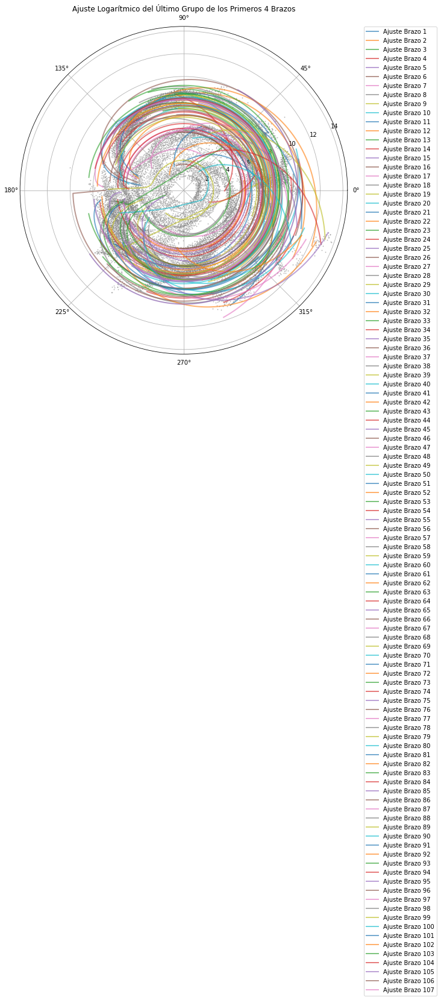

In [19]:
# Filtrar el último grupo calculado de cada brazo
last_groups = {}
for adjustment in adjustment_info:
    brazo = adjustment['brazo']
    if brazo not in last_groups or adjustment['grupo'] > last_groups[brazo]['grupo']:
        last_groups[brazo] = adjustment

# Crear una figura en coordenadas polares
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(11, 10))

# Limitar a los primeros 4 brazos
for idx, (brazo, adjustment) in enumerate(last_groups.items()):
    
    # Obtener phi_fit y r_fit del último grupo de cada brazo
    phi_fit = adjustment['phi_fit']
    r_fit = adjustment['r_fit']
    
    # Graficar el ajuste del brazo (phi_fit, r_fit)
    ax_global.plot(phi_fit, r_fit, label=f'Ajuste Brazo {brazo}', linewidth=2, alpha=0.6)

# Configurar el título y la leyenda
ax_global.set_title('Ajuste Logarítmico del Último Grupo de los Primeros 4 Brazos', fontsize=12)
#ax_global.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

# Graficar los valores originales (phi_values_s, r_values_s)
ax_global.scatter(phi_values_s, r_values_s, s=0.87, alpha=0.46, c='gray', label='Datos Originales')

# Ajustar el layout para la leyenda
plt.tight_layout()

# Mostrar el gráfico
plt.show()


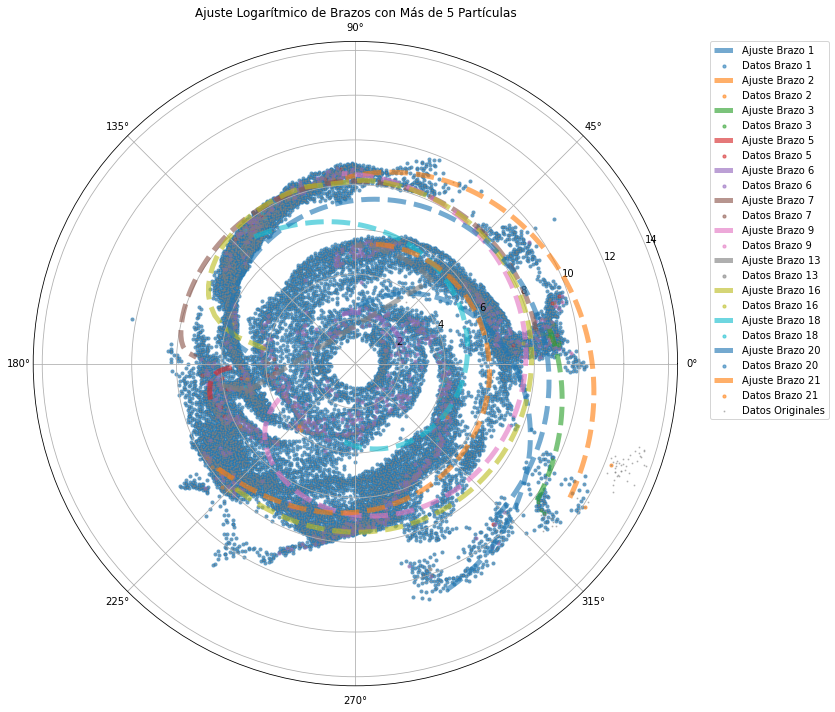

In [25]:
# Filtrar el último grupo calculado de cada brazo
last_groups = {}
for adjustment in adjustment_info:
    brazo = adjustment['brazo']
    if brazo not in last_groups or adjustment['grupo'] > last_groups[brazo]['grupo']:
        last_groups[brazo] = adjustment

# Crear una figura en coordenadas polares
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(11, 10))

# Limitar la visualización solo a los brazos con más de 5 partículas en total
for brazo, adjustment in last_groups.items():
    # Obtener el total de partículas del brazo desde arm_adjustments
    total_particulas_brazo = arm_adjustments[brazo]['total_particles']
    
    # Filtrar brazos con más de 5 partículas
    if total_particulas_brazo > 5:
        # Obtener phi_fit y r_fit del último grupo de cada brazo
        phi_fit = adjustment['phi_fit']
        r_fit = adjustment['r_fit']
        
        # Graficar el ajuste del brazo (phi_fit, r_fit)
        ax_global.plot(phi_fit, r_fit, '--' ,label=f'Ajuste Brazo {brazo}', linewidth=5, alpha=0.62)
        
        # Graficar los puntos de datos del brazo
        r_brazo = np.concatenate([group['r_group'] for group in arm_adjustments[brazo]['groups']])
        phi_brazo = np.concatenate([group['phi_group'] for group in arm_adjustments[brazo]['groups']])
        ax_global.scatter(phi_brazo, r_brazo, s=10, alpha=0.56, label=f'Datos Brazo {brazo}')

# Configurar el título y la leyenda
ax_global.set_title('Ajuste Logarítmico de Brazos con Más de 5 Partículas', fontsize=12)

# Graficar los valores originales (phi_values_s, r_values_s)
ax_global.scatter(phi_values_s, r_values_s, s=0.87, alpha=0.46, c='gray', label='Datos Originales')

# Mostrar la leyenda
ax_global.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

# Ajustar el layout para evitar recortes
plt.tight_layout()

# Mostrar el gráfico
plt.show()



In [26]:
from lmfit import Model


In [30]:
import numpy as np
import matplotlib.pyplot as plt
from lmfit import Model
from sklearn.linear_model import Ridge

# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares
def cartesian_to_polar(x, y):
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    return r, theta

r_values_s, phi_values_s = cartesian_to_polar(x, y)

# Umbral de partículas para selección de brazos significativos
umbral_particulas = 5
arm_adjustments, adjustment_info = {}, []
arm_count = 0

# Definir la función espiral para ajuste `lmfit`
def custom_spiral(theta, A, B, N):
    return A / (np.log(np.abs(B * np.tan(theta / (2 * N))) + 1e-5))

# Configurar el modelo `lmfit`
spiral_model = Model(custom_spiral)

# Ciclo para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3: 
        continue
    
    if group_idx == 0 or calculate_distance(r_group, arm_adjustments[arm_count]['groups'][-1]['r_group']) >= 5.2:
        arm_count += 1
        arm_adjustments[arm_count] = {'groups': [], 'total_particles': 0}

    # Ajuste usando Ridge
    ridge_model = Ridge(alpha=1.0)
    phi_reshaped = phi_group.reshape(-1, 1)
    ridge_model.fit(phi_reshaped, r_group)
    
    # Generar valores ajustados para el modelo Ridge
    phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
    r_fit_ridge = ridge_model.predict(phi_fit.reshape(-1, 1))

    # Ajuste usando lmfit
    params = spiral_model.make_params(A=0.1, B=0.63, N=4)
    params['A'].min, params['A'].max = -10, 20
    params['B'].min, params['B'].max = 0.001, 20
    params['N'].min, params['N'].max = 0.1, 200
    result = spiral_model.fit(r_group, params, theta=phi_group)

    # Generar valores ajustados para el modelo `lmfit`
    r_fit_lmfit = custom_spiral(phi_fit, result.params['A'].value, result.params['B'].value, result.params['N'].value)
    
    # Almacenar los resultados en `adjustment_info`
    arm_adjustments[arm_count]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 
        'ridge_fit': r_fit_ridge, 'lmfit_adjustment': r_fit_lmfit,
        'phi_fit': phi_fit,
        'lmfit_params': (result.params['A'].value, result.params['B'].value, result.params['N'].value)
    })
    arm_adjustments[arm_count]['total_particles'] += len(r_group)
    
    adjustment_info.append({
        'brazo': arm_count, 'grupo': group_idx, 'ridge_fit': r_fit_ridge.tolist(), 'lmfit_fit': r_fit_lmfit.tolist()
    })



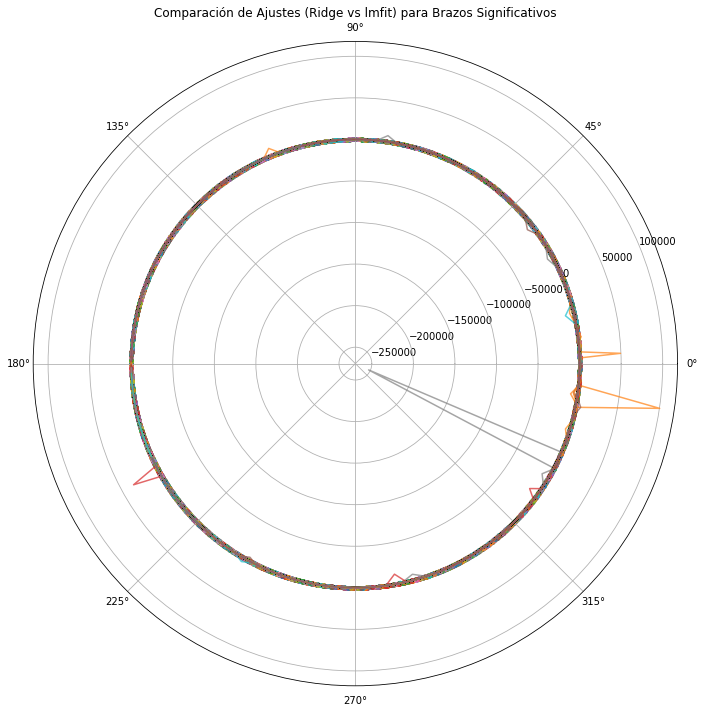

In [31]:

# Filtrar brazos significativos
last_groups = {brazo: adj for brazo, adj in arm_adjustments.items() if adj['total_particles'] > umbral_particulas}

# Graficar los resultados
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 10))

# Graficar cada brazo significativo
for brazo, data in last_groups.items():
    for group in data['groups']:
        phi_group = group['phi_group']
        r_group = group['r_group']
        phi_fit = group['phi_fit']
        r_fit_ridge = group['ridge_fit']
        r_fit_lmfit = group['lmfit_adjustment']
        
        # Graficar los puntos originales
        ax_global.scatter(phi_group, r_group, s=15, alpha=0.6, label=f'Puntos Brazo {brazo}')
        
        # Graficar el ajuste Ridge
        ax_global.plot(phi_fit, r_fit_ridge, '--', label=f'Ajuste Ridge Brazo {brazo}', alpha=0.7)
        
        # Graficar el ajuste lmfit
        ax_global.plot(phi_fit, r_fit_lmfit, '-', label=f'Ajuste lmfit Brazo {brazo}', alpha=0.7)

# Configuración final del gráfico
ax_global.set_title('Comparación de Ajustes (Ridge vs lmfit) para Brazos Significativos', fontsize=12)
#plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()


In [ ]:
ax_global.set_ylim(-5, 10)


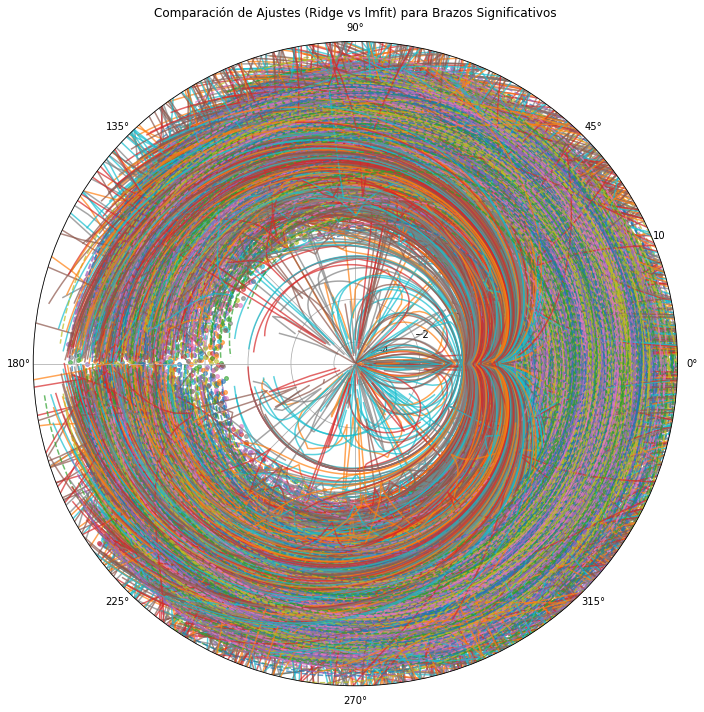

In [32]:
# Graficar los resultados
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 10))

# Graficar cada brazo significativo
for brazo, data in last_groups.items():
    for group in data['groups']:
        phi_group = group['phi_group']
        r_group = group['r_group']
        phi_fit = group['phi_fit']
        r_fit_ridge = group['ridge_fit']
        r_fit_lmfit = group['lmfit_adjustment']
        
        # Graficar los puntos originales
        ax_global.scatter(phi_group, r_group, s=15, alpha=0.6, label=f'Puntos Brazo {brazo}')
        
        # Graficar el ajuste Ridge
        ax_global.plot(phi_fit, r_fit_ridge, '--', label=f'Ajuste Ridge Brazo {brazo}', alpha=0.7)
        
        # Graficar el ajuste lmfit
        ax_global.plot(phi_fit, r_fit_lmfit, '-', label=f'Ajuste lmfit Brazo {brazo}', alpha=0.7)

# Configuración final del gráfico
ax_global.set_title('Comparación de Ajustes (Ridge vs lmfit) para Brazos Significativos', fontsize=12)
#plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()
ax_global.set_ylim(-5, 10)
plt.show()

In [16]:
# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

distance_threshold = 5.2  # Umbral basado en la distancia entre grupos
arm_adjustments_, adjustment_info_ = {}, []
arm_count = 0

# Calcular distancia entre grupos
def calculate_distance(r1, r2): 
    return np.mean(np.abs(r1 - r2))

# Función para obtener los puntos iniciales y finales del grupo actual y anteriores
def get_adjustment_range(r_group, previous_groups):
    r_min = np.min([np.min(g['r_group']) for g in previous_groups] + [np.min(r_group)])
    r_max = np.max([np.max(g['r_group']) for g in previous_groups] + [np.max(r_group)])
    return r_min, r_max

# Ciclo para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3:
        continue

    # Si es el primer grupo o la distancia entre grupos supera el umbral
    if group_idx == 0 or calculate_distance(r_group, arm_adjustments_[arm_count]['groups'][-1]['r_group']) >= distance_threshold:
        arm_count += 1
        arm_adjustments_[arm_count] = {'groups': [], 'total_particles': 0}

    # Obtener los grupos anteriores que cumplan el treshold
    previous_groups = arm_adjustments_[arm_count]['groups'] if len(arm_adjustments_[arm_count]['groups']) > 0 else []
    
    # Obtener el rango de ajuste usando los puntos iniciales y finales de los grupos actuales y anteriores
    r_min, r_max = get_adjustment_range(r_group, previous_groups)
    
    # Ajuste bayesiano
    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)

    # Predecir valores ajustados para este grupo
    phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, r_min, r_max)

    # Almacenar la información del ajuste del grupo
    arm_adjustments_[arm_count]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_, 'r2_score': bayesian_spiral.r2_score_, 'phi_fit': phi_fit_filtered, 'r_fit': r_fit
    })
    arm_adjustments_[arm_count]['total_particles'] += len(r_group)
    
    adjustment_info_.append({
        'brazo': arm_count, 'grupo': group_idx, 
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'r_min': r_min, 'r_max': r_max, 'num_particles': len(r_group),
        'r_group': r_group, 'phi_group': phi_group, 
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r2_score': bayesian_spiral.r2_score_
    })

# Guardar la información en un archivo CSV
with open('adjustment_info_.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info_[0].keys())
    writer.writeheader()
    writer.writerows(adjustment_info_)

# Resumen de brazos
total_arms = len(arm_adjustments_)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments_.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments_.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")



ValueError: operands could not be broadcast together with shapes (3,) (2,) 

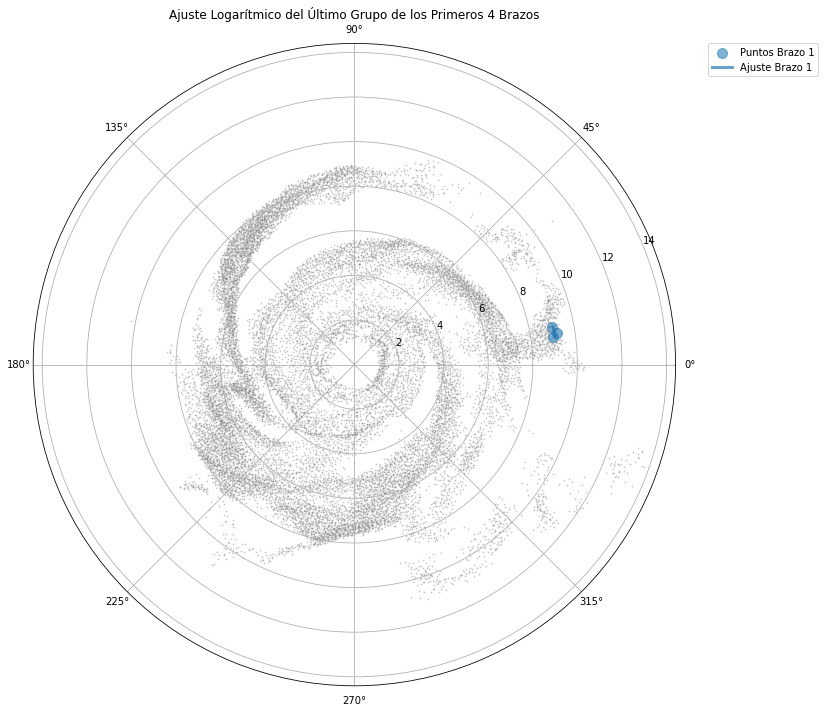

In [17]:
# Filtrar el último grupo calculado de cada brazo
last_groups = {}
for adjustment in adjustment_info_:
    brazo = adjustment['brazo']
    if brazo not in last_groups or adjustment['grupo'] > last_groups[brazo]['grupo']:
        last_groups[brazo] = adjustment

# Crear una figura en coordenadas polares
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(11, 10))

# Limitar a los primeros 4 brazos y asignar colores únicos a cada uno
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red']  # Puedes añadir más colores si es necesario

for idx, (brazo, adjustment) in enumerate(last_groups.items()):
    if idx >= 24:  # Limitar a los primeros 4 brazos
        break
    
    # Obtener los puntos originales (r_group, phi_group) y el ajuste (r_fit, phi_fit)
    r_group = adjustment['r_group']
    phi_group = adjustment['phi_group']
    phi_fit = adjustment['phi_fit']
    r_fit = adjustment['r_fit']
    
    # Asignar un color específico a este brazo
    color = colors[idx % len(colors)]
    
    # Graficar los puntos originales del brazo (phi_group, r_group) con el mismo color
    ax_global.scatter(phi_group, r_group, color=color, s=100, alpha=0.56, label=f'Puntos Brazo {brazo}')
    
    # Graficar el ajuste del brazo (phi_fit, r_fit) con el mismo color
    ax_global.plot(phi_fit, r_fit, color=color, label=f'Ajuste Brazo {brazo}', linewidth=3, alpha=0.68)

# Configurar el título y la leyenda
ax_global.set_title('Ajuste Logarítmico del Último Grupo de los Primeros 4 Brazos', fontsize=12)
ax_global.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

# Graficar los valores originales de todos los datos (phi_values_s, r_values_s) en gris como fondo
ax_global.scatter(phi_values_s, r_values_s, s=0.87, alpha=0.3, c='gray', label='Datos Originales', zorder=-1)

# Ajustar el layout para la leyenda
plt.tight_layout()

# Mostrar el gráfico
plt.show()


In [18]:
# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

distance_threshold = 0.9  # Umbral basado en la distancia entre grupos
arm_adjustments_, adjustment_info_ = {}, []
arm_count = 0

# Calcular distancia entre grupos
def calculate_distance(r1, r2): 
    return np.mean(np.abs(r1 - r2))

# Función para obtener los puntos acumulados de los grupos previos y actuales
def accumulate_points(r_group, phi_group, previous_groups):
    r_total = np.concatenate([g['r_group'] for g in previous_groups] + [r_group])
    phi_total = np.concatenate([g['phi_group'] for g in previous_groups] + [phi_group])
    return r_total, phi_total

# Ciclo para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3:
        continue

    # Si es el primer grupo o la distancia entre grupos supera el umbral
    add_to_existing_arm = False
    for arm in range(1, arm_count + 1):
        # Revisar si el grupo pertenece a algún brazo ya existente
        if calculate_distance(r_group, arm_adjustments_[arm]['groups'][-1]['r_group']) < distance_threshold:
            add_to_existing_arm = True
            selected_arm = arm
            break

    if not add_to_existing_arm:
        arm_count += 1
        selected_arm = arm_count
        arm_adjustments_[selected_arm] = {'groups': [], 'total_particles': 0}

    # Obtener los grupos anteriores que cumplan el threshold
    previous_groups = arm_adjustments_[selected_arm]['groups'] if len(arm_adjustments_[selected_arm]['groups']) > 0 else []
    
    # Acumular todos los puntos de los grupos anteriores y el actual
    r_total, phi_total = accumulate_points(r_group, phi_group, previous_groups)

    # Ajuste bayesiano usando los puntos acumulados
    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_total, r_total)

    # Predecir valores ajustados usando los puntos acumulados
    phi_fit = np.linspace(np.min(phi_total), np.max(phi_total), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_total), np.max(r_total))

    # Almacenar la información del ajuste del grupo actual
    arm_adjustments_[selected_arm]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_, 'r2_score': bayesian_spiral.r2_score_, 'phi_fit': phi_fit_filtered, 'r_fit': r_fit
    })
    arm_adjustments_[selected_arm]['total_particles'] += len(r_group)
    
    adjustment_info_.append({
        'brazo': selected_arm, 'grupo': group_idx, 
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'r_min': np.min(r_total), 'r_max': np.max(r_total), 'num_particles': len(r_group),
        'r_group': r_total, 'phi_group': phi_total, 
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r2_score': bayesian_spiral.r2_score_
    })

# Guardar la información en un archivo CSV
with open('adjustment_info_.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info_[0].keys())
    writer.writeheader()
    writer.writerows(adjustment_info_)

# Resumen de brazos
total_arms = len(arm_adjustments_)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments_.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments_.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")



ValueError: operands could not be broadcast together with shapes (3,) (2,) 

In [38]:
adjustment_info_


[{'brazo': 1,
  'grupo': 0,
  'A': 4.5078664765387015e-05,
  'B': 2.2483777182098565e-05,
  'N': 2.2483777182098565e-05,
  'r_min': 9.003418591254569,
  'r_max': 9.184017949142364,
  'num_particles': 3,
  'r_group': array([9.18401795, 9.00341859, 9.03650608]),
  'phi_group': array([0.15672857, 0.13731382, 0.18578795]),
  'phi_fit': [0.1373138186177423,
   0.13780345628628451,
   0.13829309395482675,
   0.13878273162336896,
   0.13927236929191117,
   0.1397620069604534,
   0.14025164462899561,
   0.14074128229753782,
   0.14123091996608006,
   0.14172055763462227,
   0.14221019530316448,
   0.14269983297170669,
   0.14318947064024892,
   0.14367910830879113,
   0.14416874597733334,
   0.14465838364587558,
   0.14514802131441779,
   0.14563765898296,
   0.14612729665150223,
   0.14661693432004444,
   0.14710657198858665,
   0.14759620965712889,
   0.1480858473256711,
   0.1485754849942133,
   0.1490651226627555,
   0.14955476033129775,
   0.15004439799983996,
   0.15053403566838217,
   0

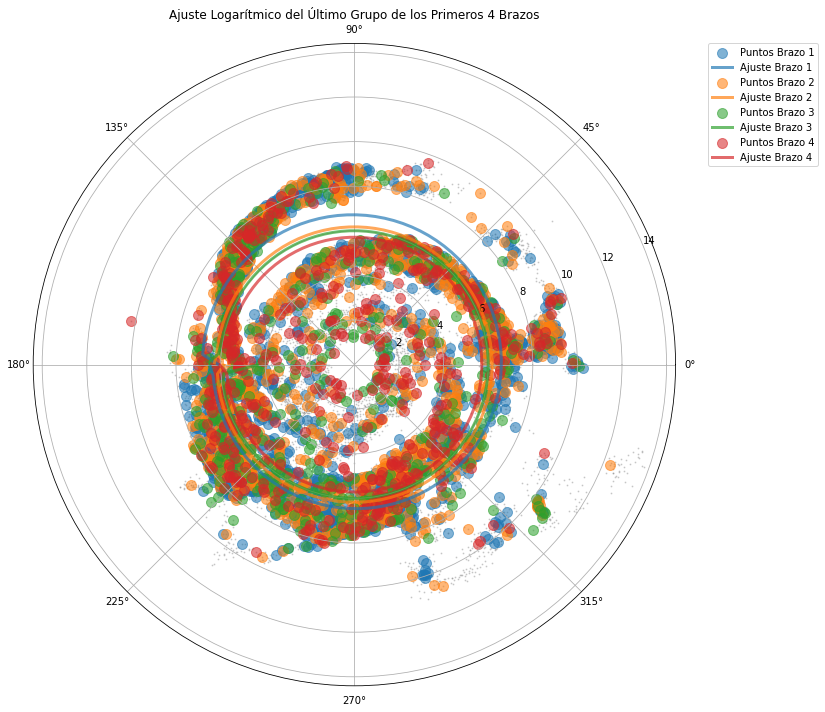

In [39]:

# Filtrar el último grupo calculado de cada brazo
last_groups = {}
for adjustment in adjustment_info_:
    brazo = adjustment['brazo']
    if brazo not in last_groups or adjustment['grupo'] > last_groups[brazo]['grupo']:
        last_groups[brazo] = adjustment

# Crear una figura en coordenadas polares
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(11, 10))

# Limitar a los primeros 4 brazos y asignar colores únicos a cada uno
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red']  # Puedes añadir más colores si es necesario

for idx, (brazo, adjustment) in enumerate(last_groups.items()):
    if idx >= 4:  # Limitar a los primeros 4 brazos
        break
    
    # Obtener los puntos originales (r_group, phi_group) y el ajuste (r_fit, phi_fit)
    r_group = adjustment['r_group']
    phi_group = adjustment['phi_group']
    phi_fit = adjustment['phi_fit']
    r_fit = adjustment['r_fit']
    
    # Asignar un color específico a este brazo
    color = colors[idx % len(colors)]
    
    # Graficar los puntos originales del brazo (phi_group, r_group) con el mismo color
    ax_global.scatter(phi_group, r_group, color=color, s=100, alpha=0.56, label=f'Puntos Brazo {brazo}')
    
    # Graficar el ajuste del brazo (phi_fit, r_fit) con el mismo color
    ax_global.plot(phi_fit, r_fit, color=color, label=f'Ajuste Brazo {brazo}', linewidth=3, alpha=0.68)

# Configurar el título y la leyenda
ax_global.set_title('Ajuste Logarítmico del Último Grupo de los Primeros 4 Brazos', fontsize=12)
ax_global.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

# Graficar los valores originales de todos los datos (phi_values_s, r_values_s) en gris como fondo
ax_global.scatter(phi_values_s, r_values_s, s=0.87, alpha=0.3, c='gray', label='Datos Originales', zorder=-1)

# Ajustar el layout para la leyenda
plt.tight_layout()

# Mostrar el gráfico
plt.show()


In [ ]:
from scipy.optimize import curve_fit
import numpy as np

# Definir la función logarítmica de la espiral
def log_spiral(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    """
    safe_phi = np.clip(phi, 1e-6, None)  # Evitar valores problemáticos para tan y log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Clase para el ajuste de la espiral logarítmica
class BayesianSpiralFitter:
    def __init__(self):
        self.A_ = None
        self.B_ = None
        self.N_ = None
        self.r2_score_ = None
        self.likelihood_ = None

    def fit(self, phi, r):
        # Ajustar los parámetros A, B y N de la espiral logarítmica usando curve_fit
        initial_guess = [1.0, 1.0, 1.0]  # Valores iniciales para A, B y N
        params, _ = curve_fit(log_spiral, phi, r, p0=initial_guess, maxfev=5000, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]))

        # Almacenar los parámetros ajustados
        self.A_, self.B_, self.N_ = params

        # Calcular el ajuste predicho para los datos de entrada
        r_pred = log_spiral(phi, self.A_, self.B_, self.N_)

        # Calcular el R2 para verificar la calidad del ajuste
        self.r2_score_ = 1 - (np.sum((r - r_pred) ** 2) / np.sum((r - np.mean(r)) ** 2))

        # Cálculo de verosimilitud basado en el error cuadrático medio
        mse = np.mean((r - r_pred) ** 2)
        self.likelihood_ = np.exp(-mse)  # Verosimilitud basada en el error cuadrático medio

        return self.r2_score_, self.likelihood_

    def predict(self, phi, r_min, r_max):
        """
        Predecir los valores de r para un rango de φ dentro de r_min y r_max.
        Filtra los valores de r fuera del rango dado.
        """
        r_pred = log_spiral(phi, self.A_, self.B_, self.N_)
        
        # Aplicar el filtro de r_min y r_max
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]  # Devuelve los valores de r y phi filtrados


In [59]:
from scipy.optimize import curve_fit

# Definir la función logarítmica de la espiral
def log_spiral(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    """
    safe_phi = np.clip(phi, 1e-6, None)  # Evitar valores problemáticos para tan y log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Clase para el ajuste de la espiral logarítmica
class BayesianSpiralFitter:
    def __init__(self):
        self.A_ = None
        self.B_ = None
        self.N_ = None
        self.r2_score_ = None
        self.likelihood_ = None

    def fit(self, phi, r):
        # Ajustar los parámetros A, B y N de la espiral logarítmica usando curve_fit
        initial_guess = [1.0, 1.0, 1.0]  # Valores iniciales para A, B y N
        params, _ = curve_fit(log_spiral, phi, r, p0=initial_guess)

        # Almacenar los parámetros ajustados
        self.A_, self.B_, self.N_ = params

        # Calcular el ajuste predicho para los datos de entrada
        r_pred = log_spiral(phi, self.A_, self.B_, self.N_)

        # Calcular el R2 para verificar la calidad del ajuste
        self.r2_score_ = 1 - (np.sum((r - r_pred) ** 2) / np.sum((r - np.mean(r)) ** 2))

        # Cálculo de verosimilitud basado en el error cuadrático medio
        mse = np.mean((r - r_pred) ** 2)
        self.likelihood_ = np.exp(-mse)  # Verosimilitud basada en el error cuadrático medio

        return self.r2_score_, self.likelihood_

    def predict(self, phi, r_min, r_max):
        """
        Predecir los valores de r para un rango de φ dentro de r_min y r_max.
        Filtra los valores de r fuera del rango dado.
        """
        r_pred = log_spiral(phi, self.A_, self.B_, self.N_)
        
        # Aplicar el filtro de r_min y r_max
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]  # Devuelve los valores de r y phi filtrados
    
    

# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

# Parámetros y condiciones
distance_threshold = 2.2
likelihood_threshold = 0.7
std_threshold = 0.4

arm_adjustments_, adjustment_info_ = {}, []
arm_count = 0

# Calcular distancia entre grupos
def calculate_distance(r1, r2): 
    return np.mean(np.abs(r1 - r2))

# Acumular puntos de grupos previos
def accumulate_points(r_group, phi_group, previous_groups):
    r_total = np.concatenate([g['r_group'] for g in previous_groups] + [r_group])
    phi_total = np.concatenate([g['phi_group'] for g in previous_groups] + [phi_group])
    return r_total, phi_total

# Evaluar la desviación estándar
def evaluate_standard_deviation(r_total, phi_total):
    r_std = np.std(r_total)
    phi_std = np.std(phi_total)
    return r_std, phi_std

# Ciclo principal para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3:
        continue

    add_to_existing_arm = False
    selected_arm = None
    
    # Evaluar si el grupo pertenece a un brazo existente
    for arm in range(1, arm_count + 1):
        if calculate_distance(r_group, arm_adjustments_[arm]['groups'][-1]['r_group']) < distance_threshold:
            previous_groups = arm_adjustments_[arm]['groups']
            r_total, phi_total = accumulate_points(r_group, phi_group, previous_groups)

            # Evaluar desviación estándar
            r_std, phi_std = evaluate_standard_deviation(r_total, phi_total)
            
            if r_std < std_threshold and phi_std < std_threshold:
                # Ajuste bayesiano
                bayesian_spiral = BayesianSpiralFitter()
                r2, likelihood = bayesian_spiral.fit(phi_total, r_total)
                
                if likelihood >= likelihood_threshold:
                    add_to_existing_arm = True
                    selected_arm = arm
                    break

    # Si no se puede añadir, crear un nuevo brazo
    if not add_to_existing_arm:
        arm_count += 1
        selected_arm = arm_count
        arm_adjustments_[selected_arm] = {'groups': [], 'total_particles': 0}

    # Acumular puntos
    previous_groups = arm_adjustments_[selected_arm]['groups'] if len(arm_adjustments_[selected_arm]['groups']) > 0 else []
    r_total, phi_total = accumulate_points(r_group, phi_group, previous_groups)

    # Ajuste bayesiano
    bayesian_spiral = BayesianSpiralFitter()
    r2, likelihood = bayesian_spiral.fit(phi_total, r_total)

    # Predecir valores ajustados
    phi_fit = np.linspace(np.min(phi_total), np.max(phi_total), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_total), np.max(r_total))

    # Almacenar información del ajuste
    arm_adjustments_[selected_arm]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_, 'r2_score': r2, 'phi_fit': phi_fit_filtered, 'r_fit': r_fit
    })
    arm_adjustments_[selected_arm]['total_particles'] += len(r_group)
    
    adjustment_info_.append({
        'brazo': selected_arm, 'grupo': group_idx, 
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'r_min': np.min(r_total), 'r_max': np.max(r_total), 'num_particles': len(r_group),
        'r_group': r_total, 'phi_group': phi_total, 
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r2_score': r2,
        'likelihood': likelihood
    })

# Guardar la información en CSV
with open('adjustment_info_.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info_[0].keys())
    writer.writeheader()
    writer.writerows(adjustment_info_)

# Resumen de brazos
total_arms = len(arm_adjustments_)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments_.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments_.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")



/home/daniel/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in log
  if __name__ == '__main__':
/home/daniel/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:834: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


RuntimeError: Optimal parameters not found: Number of calls to function has reached maxfev = 800.

In [58]:
# Clase para el ajuste Bayesiano
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None
        self.r2_score_ = None
        self.likelihood_ = None
        
    def fit(self, phi, r):
        # Preprocesar los valores: φ, tan(φ/2), tan(φ/2N)
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / 2)])
        self.bayesian_ridge.fit(X, r)
        
        # Obtener los coeficientes ajustados
        self.A_ = self.bayesian_ridge.coef_[0]
        self.B_ = self.bayesian_ridge.coef_[1]
        self.N_ = self.bayesian_ridge.coef_[2]
        
        # Predecir los valores ajustados para calcular el R2
        r_pred = self.bayesian_ridge.predict(X)  # Ajustar el mismo conjunto de datos
        
        # Asegurar que r_pred y r tienen el mismo tamaño
        if r_pred.shape != r.shape:
            raise ValueError(f"Dimensiones no coinciden: r_pred {r_pred.shape}, r {r.shape}")
        
        # Calcular el score R^2 para verificar la calidad del ajuste
        self.r2_score_ = 1 - (np.sum((r - r_pred) ** 2) / np.sum((r - np.mean(r)) ** 2))
        
        # Cálculo de verosimilitud basado en el error cuadrático medio (MSE)
        mse = np.mean((r - r_pred) ** 2)
        self.likelihood_ = np.exp(-mse)  # Verosimilitud basada en la función exponencial del error
        
        return self.r2_score_, self.likelihood_

    def predict(self, phi, r_min, r_max):
        """
        Predecir los valores de r para un rango de φ dentro de r_min y r_max.
        Filtra los valores de r fuera del rango dado.
        """
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / 2)])
        r_pred = self.bayesian_ridge.predict(X)
        
        # Filtrar los valores de r fuera del rango r_min y r_max
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]  # Devuelve los valores de r y phi filtrados


# Dividir los puntos en subconjuntos de 3 en 3
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]


# Modificaciones en el ciclo principal de ajuste


# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

# Parámetros y condiciones
distance_threshold = 2.2
likelihood_threshold = 0.7
std_threshold = 0.4

arm_adjustments_, adjustment_info_ = {}, []
arm_count = 0

# Calcular distancia entre grupos
def calculate_distance(r1, r2): 
    return np.mean(np.abs(r1 - r2))

# Acumular puntos de grupos previos
def accumulate_points(r_group, phi_group, previous_groups):
    r_total = np.concatenate([g['r_group'] for g in previous_groups] + [r_group])
    phi_total = np.concatenate([g['phi_group'] for g in previous_groups] + [phi_group])
    return r_total, phi_total

# Evaluar la desviación estándar
def evaluate_standard_deviation(r_total, phi_total):
    r_std = np.std(r_total)
    phi_std = np.std(phi_total)
    return r_std, phi_std

# Ciclo principal para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3:
        continue

    add_to_existing_arm = False
    selected_arm = None
    
    # Evaluar si el grupo pertenece a un brazo existente
    for arm in range(1, arm_count + 1):
        if calculate_distance(r_group, arm_adjustments_[arm]['groups'][-1]['r_group']) < distance_threshold:
            previous_groups = arm_adjustments_[arm]['groups']
            r_total, phi_total = accumulate_points(r_group, phi_group, previous_groups)

            # Evaluar desviación estándar
            r_std, phi_std = evaluate_standard_deviation(r_total, phi_total)
            
            if r_std < std_threshold and phi_std < std_threshold:
                # Ajuste bayesiano
                bayesian_spiral = BayesianSpiralFitter()
                r2, likelihood = bayesian_spiral.fit(phi_total, r_total)
                
                if likelihood >= likelihood_threshold:
                    add_to_existing_arm = True
                    selected_arm = arm
                    break

    # Si no se puede añadir, crear un nuevo brazo
    if not add_to_existing_arm:
        arm_count += 1
        selected_arm = arm_count
        arm_adjustments_[selected_arm] = {'groups': [], 'total_particles': 0}

    # Acumular puntos
    previous_groups = arm_adjustments_[selected_arm]['groups'] if len(arm_adjustments_[selected_arm]['groups']) > 0 else []
    r_total, phi_total = accumulate_points(r_group, phi_group, previous_groups)

    # Ajuste bayesiano
    bayesian_spiral = BayesianSpiralFitter()
    r2, likelihood = bayesian_spiral.fit(phi_total, r_total)

    # Predecir valores ajustados
    phi_fit = np.linspace(np.min(phi_total), np.max(phi_total), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_total), np.max(r_total))

    # Almacenar información del ajuste
    arm_adjustments_[selected_arm]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_, 'r2_score': r2, 'phi_fit': phi_fit_filtered, 'r_fit': r_fit
    })
    arm_adjustments_[selected_arm]['total_particles'] += len(r_group)
    
    adjustment_info_.append({
        'brazo': selected_arm, 'grupo': group_idx, 
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'r_min': np.min(r_total), 'r_max': np.max(r_total), 'num_particles': len(r_group),
        'r_group': r_total, 'phi_group': phi_total, 
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r2_score': r2,
        'likelihood': likelihood
    })

# Guardar la información en CSV
with open('adjustment_info_.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info_[0].keys())
    writer.writeheader()
    writer.writerows(adjustment_info_)

# Resumen de brazos
total_arms = len(arm_adjustments_)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments_.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments_.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")


KeyboardInterrupt: 

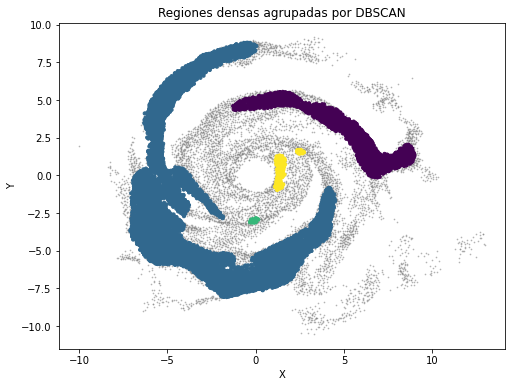

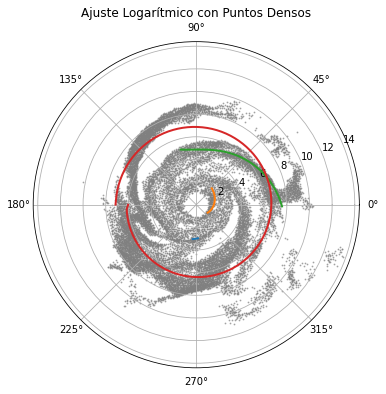

In [31]:
from sklearn.neighbors import KernelDensity
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN

# Configuración de KDE para encontrar densidad máxima en los puntos
def estimate_density(x, y):
    xy = np.vstack([x, y]).T
    kde = KernelDensity(bandwidth=0.5)
    kde.fit(xy)
    return kde.score_samples(xy), kde

# Encontrar los puntos más densos
log_density, kde = estimate_density(x, y)
dense_indices = log_density > np.percentile(log_density, 40)  # Filtramos los puntos más densos

# Agrupamiento de regiones densas usando DBSCAN
dbscan = DBSCAN(eps=1.5, min_samples=5)
labels = dbscan.fit_predict(np.vstack([x[dense_indices], y[dense_indices]]).T)

# Crear un gráfico para visualizar las regiones densas agrupadas
plt.figure(figsize=(8, 6))
plt.scatter(x, y, c='gray', s=0.5, alpha=0.5)
plt.scatter(x[dense_indices], y[dense_indices], c=labels, cmap='viridis', s=10)
plt.title('Regiones densas agrupadas por DBSCAN')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

# Extraer los puntos de los dos grupos más densos
cluster_labels, counts = np.unique(labels, return_counts=True)
top_clusters = cluster_labels[np.argsort(counts)[-5:]]  # Selecciona los dos clusters más grandes

# Ajustar nuevamente los brazos espirales con los puntos de las regiones más densas
arm_adjustments, adjustment_info = {}, []
for cluster in top_clusters:
    indices = np.where(labels == cluster)[0]
    r_group, phi_group = cartesian_to_polar(x[dense_indices][indices], y[dense_indices][indices])

    # Repetimos el ajuste usando los puntos de cada cluster denso
    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)

    phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

    adjustment_info.append({
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r_min': np.min(r_group), 'r_max': np.max(r_group),
    })

# Graficar el ajuste con los puntos más densos
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
for adjustment in adjustment_info:
    phi_fit = adjustment['phi_fit']
    r_fit = adjustment['r_fit']
    ax_global.plot(phi_fit, r_fit, label=f'Ajuste Denso', linewidth=2)

ax_global.scatter(phi_values_s, r_values_s, s=0.7, alpha=0.6, c='gray')
ax_global.set_title('Ajuste Logarítmico con Puntos Densos')
plt.show()


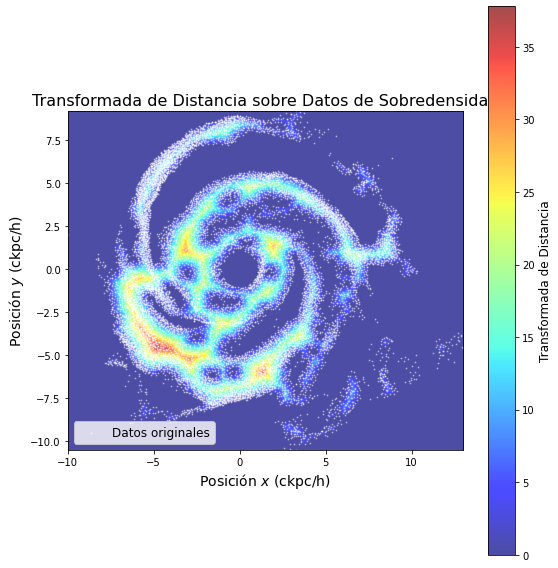

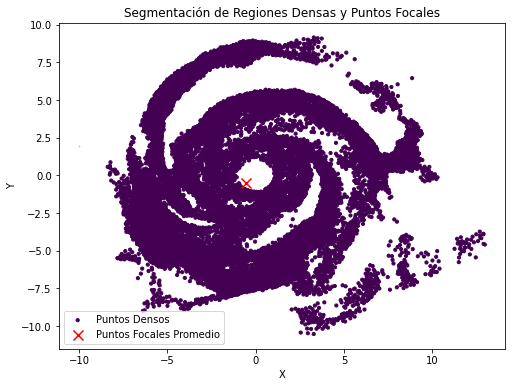

Puntos focales almacenados: {'focal_x': (-0.5335253791320779,), 'focal_y': (-0.5049080745849543,)}


In [35]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from sklearn.cluster import DBSCAN

# Datos de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Crear imagen en blanco para la transformada de distancia
img_size = 512 
img = np.zeros((img_size, img_size), dtype=np.uint8)

# Escalar las coordenadas x, y al tamaño de la imagen
x_scaled = np.interp(x, (x.min(), x.max()), (0, img_size - 1)).astype(np.int32)
y_scaled = np.interp(y, (y.min(), y.max()), (0, img_size - 1)).astype(np.int32)
delta_rho_scaled = np.interp(delta_rho, (delta_rho.min(), delta_rho.max()), (0, 255)).astype(np.uint8)

# Dibujar los puntos en la imagen
for xi, yi, di in zip(x_scaled, y_scaled, delta_rho_scaled):
    img[yi, xi] = di  # Nota: en imágenes, el eje y es la primera dimensión

# Umbralización de la imagen para eliminar ruido
_, thresh = cv2.threshold(img, 1, 255, cv2.THRESH_BINARY)
kernel = np.ones((3, 3), np.uint8)
thresh_closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=3)
thresh_opened = cv2.morphologyEx(thresh_closed, cv2.MORPH_OPEN, kernel, iterations=2)

# Calcular la transformada de distancia
dist_transform = cv2.distanceTransform(thresh_opened, cv2.DIST_L2, 5)
dist_transform_flipped = np.flipud(dist_transform)

# Graficar la transformada de distancia junto con los puntos originales
fig, ax = plt.subplots(figsize=(8, 8))
im = ax.imshow(dist_transform_flipped, cmap='jet', extent=[x.min(), x.max(), y.min(), y.max()], alpha=0.7)
scatter = ax.scatter(x, y, c='white', s=1, alpha=0.36, label='Datos originales')

# Configuración de los ejes
ax.set_title('Transformada de Distancia sobre Datos de Sobredensidad', fontsize=16)
ax.set_xlabel('Posición $x$ (ckpc/h)', fontsize=14)
ax.set_ylabel('Posición $y$ (ckpc/h)', fontsize=14)
ax.legend(loc='best', fontsize=12)
cbar = fig.colorbar(im, ax=ax)
cbar.set_label('Transformada de Distancia', fontsize=12)
plt.tight_layout()
plt.show()

# --------------------------
# Ahora, realizar la segmentación de las regiones densas con DBSCAN
# --------------------------

def estimate_density_focal_points(x, y, min_samples=10):
    xy = np.vstack([x, y]).T
    dbscan = DBSCAN(eps=1.5, min_samples=min_samples)
    labels = dbscan.fit_predict(xy)
    return labels

def calculate_focal_points(x, y, labels):
    focal_points = []
    unique_labels = np.unique(labels)
    for label in unique_labels:
        if label == -1:  # -1 es ruido en DBSCAN
            continue
        indices = np.where(labels == label)
        x_mean = np.mean(x[indices])
        y_mean = np.mean(y[indices])
        focal_points.append((x_mean, y_mean))
    return focal_points

# Usar DBSCAN para encontrar las regiones más densas
labels = estimate_density_focal_points(x, y)

# Calcular los puntos focales
focal_points = calculate_focal_points(x, y, labels)

# Graficar los puntos densos y los puntos focales
plt.figure(figsize=(8, 6))
plt.scatter(x, y, c='gray', s=0.5, alpha=0.5)
plt.scatter(x[labels != -1], y[labels != -1], c=labels[labels != -1], cmap='viridis', s=10, label="Puntos Densos")

# Graficar los puntos focales
focal_x, focal_y = zip(*focal_points)
plt.scatter(focal_x, focal_y, c='red', s=100, marker='x', label="Puntos Focales Promedio")
plt.legend()
plt.title('Segmentación de Regiones Densas y Puntos Focales')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

# --------------------------
# Guardar los puntos focales para su uso en el ajuste de brazos espirales
# --------------------------

focal_points_dict = {'focal_x': focal_x, 'focal_y': focal_y}
print(f"Puntos focales almacenados: {focal_points_dict}")

# --------------------------
# Uso de los puntos focales para ajustar los brazos espirales
# --------------------------

# Aquí es donde integraríamos el ajuste de los brazos espirales con los puntos focales
# Se puede iterar sobre los puntos focales y realizar un ajuste bayesiano para los brazos espirales.


